# 人脸生成（Face Generation）
在该项目中，你将使用生成式对抗网络（Generative Adversarial Nets）来生成新的人脸图像。
### 获取数据
该项目将使用以下数据集：
- MNIST
- CelebA

由于 CelebA 数据集比较复杂，而且这是你第一次使用 GANs。我们想让你先在 MNIST 数据集上测试你的 GANs 模型，以让你更快的评估所建立模型的性能。

如果你在使用 [FloydHub](https://www.floydhub.com/), 请将 `data_dir` 设置为 "/input" 并使用 [FloydHub data ID](http://docs.floydhub.com/home/using_datasets/) "R5KrjnANiKVhLWAkpXhNBe".

In [1]:
data_dir = './data'

# FloydHub - Use with data ID "R5KrjnANiKVhLWAkpXhNBe"
#data_dir = '/input'


"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import helper

helper.download_extract('mnist', data_dir)
helper.download_extract('celeba', data_dir)

Found mnist Data
Found celeba Data


## 探索数据（Explore the Data）
### MNIST
[MNIST](http://yann.lecun.com/exdb/mnist/) 是一个手写数字的图像数据集。你可以更改 `show_n_images` 探索此数据集。

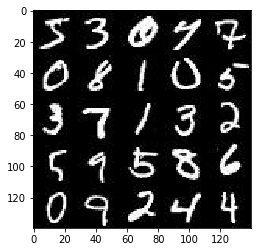

In [2]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
%matplotlib inline
import os
from glob import glob
from matplotlib import pyplot

mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'mnist/*.jpg'))[:show_n_images], 28, 28, 'L')
pyplot.imshow(helper.images_square_grid(mnist_images, 'L'), cmap='gray')

### CelebA
[CelebFaces Attributes Dataset (CelebA)](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html) 是一个包含 20 多万张名人图片及相关图片说明的数据集。你将用此数据集生成人脸，不会用不到相关说明。你可以更改 `show_n_images` 探索此数据集。

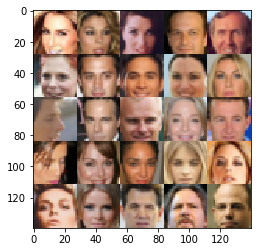

In [3]:
show_n_images = 25

"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
mnist_images = helper.get_batch(glob(os.path.join(data_dir, 'img_align_celeba/*.jpg'))[:show_n_images], 28, 28, 'RGB')
pyplot.imshow(helper.images_square_grid(mnist_images, 'RGB'))

## 预处理数据（Preprocess the Data）
由于该项目的重点是建立 GANs 模型，我们将为你预处理数据。

经过数据预处理，MNIST 和 CelebA 数据集的值在 28×28 维度图像的 [-0.5, 0.5] 范围内。CelebA 数据集中的图像裁剪了非脸部的图像部分，然后调整到 28x28 维度。

MNIST 数据集中的图像是单[通道](https://en.wikipedia.org/wiki/Channel_(digital_image%29)的黑白图像，CelebA 数据集中的图像是 [三通道的 RGB 彩色图像](https://en.wikipedia.org/wiki/Channel_(digital_image%29#RGB_Images)。

## 建立神经网络（Build the Neural Network）
你将通过部署以下函数来建立 GANs 的主要组成部分:
- `model_inputs`
- `discriminator`
- `generator`
- `model_loss`
- `model_opt`
- `train`

### 检查 TensorFlow 版本并获取 GPU 型号
检查你是否使用正确的 TensorFlow 版本，并获取 GPU 型号

In [4]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
from distutils.version import LooseVersion
import warnings
import tensorflow as tf

# Check TensorFlow Version
assert LooseVersion(tf.__version__) >= LooseVersion('1.0'), 'Please use TensorFlow version 1.0 or newer.  You are using {}'.format(tf.__version__)
print('TensorFlow Version: {}'.format(tf.__version__))

# Check for a GPU
if not tf.test.gpu_device_name():
    warnings.warn('No GPU found. Please use a GPU to train your neural network.')
else:
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))

TensorFlow Version: 1.0.1
Default GPU Device: /gpu:0


### 输入（Input）
部署 `model_inputs` 函数以创建用于神经网络的 [占位符 (TF Placeholders)](https://www.tensorflow.org/versions/r0.11/api_docs/python/io_ops/placeholders)。请创建以下占位符：
- 输入图像占位符: 使用 `image_width`，`image_height` 和 `image_channels` 设置为 rank 4。
- 输入 Z 占位符: 设置为 rank 2，并命名为 `z_dim`。
- 学习速率占位符: 设置为 rank 0。

返回占位符元组的形状为 (tensor of real input images, tensor of z data, learning rate)。


In [5]:
import problem_unittests as tests

def model_inputs(image_width, image_height, image_channels, z_dim):
    """
    Create the model inputs
    :param image_width: The input image width
    :param image_height: The input image height
    :param image_channels: The number of image channels
    :param z_dim: The dimension of Z
    :return: Tuple of (tensor of real input images, tensor of z data, learning rate)
    """
    # TODO: Implement Function
    input_real = tf.placeholder(tf.float32, [None, image_width, image_height, image_channels], name='input_real')
    input_z = tf.placeholder(tf.float32, [None, z_dim], name='input_z')
    learning_rate = tf.placeholder(tf.float32)

    return input_real, input_z, learning_rate


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_inputs(model_inputs)

Tests Passed


### 辨别器（Discriminator）
部署 `discriminator` 函数创建辨别器神经网络以辨别 `images`。该函数应能够重复使用神经网络中的各种变量。 在 [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) 中使用 "discriminator" 的变量空间名来重复使用该函数中的变量。 

该函数应返回形如 (tensor output of the discriminator, tensor logits of the discriminator) 的元组。

In [6]:
def discriminator(images, reuse=False, alpha=0.2):
    """
    Create the discriminator network
    :param image: Tensor of input image(s)
    :param reuse: Boolean if the weights should be reused
    :return: Tuple of (tensor output of the discriminator, tensor logits of the discriminator)
    """
    # TODO: Implement Function
    with tf.variable_scope('discriminator', reuse=reuse):
        x1 = tf.layers.conv2d(images, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        # 14x14x64 now
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        # 7x7x128 now
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        # 4x4x256 now
        
        flat = tf.reshape(x3, [-1, 4*4*256])
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)

    return out, logits


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_discriminator(discriminator, tf)

Tests Passed


### 生成器（Generator）
部署 `generator` 函数以使用 `z` 生成图像。该函数应能够重复使用神经网络中的各种变量。
在 [`tf.variable_scope`](https://www.tensorflow.org/api_docs/python/tf/variable_scope) 中使用 "generator" 的变量空间名来重复使用该函数中的变量。 

该函数应返回所生成的 28 x 28 x `out_channel_dim` 维度图像。

In [7]:
def generator(z, out_channel_dim, is_train=True, alpha=0.2):
    """
    Create the generator network
    :param z: Input z
    :param out_channel_dim: The number of channels in the output image
    :param is_train: Boolean if generator is being used for training
    :return: The tensor output of the generator
    """
    # TODO: Implement Function
    with tf.variable_scope('generator', reuse=not is_train):
        x1 = tf.layers.dense(z, 4*4*512)
        x1 = tf.reshape(x1, [-1, 4, 4, 512])
        x1 = tf.layers.batch_normalization(x1, training=is_train)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 4, strides=1, padding='valid')
        x2 = tf.layers.batch_normalization(x2, training=is_train)
        x2 = tf.maximum(alpha * x2, x2)
        # 7x7x256 now
        # out_height = in_height * stride + filter_height - 1
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=is_train)
        x3 = tf.maximum(alpha * x3, x3)
        # 14x14x128 now
        
        logits = tf.layers.conv2d_transpose(x3, out_channel_dim, 5, strides=2, padding='same')
        # 28x28xout_channel_dim now
        out = tf.tanh(logits)
    
    return out


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_generator(generator, tf)

Tests Passed


### 损失函数（Loss）
部署 `model_loss` 函数训练并计算 GANs 的损失。该函数应返回形如 (discriminator loss, generator loss) 的元组。

使用你已实现的函数：
- `discriminator(images, reuse=False)`
- `generator(z, out_channel_dim, is_train=True)`

In [8]:
def model_loss(input_real, input_z, out_channel_dim):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    # TODO: Implement Function
    g_model = generator(input_z, out_channel_dim)
    d_model_real, d_logits_real = discriminator(input_real)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True)
    
    g_loss = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                   labels=tf.ones_like(d_model_fake)))
    d_loss_real = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real,
                                                                         labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake,
                                                                         labels=tf.zeros_like(d_model_fake)))
    d_loss = d_loss_real + d_loss_fake
    
    return d_loss, g_loss


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_loss(model_loss)

Tests Passed


### 优化（Optimization）
部署 `model_opt` 函数实现对 GANs 的优化。使用 [`tf.trainable_variables`](https://www.tensorflow.org/api_docs/python/tf/trainable_variables) 获取可训练的所有变量。通过变量空间名 `discriminator` 和 `generator` 来过滤变量。该函数应返回形如 (discriminator training operation, generator training operation) 的元组。

In [9]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # TODO: Implement Function
    t_vars = tf.trainable_variables()
    g_vars = [var for var in t_vars if var.name.startswith('generator')]
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
    
    return d_train_opt, g_train_opt


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
tests.test_model_opt(model_opt, tf)

Tests Passed


## 训练神经网络（Neural Network Training）
### 输出显示
使用该函数可以显示生成器 (Generator) 在训练过程中的当前输出，这会帮你评估 GANs 模型的训练程度。

In [10]:
"""
DON'T MODIFY ANYTHING IN THIS CELL
"""
import numpy as np

def show_generator_output(sess, n_images, input_z, out_channel_dim, image_mode):
    """
    Show example output for the generator
    :param sess: TensorFlow session
    :param n_images: Number of Images to display
    :param input_z: Input Z Tensor
    :param out_channel_dim: The number of channels in the output image
    :param image_mode: The mode to use for images ("RGB" or "L")
    """
    cmap = None if image_mode == 'RGB' else 'gray'
    z_dim = input_z.get_shape().as_list()[-1]
    example_z = np.random.uniform(-1, 1, size=[n_images, z_dim])

    samples = sess.run(
        generator(input_z, out_channel_dim, False),
        feed_dict={input_z: example_z})

    images_grid = helper.images_square_grid(samples, image_mode)
    pyplot.imshow(images_grid, cmap=cmap)
    pyplot.show()

### 训练
部署 `train` 函数以建立并训练 GANs 模型。记得使用以下你已完成的函数：
- `model_inputs(image_width, image_height, image_channels, z_dim)`
- `model_loss(input_real, input_z, out_channel_dim)`
- `model_opt(d_loss, g_loss, learning_rate, beta1)`

使用 `show_generator_output` 函数显示 `generator` 在训练过程中的输出。

**注意**：在每个批次 (batch) 中运行 `show_generator_output` 函数会显著增加训练时间与该 notebook 的体积。推荐每 100 批次输出一次 `generator` 的输出。 

In [11]:
def train(epoch_count, batch_size, z_dim, learning_rate, beta1, get_batches, data_shape, data_image_mode):
    """
    Train the GAN
    :param epoch_count: Number of epochs
    :param batch_size: Batch Size
    :param z_dim: Z dimension
    :param learning_rate: Learning Rate
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :param get_batches: Function to get batches
    :param data_shape: Shape of the data
    :param data_image_mode: The image mode to use for images ("RGB" or "L")
    """
    # TODO: Build Model
    input_real, input_z, lr = model_inputs(data_shape[1], data_shape[2], data_shape[3], z_dim)
    d_loss, g_loss = model_loss(input_real, input_z, len(data_image_mode))
    d_opt, g_opt = model_opt(d_loss, g_loss, lr, beta1)
    
    sample_z = np.random.uniform(-1, 1, size=(72, z_dim))
    steps = 0
    
    session_cfg = tf.ConfigProto()
    session_cfg.gpu_options.allow_growth = True
    with tf.Session(config=session_cfg) as sess:
        sess.run(tf.global_variables_initializer())
        for epoch_i in range(epoch_count):
            for batch_images in get_batches(batch_size):
                steps += 1 
                
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_dim))
                
                _ = sess.run(d_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                _ = sess.run(g_opt, feed_dict={input_real: batch_images, input_z: batch_z, lr: learning_rate})
                
                if steps % 10 == 0:
                    train_loss_d = sess.run(d_loss, feed_dict={input_real: batch_images, input_z: batch_z})
                    train_loss_g = sess.run(g_loss, feed_dict={input_z: batch_z})
                    
                    print('Epoch: {}/{}'.format(epoch_i+1, epoch_count),
                          'Discriminator Loss: {:.4f}'.format(train_loss_d),
                          'Generator Loss: {:.4f}'.format(train_loss_g))
                    
                if steps % 100 == 0:
                    show_generator_output(sess, len(batch_images), input_z, len(data_image_mode), data_image_mode)
                
                

### MNIST
在 MNIST 上测试你的 GANs 模型。经过 2 次迭代，GANs 应该能够生成类似手写数字的图像。确保生成器 (generator) 低于辨别器 (discriminator) 的损失，或接近 0。

Epoch: 1/8 Discriminator Loss: 0.7712 Generator Loss: 0.7863
Epoch: 1/8 Discriminator Loss: 0.4069 Generator Loss: 1.1708
Epoch: 1/8 Discriminator Loss: 0.0711 Generator Loss: 4.5702
Epoch: 1/8 Discriminator Loss: 0.1849 Generator Loss: 2.5178
Epoch: 1/8 Discriminator Loss: 0.2148 Generator Loss: 6.4486
Epoch: 1/8 Discriminator Loss: 1.2364 Generator Loss: 8.8684
Epoch: 1/8 Discriminator Loss: 0.7998 Generator Loss: 6.4957
Epoch: 1/8 Discriminator Loss: 0.2746 Generator Loss: 2.6754
Epoch: 1/8 Discriminator Loss: 0.1945 Generator Loss: 2.5745
Epoch: 1/8 Discriminator Loss: 0.5270 Generator Loss: 2.9053


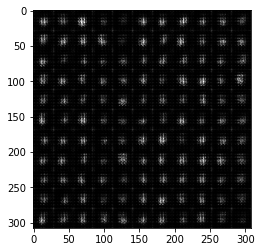

Epoch: 1/8 Discriminator Loss: 0.1698 Generator Loss: 2.5472
Epoch: 1/8 Discriminator Loss: 0.3894 Generator Loss: 3.7007
Epoch: 1/8 Discriminator Loss: 0.1735 Generator Loss: 2.9745
Epoch: 1/8 Discriminator Loss: 0.1465 Generator Loss: 3.2396
Epoch: 1/8 Discriminator Loss: 0.4751 Generator Loss: 1.3257
Epoch: 1/8 Discriminator Loss: 0.4284 Generator Loss: 1.6698
Epoch: 1/8 Discriminator Loss: 0.1914 Generator Loss: 2.5242
Epoch: 1/8 Discriminator Loss: 0.2582 Generator Loss: 2.9337
Epoch: 1/8 Discriminator Loss: 0.1468 Generator Loss: 3.1154
Epoch: 1/8 Discriminator Loss: 0.1835 Generator Loss: 2.8811


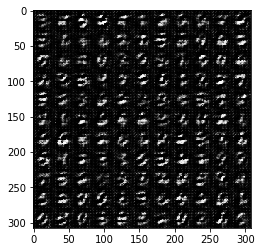

Epoch: 1/8 Discriminator Loss: 0.4644 Generator Loss: 9.2538
Epoch: 1/8 Discriminator Loss: 0.2858 Generator Loss: 1.9509
Epoch: 1/8 Discriminator Loss: 0.1079 Generator Loss: 3.1445
Epoch: 1/8 Discriminator Loss: 0.0765 Generator Loss: 4.0934
Epoch: 1/8 Discriminator Loss: 0.1533 Generator Loss: 4.0927
Epoch: 1/8 Discriminator Loss: 0.0717 Generator Loss: 3.2260
Epoch: 1/8 Discriminator Loss: 0.0928 Generator Loss: 3.0014
Epoch: 1/8 Discriminator Loss: 0.0665 Generator Loss: 3.3072
Epoch: 1/8 Discriminator Loss: 0.3286 Generator Loss: 1.9996
Epoch: 1/8 Discriminator Loss: 0.7988 Generator Loss: 0.8227


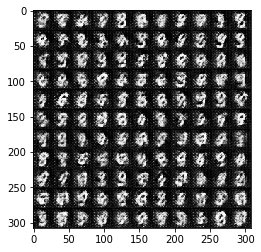

Epoch: 1/8 Discriminator Loss: 0.1500 Generator Loss: 2.6491
Epoch: 1/8 Discriminator Loss: 0.2201 Generator Loss: 1.9240
Epoch: 1/8 Discriminator Loss: 0.3488 Generator Loss: 7.9374
Epoch: 1/8 Discriminator Loss: 2.4221 Generator Loss: 0.1384
Epoch: 1/8 Discriminator Loss: 0.6282 Generator Loss: 1.1805
Epoch: 1/8 Discriminator Loss: 0.3036 Generator Loss: 3.3867
Epoch: 1/8 Discriminator Loss: 0.7367 Generator Loss: 9.7104
Epoch: 1/8 Discriminator Loss: 0.4354 Generator Loss: 1.5168
Epoch: 1/8 Discriminator Loss: 0.3734 Generator Loss: 2.0182
Epoch: 1/8 Discriminator Loss: 0.7051 Generator Loss: 0.9198


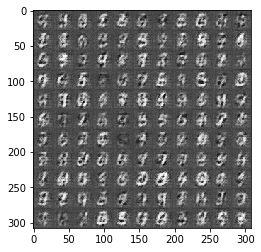

Epoch: 1/8 Discriminator Loss: 1.0699 Generator Loss: 4.9418
Epoch: 1/8 Discriminator Loss: 0.3169 Generator Loss: 1.9286
Epoch: 1/8 Discriminator Loss: 0.4663 Generator Loss: 4.3197
Epoch: 1/8 Discriminator Loss: 0.2018 Generator Loss: 2.4555
Epoch: 1/8 Discriminator Loss: 0.3863 Generator Loss: 3.6739
Epoch: 1/8 Discriminator Loss: 0.2221 Generator Loss: 3.3437
Epoch: 2/8 Discriminator Loss: 0.3249 Generator Loss: 1.7455
Epoch: 2/8 Discriminator Loss: 0.1861 Generator Loss: 2.4934
Epoch: 2/8 Discriminator Loss: 0.1809 Generator Loss: 2.8970
Epoch: 2/8 Discriminator Loss: 0.2665 Generator Loss: 1.9064


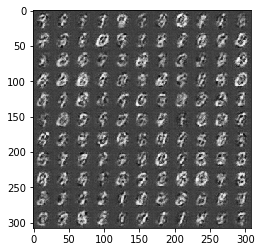

Epoch: 2/8 Discriminator Loss: 0.1815 Generator Loss: 2.3499
Epoch: 2/8 Discriminator Loss: 0.2347 Generator Loss: 2.5085
Epoch: 2/8 Discriminator Loss: 0.2169 Generator Loss: 2.5029
Epoch: 2/8 Discriminator Loss: 0.4537 Generator Loss: 1.2533
Epoch: 2/8 Discriminator Loss: 0.2197 Generator Loss: 2.5612
Epoch: 2/8 Discriminator Loss: 0.2753 Generator Loss: 1.8224
Epoch: 2/8 Discriminator Loss: 0.1406 Generator Loss: 2.4263
Epoch: 2/8 Discriminator Loss: 0.3106 Generator Loss: 3.2685
Epoch: 2/8 Discriminator Loss: 0.3721 Generator Loss: 1.6250
Epoch: 2/8 Discriminator Loss: 0.2670 Generator Loss: 2.0194


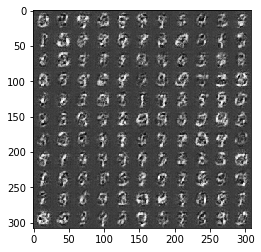

Epoch: 2/8 Discriminator Loss: 0.2011 Generator Loss: 2.5147
Epoch: 2/8 Discriminator Loss: 0.1671 Generator Loss: 2.5787
Epoch: 2/8 Discriminator Loss: 0.2415 Generator Loss: 1.9422
Epoch: 2/8 Discriminator Loss: 0.2056 Generator Loss: 1.9763
Epoch: 2/8 Discriminator Loss: 0.1599 Generator Loss: 2.3728
Epoch: 2/8 Discriminator Loss: 0.2252 Generator Loss: 2.0031
Epoch: 2/8 Discriminator Loss: 0.3848 Generator Loss: 2.3955
Epoch: 2/8 Discriminator Loss: 0.2422 Generator Loss: 2.1003
Epoch: 2/8 Discriminator Loss: 0.1250 Generator Loss: 3.0012
Epoch: 2/8 Discriminator Loss: 0.3126 Generator Loss: 1.7205


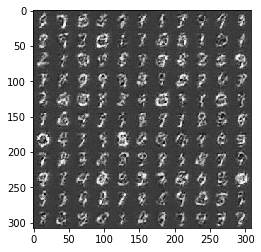

Epoch: 2/8 Discriminator Loss: 0.1636 Generator Loss: 2.5692
Epoch: 2/8 Discriminator Loss: 0.1239 Generator Loss: 2.8038
Epoch: 2/8 Discriminator Loss: 0.1490 Generator Loss: 2.3720
Epoch: 2/8 Discriminator Loss: 0.1286 Generator Loss: 2.8222
Epoch: 2/8 Discriminator Loss: 0.0975 Generator Loss: 2.9526
Epoch: 2/8 Discriminator Loss: 0.1351 Generator Loss: 2.4623
Epoch: 2/8 Discriminator Loss: 0.0736 Generator Loss: 3.6906
Epoch: 2/8 Discriminator Loss: 0.1730 Generator Loss: 2.2617
Epoch: 2/8 Discriminator Loss: 0.1252 Generator Loss: 2.6568
Epoch: 2/8 Discriminator Loss: 7.3037 Generator Loss: 12.8793


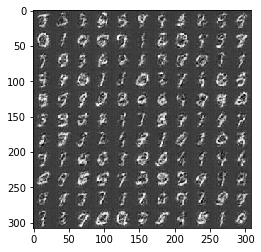

Epoch: 2/8 Discriminator Loss: 0.4189 Generator Loss: 1.6662
Epoch: 2/8 Discriminator Loss: 0.2973 Generator Loss: 2.4840
Epoch: 2/8 Discriminator Loss: 0.2822 Generator Loss: 1.7752
Epoch: 2/8 Discriminator Loss: 0.2765 Generator Loss: 1.7657
Epoch: 2/8 Discriminator Loss: 0.2280 Generator Loss: 2.0486
Epoch: 2/8 Discriminator Loss: 0.1734 Generator Loss: 2.6795
Epoch: 2/8 Discriminator Loss: 0.1960 Generator Loss: 2.2319
Epoch: 2/8 Discriminator Loss: 0.0955 Generator Loss: 3.2155
Epoch: 2/8 Discriminator Loss: 0.1202 Generator Loss: 2.6609
Epoch: 2/8 Discriminator Loss: 0.0937 Generator Loss: 3.2764


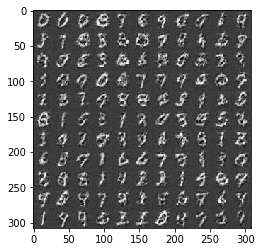

Epoch: 2/8 Discriminator Loss: 0.2549 Generator Loss: 1.8805
Epoch: 2/8 Discriminator Loss: 0.2127 Generator Loss: 2.0073
Epoch: 2/8 Discriminator Loss: 0.2184 Generator Loss: 1.9449
Epoch: 3/8 Discriminator Loss: 0.0924 Generator Loss: 3.3391
Epoch: 3/8 Discriminator Loss: 0.1000 Generator Loss: 2.8161
Epoch: 3/8 Discriminator Loss: 0.7942 Generator Loss: 1.0075
Epoch: 3/8 Discriminator Loss: 0.3738 Generator Loss: 1.7844
Epoch: 3/8 Discriminator Loss: 0.3620 Generator Loss: 1.5093
Epoch: 3/8 Discriminator Loss: 0.2496 Generator Loss: 2.1117
Epoch: 3/8 Discriminator Loss: 0.0825 Generator Loss: 3.4082


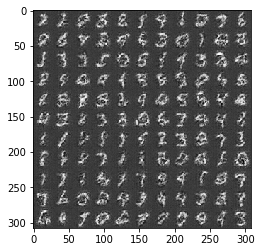

Epoch: 3/8 Discriminator Loss: 0.1124 Generator Loss: 2.9593
Epoch: 3/8 Discriminator Loss: 0.1755 Generator Loss: 2.2405
Epoch: 3/8 Discriminator Loss: 0.1157 Generator Loss: 2.6316
Epoch: 3/8 Discriminator Loss: 0.0838 Generator Loss: 3.0384
Epoch: 3/8 Discriminator Loss: 0.1297 Generator Loss: 2.6355
Epoch: 3/8 Discriminator Loss: 0.1471 Generator Loss: 2.5642
Epoch: 3/8 Discriminator Loss: 0.1149 Generator Loss: 2.9541
Epoch: 3/8 Discriminator Loss: 0.0771 Generator Loss: 3.1174
Epoch: 3/8 Discriminator Loss: 0.0392 Generator Loss: 5.0986
Epoch: 3/8 Discriminator Loss: 0.0816 Generator Loss: 3.0632


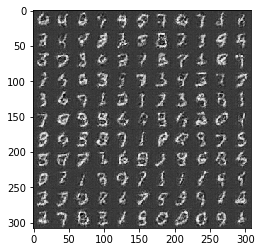

Epoch: 3/8 Discriminator Loss: 0.0731 Generator Loss: 3.6263
Epoch: 3/8 Discriminator Loss: 0.0781 Generator Loss: 2.9600
Epoch: 3/8 Discriminator Loss: 0.0707 Generator Loss: 3.7216
Epoch: 3/8 Discriminator Loss: 0.0476 Generator Loss: 3.9488
Epoch: 3/8 Discriminator Loss: 0.0676 Generator Loss: 3.5499
Epoch: 3/8 Discriminator Loss: 0.0793 Generator Loss: 3.1690
Epoch: 3/8 Discriminator Loss: 0.1413 Generator Loss: 2.4131
Epoch: 3/8 Discriminator Loss: 0.0550 Generator Loss: 3.7610
Epoch: 3/8 Discriminator Loss: 0.0576 Generator Loss: 3.8407
Epoch: 3/8 Discriminator Loss: 0.0792 Generator Loss: 3.1888


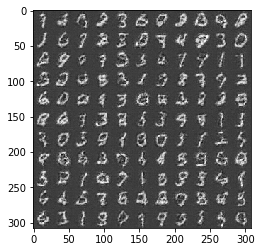

Epoch: 3/8 Discriminator Loss: 0.2161 Generator Loss: 5.4146
Epoch: 3/8 Discriminator Loss: 0.5378 Generator Loss: 2.1809
Epoch: 3/8 Discriminator Loss: 0.3044 Generator Loss: 2.1206
Epoch: 3/8 Discriminator Loss: 0.2906 Generator Loss: 1.7899
Epoch: 3/8 Discriminator Loss: 0.1662 Generator Loss: 3.0485
Epoch: 3/8 Discriminator Loss: 0.1663 Generator Loss: 2.5545
Epoch: 3/8 Discriminator Loss: 0.1039 Generator Loss: 3.1535
Epoch: 3/8 Discriminator Loss: 0.1454 Generator Loss: 2.4285
Epoch: 3/8 Discriminator Loss: 0.1619 Generator Loss: 2.5172
Epoch: 3/8 Discriminator Loss: 0.1651 Generator Loss: 2.3941


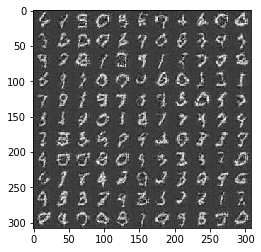

Epoch: 3/8 Discriminator Loss: 0.1219 Generator Loss: 2.6114
Epoch: 3/8 Discriminator Loss: 0.1099 Generator Loss: 2.7198
Epoch: 3/8 Discriminator Loss: 5.1252 Generator Loss: 11.1276
Epoch: 3/8 Discriminator Loss: 0.5880 Generator Loss: 2.6378
Epoch: 3/8 Discriminator Loss: 0.5132 Generator Loss: 1.4886
Epoch: 3/8 Discriminator Loss: 0.3938 Generator Loss: 2.5701
Epoch: 3/8 Discriminator Loss: 0.3159 Generator Loss: 1.7122
Epoch: 3/8 Discriminator Loss: 0.1476 Generator Loss: 2.8475
Epoch: 3/8 Discriminator Loss: 0.1827 Generator Loss: 2.2707
Epoch: 3/8 Discriminator Loss: 0.1270 Generator Loss: 3.3559


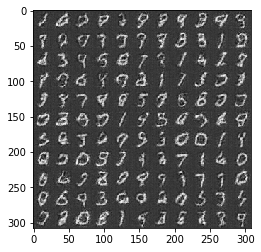

Epoch: 4/8 Discriminator Loss: 0.1033 Generator Loss: 2.9642
Epoch: 4/8 Discriminator Loss: 0.1064 Generator Loss: 3.2326
Epoch: 4/8 Discriminator Loss: 0.2322 Generator Loss: 1.8786
Epoch: 4/8 Discriminator Loss: 0.0834 Generator Loss: 3.1915
Epoch: 4/8 Discriminator Loss: 0.0826 Generator Loss: 2.9772
Epoch: 4/8 Discriminator Loss: 0.0457 Generator Loss: 4.1070
Epoch: 4/8 Discriminator Loss: 0.1887 Generator Loss: 2.0635
Epoch: 4/8 Discriminator Loss: 0.0446 Generator Loss: 4.0551
Epoch: 4/8 Discriminator Loss: 0.1761 Generator Loss: 2.1048
Epoch: 4/8 Discriminator Loss: 0.0489 Generator Loss: 4.2291


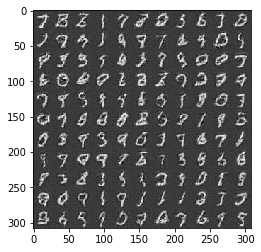

Epoch: 4/8 Discriminator Loss: 0.0619 Generator Loss: 3.3416
Epoch: 4/8 Discriminator Loss: 0.0440 Generator Loss: 4.0849
Epoch: 4/8 Discriminator Loss: 0.0364 Generator Loss: 4.1005
Epoch: 4/8 Discriminator Loss: 0.0737 Generator Loss: 3.3496
Epoch: 4/8 Discriminator Loss: 0.1847 Generator Loss: 2.1077
Epoch: 4/8 Discriminator Loss: 0.1870 Generator Loss: 2.0455
Epoch: 4/8 Discriminator Loss: 2.4712 Generator Loss: 2.9225
Epoch: 4/8 Discriminator Loss: 0.7675 Generator Loss: 1.5127
Epoch: 4/8 Discriminator Loss: 0.9054 Generator Loss: 1.1815
Epoch: 4/8 Discriminator Loss: 0.6639 Generator Loss: 1.2345


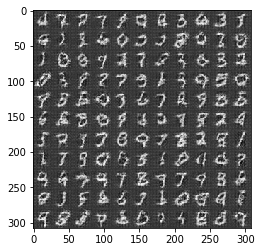

Epoch: 4/8 Discriminator Loss: 1.0326 Generator Loss: 0.6351
Epoch: 4/8 Discriminator Loss: 0.6020 Generator Loss: 1.6880
Epoch: 4/8 Discriminator Loss: 0.3379 Generator Loss: 2.4003
Epoch: 4/8 Discriminator Loss: 0.3568 Generator Loss: 2.2023
Epoch: 4/8 Discriminator Loss: 0.2328 Generator Loss: 2.2144
Epoch: 4/8 Discriminator Loss: 0.3058 Generator Loss: 2.9613
Epoch: 4/8 Discriminator Loss: 0.1021 Generator Loss: 4.3540
Epoch: 4/8 Discriminator Loss: 0.2264 Generator Loss: 2.8754
Epoch: 4/8 Discriminator Loss: 0.2282 Generator Loss: 1.8587
Epoch: 4/8 Discriminator Loss: 0.1003 Generator Loss: 3.0422


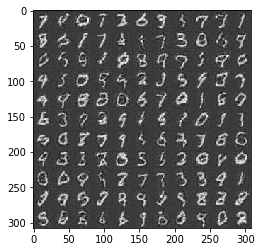

Epoch: 4/8 Discriminator Loss: 0.0803 Generator Loss: 3.8751
Epoch: 4/8 Discriminator Loss: 0.2653 Generator Loss: 1.6982
Epoch: 4/8 Discriminator Loss: 0.0992 Generator Loss: 3.0525
Epoch: 4/8 Discriminator Loss: 0.1137 Generator Loss: 3.1344
Epoch: 4/8 Discriminator Loss: 0.0778 Generator Loss: 3.5370
Epoch: 4/8 Discriminator Loss: 0.0521 Generator Loss: 3.6616
Epoch: 4/8 Discriminator Loss: 0.0511 Generator Loss: 4.3967
Epoch: 4/8 Discriminator Loss: 0.0781 Generator Loss: 3.0828
Epoch: 4/8 Discriminator Loss: 0.1940 Generator Loss: 2.3988
Epoch: 4/8 Discriminator Loss: 0.0734 Generator Loss: 3.2766


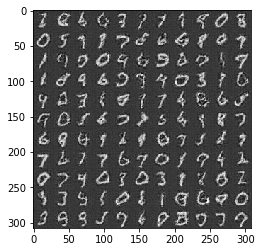

Epoch: 4/8 Discriminator Loss: 0.0646 Generator Loss: 3.6445
Epoch: 4/8 Discriminator Loss: 0.0356 Generator Loss: 6.7353
Epoch: 4/8 Discriminator Loss: 0.0370 Generator Loss: 4.5496
Epoch: 4/8 Discriminator Loss: 0.1425 Generator Loss: 3.0878
Epoch: 4/8 Discriminator Loss: 0.3265 Generator Loss: 1.6131
Epoch: 4/8 Discriminator Loss: 0.1343 Generator Loss: 3.8888
Epoch: 4/8 Discriminator Loss: 0.3558 Generator Loss: 1.4125
Epoch: 5/8 Discriminator Loss: 2.5377 Generator Loss: 3.0773
Epoch: 5/8 Discriminator Loss: 0.9071 Generator Loss: 0.9571
Epoch: 5/8 Discriminator Loss: 0.3539 Generator Loss: 1.9332


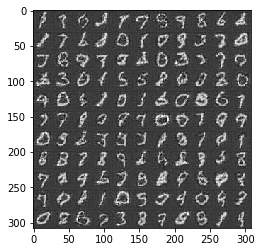

Epoch: 5/8 Discriminator Loss: 0.2704 Generator Loss: 1.9711
Epoch: 5/8 Discriminator Loss: 0.1248 Generator Loss: 2.7161
Epoch: 5/8 Discriminator Loss: 0.2180 Generator Loss: 1.9452
Epoch: 5/8 Discriminator Loss: 0.2122 Generator Loss: 2.0295
Epoch: 5/8 Discriminator Loss: 0.1034 Generator Loss: 3.6775
Epoch: 5/8 Discriminator Loss: 0.0738 Generator Loss: 3.3683
Epoch: 5/8 Discriminator Loss: 0.1092 Generator Loss: 2.6806
Epoch: 5/8 Discriminator Loss: 0.0565 Generator Loss: 3.5227
Epoch: 5/8 Discriminator Loss: 0.0558 Generator Loss: 3.5585
Epoch: 5/8 Discriminator Loss: 0.1851 Generator Loss: 2.2471


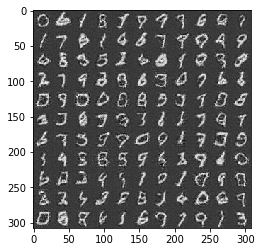

Epoch: 5/8 Discriminator Loss: 0.0301 Generator Loss: 4.4802
Epoch: 5/8 Discriminator Loss: 0.0762 Generator Loss: 3.1034
Epoch: 5/8 Discriminator Loss: 0.0373 Generator Loss: 4.9847
Epoch: 5/8 Discriminator Loss: 0.3055 Generator Loss: 1.5942
Epoch: 5/8 Discriminator Loss: 0.1660 Generator Loss: 2.1854
Epoch: 5/8 Discriminator Loss: 0.0286 Generator Loss: 4.6322
Epoch: 5/8 Discriminator Loss: 2.5155 Generator Loss: 0.1203
Epoch: 5/8 Discriminator Loss: 0.6806 Generator Loss: 1.9049
Epoch: 5/8 Discriminator Loss: 0.5183 Generator Loss: 1.2782
Epoch: 5/8 Discriminator Loss: 0.3558 Generator Loss: 1.9645


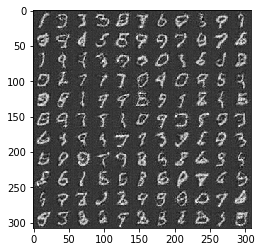

Epoch: 5/8 Discriminator Loss: 0.2865 Generator Loss: 1.7138
Epoch: 5/8 Discriminator Loss: 0.2265 Generator Loss: 1.9567
Epoch: 5/8 Discriminator Loss: 0.1389 Generator Loss: 3.1308
Epoch: 5/8 Discriminator Loss: 0.0942 Generator Loss: 2.9306
Epoch: 5/8 Discriminator Loss: 0.1027 Generator Loss: 3.1666
Epoch: 5/8 Discriminator Loss: 0.1950 Generator Loss: 2.1357
Epoch: 5/8 Discriminator Loss: 0.0357 Generator Loss: 5.0635
Epoch: 5/8 Discriminator Loss: 0.0644 Generator Loss: 3.6252
Epoch: 5/8 Discriminator Loss: 0.0698 Generator Loss: 3.5635
Epoch: 5/8 Discriminator Loss: 0.0426 Generator Loss: 5.2941


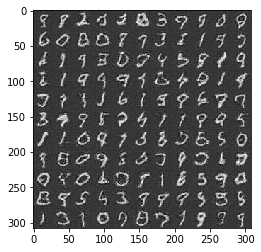

Epoch: 5/8 Discriminator Loss: 0.4638 Generator Loss: 1.2033
Epoch: 5/8 Discriminator Loss: 0.0836 Generator Loss: 3.1872
Epoch: 5/8 Discriminator Loss: 0.0615 Generator Loss: 4.2077
Epoch: 5/8 Discriminator Loss: 0.0361 Generator Loss: 4.5783
Epoch: 5/8 Discriminator Loss: 0.0319 Generator Loss: 5.1739
Epoch: 5/8 Discriminator Loss: 0.0519 Generator Loss: 4.9396
Epoch: 5/8 Discriminator Loss: 0.0397 Generator Loss: 4.1410
Epoch: 5/8 Discriminator Loss: 0.0461 Generator Loss: 3.8958
Epoch: 5/8 Discriminator Loss: 0.2758 Generator Loss: 1.7071
Epoch: 5/8 Discriminator Loss: 0.1250 Generator Loss: 2.4954


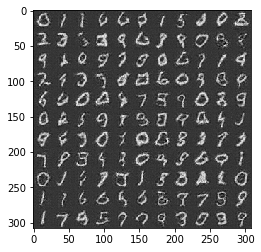

Epoch: 5/8 Discriminator Loss: 0.0641 Generator Loss: 3.3315
Epoch: 5/8 Discriminator Loss: 0.0664 Generator Loss: 3.1721
Epoch: 5/8 Discriminator Loss: 9.6940 Generator Loss: 13.7732
Epoch: 5/8 Discriminator Loss: 0.3137 Generator Loss: 2.2744
Epoch: 6/8 Discriminator Loss: 1.1740 Generator Loss: 2.3733
Epoch: 6/8 Discriminator Loss: 0.5603 Generator Loss: 2.2676
Epoch: 6/8 Discriminator Loss: 0.5263 Generator Loss: 1.2658
Epoch: 6/8 Discriminator Loss: 0.1653 Generator Loss: 2.4080
Epoch: 6/8 Discriminator Loss: 0.1175 Generator Loss: 2.7508
Epoch: 6/8 Discriminator Loss: 0.0988 Generator Loss: 2.7744


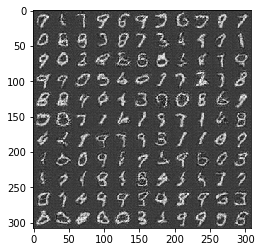

Epoch: 6/8 Discriminator Loss: 0.3451 Generator Loss: 5.2467
Epoch: 6/8 Discriminator Loss: 0.7980 Generator Loss: 2.1925
Epoch: 6/8 Discriminator Loss: 0.6860 Generator Loss: 2.6495
Epoch: 6/8 Discriminator Loss: 0.4705 Generator Loss: 1.8721
Epoch: 6/8 Discriminator Loss: 0.6338 Generator Loss: 3.6503
Epoch: 6/8 Discriminator Loss: 0.2782 Generator Loss: 1.8563
Epoch: 6/8 Discriminator Loss: 0.1691 Generator Loss: 2.9054
Epoch: 6/8 Discriminator Loss: 0.3046 Generator Loss: 1.7637
Epoch: 6/8 Discriminator Loss: 0.0985 Generator Loss: 4.4633
Epoch: 6/8 Discriminator Loss: 0.1827 Generator Loss: 2.2364


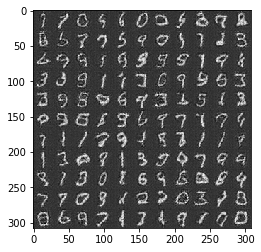

Epoch: 6/8 Discriminator Loss: 0.0672 Generator Loss: 3.6416
Epoch: 6/8 Discriminator Loss: 0.1828 Generator Loss: 2.1327
Epoch: 6/8 Discriminator Loss: 0.0379 Generator Loss: 4.3305
Epoch: 6/8 Discriminator Loss: 0.1017 Generator Loss: 2.8505
Epoch: 6/8 Discriminator Loss: 0.0731 Generator Loss: 3.3902
Epoch: 6/8 Discriminator Loss: 0.0445 Generator Loss: 4.8942
Epoch: 6/8 Discriminator Loss: 0.1009 Generator Loss: 4.8363
Epoch: 6/8 Discriminator Loss: 0.0682 Generator Loss: 4.1855
Epoch: 6/8 Discriminator Loss: 0.0369 Generator Loss: 4.3110
Epoch: 6/8 Discriminator Loss: 0.0518 Generator Loss: 3.4893


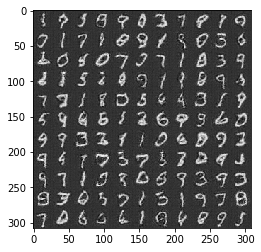

Epoch: 6/8 Discriminator Loss: 0.0226 Generator Loss: 5.7444
Epoch: 6/8 Discriminator Loss: 0.1143 Generator Loss: 2.5385
Epoch: 6/8 Discriminator Loss: 1.5061 Generator Loss: 4.5622
Epoch: 6/8 Discriminator Loss: 0.4162 Generator Loss: 2.1567
Epoch: 6/8 Discriminator Loss: 0.4906 Generator Loss: 1.4502
Epoch: 6/8 Discriminator Loss: 0.3226 Generator Loss: 2.4365
Epoch: 6/8 Discriminator Loss: 2.7400 Generator Loss: 7.8204
Epoch: 6/8 Discriminator Loss: 0.7552 Generator Loss: 1.7971
Epoch: 6/8 Discriminator Loss: 0.4397 Generator Loss: 1.9995
Epoch: 6/8 Discriminator Loss: 0.3310 Generator Loss: 2.1294


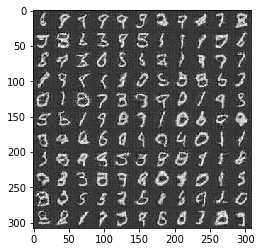

Epoch: 6/8 Discriminator Loss: 0.2118 Generator Loss: 2.6132
Epoch: 6/8 Discriminator Loss: 0.2132 Generator Loss: 2.2763
Epoch: 6/8 Discriminator Loss: 0.2212 Generator Loss: 2.2290
Epoch: 6/8 Discriminator Loss: 0.2070 Generator Loss: 2.0468
Epoch: 6/8 Discriminator Loss: 0.1160 Generator Loss: 2.5663
Epoch: 6/8 Discriminator Loss: 0.2005 Generator Loss: 2.0934
Epoch: 6/8 Discriminator Loss: 0.0509 Generator Loss: 3.8283
Epoch: 6/8 Discriminator Loss: 0.0718 Generator Loss: 3.8183
Epoch: 6/8 Discriminator Loss: 0.1099 Generator Loss: 2.6907
Epoch: 6/8 Discriminator Loss: 0.0449 Generator Loss: 3.8990


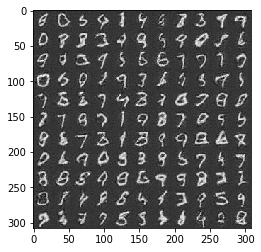

Epoch: 7/8 Discriminator Loss: 0.0669 Generator Loss: 3.4864
Epoch: 7/8 Discriminator Loss: 0.0579 Generator Loss: 5.1591
Epoch: 7/8 Discriminator Loss: 0.1455 Generator Loss: 2.4192
Epoch: 7/8 Discriminator Loss: 0.3641 Generator Loss: 1.4471
Epoch: 7/8 Discriminator Loss: 0.0279 Generator Loss: 4.5549
Epoch: 7/8 Discriminator Loss: 0.0378 Generator Loss: 4.1595
Epoch: 7/8 Discriminator Loss: 0.1005 Generator Loss: 2.7444
Epoch: 7/8 Discriminator Loss: 0.0927 Generator Loss: 2.9346
Epoch: 7/8 Discriminator Loss: 0.0188 Generator Loss: 5.2674
Epoch: 7/8 Discriminator Loss: 0.0675 Generator Loss: 3.4542


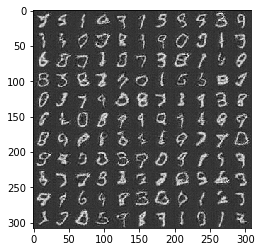

Epoch: 7/8 Discriminator Loss: 0.0470 Generator Loss: 4.1730
Epoch: 7/8 Discriminator Loss: 0.0212 Generator Loss: 5.8643
Epoch: 7/8 Discriminator Loss: 0.0378 Generator Loss: 4.0674
Epoch: 7/8 Discriminator Loss: 0.0223 Generator Loss: 4.8125
Epoch: 7/8 Discriminator Loss: 0.0252 Generator Loss: 7.0782
Epoch: 7/8 Discriminator Loss: 0.0167 Generator Loss: 6.0475
Epoch: 7/8 Discriminator Loss: 0.0675 Generator Loss: 3.1950
Epoch: 7/8 Discriminator Loss: 0.0211 Generator Loss: 5.8353
Epoch: 7/8 Discriminator Loss: 0.0301 Generator Loss: 4.3437
Epoch: 7/8 Discriminator Loss: 0.4332 Generator Loss: 1.3120


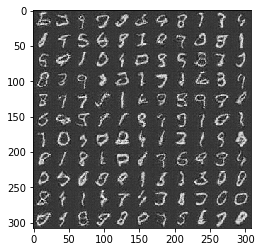

Epoch: 7/8 Discriminator Loss: 1.5239 Generator Loss: 0.3652
Epoch: 7/8 Discriminator Loss: 0.4693 Generator Loss: 1.3620
Epoch: 7/8 Discriminator Loss: 0.3228 Generator Loss: 2.3233
Epoch: 7/8 Discriminator Loss: 0.2465 Generator Loss: 2.7361
Epoch: 7/8 Discriminator Loss: 0.1428 Generator Loss: 2.6866
Epoch: 7/8 Discriminator Loss: 0.0658 Generator Loss: 3.4186
Epoch: 7/8 Discriminator Loss: 0.0766 Generator Loss: 4.2714
Epoch: 7/8 Discriminator Loss: 0.0574 Generator Loss: 3.8069
Epoch: 7/8 Discriminator Loss: 0.0438 Generator Loss: 4.0201
Epoch: 7/8 Discriminator Loss: 0.5683 Generator Loss: 2.5394


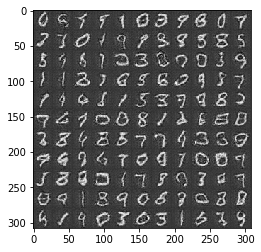

Epoch: 7/8 Discriminator Loss: 0.5898 Generator Loss: 1.6199
Epoch: 7/8 Discriminator Loss: 0.5553 Generator Loss: 1.4919
Epoch: 7/8 Discriminator Loss: 0.6234 Generator Loss: 3.0574
Epoch: 7/8 Discriminator Loss: 0.6391 Generator Loss: 3.1547
Epoch: 7/8 Discriminator Loss: 0.3704 Generator Loss: 1.6866
Epoch: 7/8 Discriminator Loss: 0.3563 Generator Loss: 3.7281
Epoch: 7/8 Discriminator Loss: 0.3111 Generator Loss: 3.3612
Epoch: 7/8 Discriminator Loss: 0.2469 Generator Loss: 2.0627
Epoch: 7/8 Discriminator Loss: 0.3160 Generator Loss: 1.6693
Epoch: 7/8 Discriminator Loss: 0.2662 Generator Loss: 1.8953


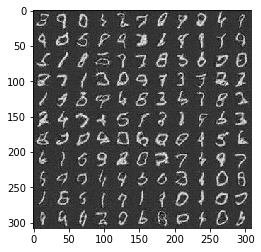

Epoch: 7/8 Discriminator Loss: 0.1697 Generator Loss: 2.4375
Epoch: 7/8 Discriminator Loss: 0.1138 Generator Loss: 3.0112
Epoch: 7/8 Discriminator Loss: 0.1004 Generator Loss: 3.6379
Epoch: 7/8 Discriminator Loss: 0.4225 Generator Loss: 1.5057
Epoch: 7/8 Discriminator Loss: 0.1661 Generator Loss: 2.2972
Epoch: 7/8 Discriminator Loss: 0.0417 Generator Loss: 4.3201
Epoch: 7/8 Discriminator Loss: 0.0897 Generator Loss: 2.9580
Epoch: 8/8 Discriminator Loss: 0.0890 Generator Loss: 2.9551
Epoch: 8/8 Discriminator Loss: 0.0464 Generator Loss: 3.9486
Epoch: 8/8 Discriminator Loss: 0.0595 Generator Loss: 4.4200


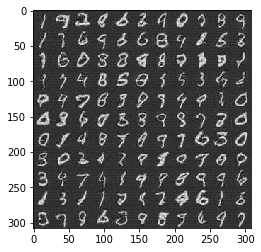

Epoch: 8/8 Discriminator Loss: 2.1883 Generator Loss: 2.4162
Epoch: 8/8 Discriminator Loss: 0.9711 Generator Loss: 0.9065
Epoch: 8/8 Discriminator Loss: 0.9413 Generator Loss: 0.8034
Epoch: 8/8 Discriminator Loss: 0.6612 Generator Loss: 1.4857
Epoch: 8/8 Discriminator Loss: 0.8628 Generator Loss: 2.5449
Epoch: 8/8 Discriminator Loss: 0.5180 Generator Loss: 2.1784
Epoch: 8/8 Discriminator Loss: 0.4924 Generator Loss: 1.4932
Epoch: 8/8 Discriminator Loss: 0.2937 Generator Loss: 1.7748
Epoch: 8/8 Discriminator Loss: 0.5958 Generator Loss: 1.3004
Epoch: 8/8 Discriminator Loss: 0.3303 Generator Loss: 1.9369


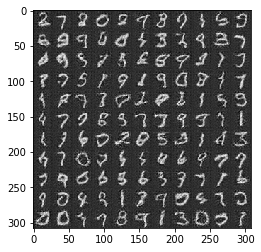

Epoch: 8/8 Discriminator Loss: 0.4522 Generator Loss: 1.3799
Epoch: 8/8 Discriminator Loss: 0.2929 Generator Loss: 1.9226
Epoch: 8/8 Discriminator Loss: 0.2645 Generator Loss: 1.8736
Epoch: 8/8 Discriminator Loss: 0.3257 Generator Loss: 1.6500
Epoch: 8/8 Discriminator Loss: 0.1438 Generator Loss: 2.6421
Epoch: 8/8 Discriminator Loss: 0.2032 Generator Loss: 2.0447
Epoch: 8/8 Discriminator Loss: 0.2373 Generator Loss: 2.0351
Epoch: 8/8 Discriminator Loss: 0.0633 Generator Loss: 3.6722
Epoch: 8/8 Discriminator Loss: 0.1217 Generator Loss: 2.7450
Epoch: 8/8 Discriminator Loss: 0.1294 Generator Loss: 2.8417


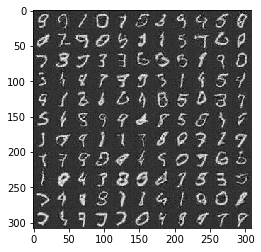

Epoch: 8/8 Discriminator Loss: 0.1175 Generator Loss: 3.5025
Epoch: 8/8 Discriminator Loss: 0.1336 Generator Loss: 2.5506
Epoch: 8/8 Discriminator Loss: 0.0522 Generator Loss: 3.7265
Epoch: 8/8 Discriminator Loss: 0.0585 Generator Loss: 3.6076
Epoch: 8/8 Discriminator Loss: 0.0690 Generator Loss: 3.3748
Epoch: 8/8 Discriminator Loss: 0.0574 Generator Loss: 3.8591
Epoch: 8/8 Discriminator Loss: 0.0721 Generator Loss: 3.5026
Epoch: 8/8 Discriminator Loss: 0.0892 Generator Loss: 3.0490
Epoch: 8/8 Discriminator Loss: 0.0466 Generator Loss: 3.7098
Epoch: 8/8 Discriminator Loss: 0.1172 Generator Loss: 2.6183


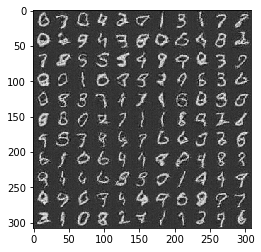

Epoch: 8/8 Discriminator Loss: 0.0698 Generator Loss: 4.0620
Epoch: 8/8 Discriminator Loss: 0.4685 Generator Loss: 1.5661
Epoch: 8/8 Discriminator Loss: 0.3147 Generator Loss: 1.6714
Epoch: 8/8 Discriminator Loss: 0.1655 Generator Loss: 2.4589
Epoch: 8/8 Discriminator Loss: 0.1198 Generator Loss: 3.1429
Epoch: 8/8 Discriminator Loss: 0.0529 Generator Loss: 3.8841
Epoch: 8/8 Discriminator Loss: 0.1050 Generator Loss: 2.8503
Epoch: 8/8 Discriminator Loss: 0.2814 Generator Loss: 1.6902
Epoch: 8/8 Discriminator Loss: 0.0420 Generator Loss: 4.4888
Epoch: 8/8 Discriminator Loss: 0.0365 Generator Loss: 5.8527


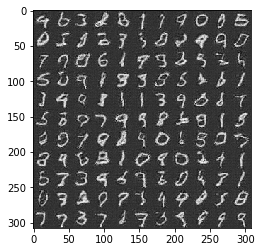

Epoch: 8/8 Discriminator Loss: 0.0402 Generator Loss: 3.9216
Epoch: 8/8 Discriminator Loss: 0.0238 Generator Loss: 4.8569
Epoch: 8/8 Discriminator Loss: 0.0301 Generator Loss: 4.9412
Epoch: 8/8 Discriminator Loss: 0.0369 Generator Loss: 4.3494


In [14]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 8

mnist_dataset = helper.Dataset('mnist', glob(os.path.join(data_dir, 'mnist/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, mnist_dataset.get_batches,
          mnist_dataset.shape, mnist_dataset.image_mode)

### CelebA
在 CelebA 上运行你的 GANs 模型。在一般的GPU上运行每次迭代大约需要 20 分钟。你可以运行整个迭代，或者当 GANs 开始产生真实人脸图像时停止它。

Epoch: 1/16 Discriminator Loss: 0.8914 Generator Loss: 1.0087
Epoch: 1/16 Discriminator Loss: 1.3492 Generator Loss: 0.3601
Epoch: 1/16 Discriminator Loss: 0.3419 Generator Loss: 1.9170
Epoch: 1/16 Discriminator Loss: 0.2695 Generator Loss: 6.3826
Epoch: 1/16 Discriminator Loss: 3.3514 Generator Loss: 0.0412
Epoch: 1/16 Discriminator Loss: 2.1674 Generator Loss: 0.1330
Epoch: 1/16 Discriminator Loss: 0.2825 Generator Loss: 3.2726
Epoch: 1/16 Discriminator Loss: 0.1242 Generator Loss: 7.9504
Epoch: 1/16 Discriminator Loss: 0.3839 Generator Loss: 7.2135
Epoch: 1/16 Discriminator Loss: 0.8711 Generator Loss: 6.1374


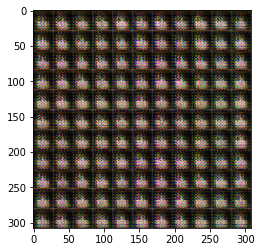

Epoch: 1/16 Discriminator Loss: 0.2254 Generator Loss: 2.5678
Epoch: 1/16 Discriminator Loss: 0.1414 Generator Loss: 2.6517
Epoch: 1/16 Discriminator Loss: 0.2961 Generator Loss: 1.6763
Epoch: 1/16 Discriminator Loss: 0.0766 Generator Loss: 4.4702
Epoch: 1/16 Discriminator Loss: 0.1384 Generator Loss: 3.1032
Epoch: 1/16 Discriminator Loss: 0.0939 Generator Loss: 3.0509
Epoch: 1/16 Discriminator Loss: 0.0542 Generator Loss: 3.6010
Epoch: 1/16 Discriminator Loss: 0.1079 Generator Loss: 2.7759
Epoch: 1/16 Discriminator Loss: 0.0977 Generator Loss: 2.7881
Epoch: 1/16 Discriminator Loss: 0.0724 Generator Loss: 3.0953


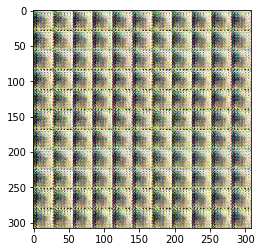

Epoch: 1/16 Discriminator Loss: 0.0650 Generator Loss: 3.3636
Epoch: 1/16 Discriminator Loss: 0.3553 Generator Loss: 1.2671
Epoch: 1/16 Discriminator Loss: 0.0246 Generator Loss: 4.1412
Epoch: 1/16 Discriminator Loss: 0.0031 Generator Loss: 12.5936
Epoch: 1/16 Discriminator Loss: 0.0460 Generator Loss: 3.5237
Epoch: 1/16 Discriminator Loss: 0.0687 Generator Loss: 2.9969
Epoch: 1/16 Discriminator Loss: 0.0965 Generator Loss: 4.1021
Epoch: 1/16 Discriminator Loss: 0.0748 Generator Loss: 12.8331
Epoch: 1/16 Discriminator Loss: 0.1981 Generator Loss: 1.7703
Epoch: 1/16 Discriminator Loss: 0.0689 Generator Loss: 2.7458


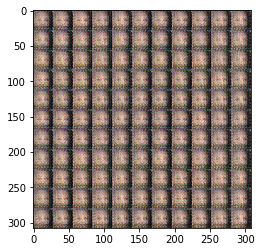

Epoch: 1/16 Discriminator Loss: 4.8101 Generator Loss: 0.0089
Epoch: 1/16 Discriminator Loss: 1.3221 Generator Loss: 0.3303
Epoch: 1/16 Discriminator Loss: 0.0566 Generator Loss: 4.0126
Epoch: 1/16 Discriminator Loss: 0.0838 Generator Loss: 3.1542
Epoch: 1/16 Discriminator Loss: 0.1570 Generator Loss: 7.1712
Epoch: 1/16 Discriminator Loss: 0.0247 Generator Loss: 4.7990
Epoch: 1/16 Discriminator Loss: 0.1958 Generator Loss: 1.9567
Epoch: 1/16 Discriminator Loss: 0.0754 Generator Loss: 3.4696
Epoch: 1/16 Discriminator Loss: 0.6638 Generator Loss: 10.4774
Epoch: 1/16 Discriminator Loss: 0.9228 Generator Loss: 12.3204


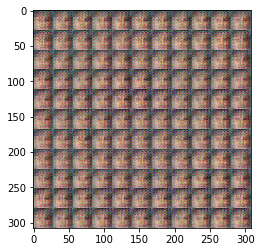

Epoch: 1/16 Discriminator Loss: 0.4433 Generator Loss: 2.4471
Epoch: 1/16 Discriminator Loss: 0.3136 Generator Loss: 1.7630
Epoch: 1/16 Discriminator Loss: 0.6567 Generator Loss: 1.6726
Epoch: 1/16 Discriminator Loss: 0.4319 Generator Loss: 1.8529
Epoch: 1/16 Discriminator Loss: 0.2431 Generator Loss: 4.1304
Epoch: 1/16 Discriminator Loss: 0.7799 Generator Loss: 6.4949
Epoch: 1/16 Discriminator Loss: 1.7151 Generator Loss: 4.8183
Epoch: 1/16 Discriminator Loss: 0.3228 Generator Loss: 5.4228
Epoch: 1/16 Discriminator Loss: 0.3989 Generator Loss: 1.2085
Epoch: 1/16 Discriminator Loss: 1.3413 Generator Loss: 0.3875


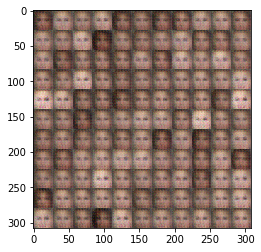

Epoch: 1/16 Discriminator Loss: 1.2055 Generator Loss: 0.4180
Epoch: 1/16 Discriminator Loss: 0.2965 Generator Loss: 2.3049
Epoch: 1/16 Discriminator Loss: 0.6323 Generator Loss: 1.9712
Epoch: 1/16 Discriminator Loss: 0.2649 Generator Loss: 2.0367
Epoch: 1/16 Discriminator Loss: 0.1365 Generator Loss: 3.8986
Epoch: 1/16 Discriminator Loss: 0.3674 Generator Loss: 2.5371
Epoch: 1/16 Discriminator Loss: 0.3759 Generator Loss: 9.1377
Epoch: 1/16 Discriminator Loss: 0.4684 Generator Loss: 1.4842
Epoch: 1/16 Discriminator Loss: 0.2547 Generator Loss: 3.4271
Epoch: 1/16 Discriminator Loss: 0.4204 Generator Loss: 2.9376


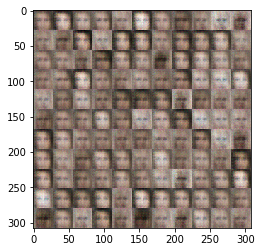

Epoch: 1/16 Discriminator Loss: 0.6957 Generator Loss: 0.8672
Epoch: 1/16 Discriminator Loss: 0.0912 Generator Loss: 7.0032
Epoch: 1/16 Discriminator Loss: 1.3373 Generator Loss: 7.1259
Epoch: 1/16 Discriminator Loss: 0.3604 Generator Loss: 1.5306
Epoch: 1/16 Discriminator Loss: 0.8978 Generator Loss: 0.7437
Epoch: 1/16 Discriminator Loss: 0.0385 Generator Loss: 5.6744
Epoch: 1/16 Discriminator Loss: 0.2492 Generator Loss: 1.8388
Epoch: 1/16 Discriminator Loss: 0.6287 Generator Loss: 0.9469
Epoch: 1/16 Discriminator Loss: 0.0704 Generator Loss: 5.7562
Epoch: 1/16 Discriminator Loss: 0.0980 Generator Loss: 3.8470


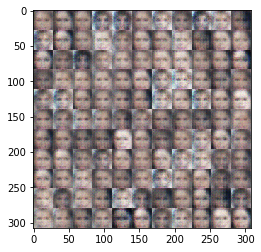

Epoch: 1/16 Discriminator Loss: 0.2141 Generator Loss: 1.9976
Epoch: 1/16 Discriminator Loss: 0.1698 Generator Loss: 6.4006
Epoch: 1/16 Discriminator Loss: 0.2047 Generator Loss: 1.9623
Epoch: 1/16 Discriminator Loss: 0.4488 Generator Loss: 1.4144
Epoch: 1/16 Discriminator Loss: 0.0443 Generator Loss: 4.3201
Epoch: 1/16 Discriminator Loss: 0.1404 Generator Loss: 3.0510
Epoch: 1/16 Discriminator Loss: 0.0305 Generator Loss: 5.4976
Epoch: 1/16 Discriminator Loss: 1.4694 Generator Loss: 0.3417
Epoch: 1/16 Discriminator Loss: 0.0367 Generator Loss: 6.9154
Epoch: 1/16 Discriminator Loss: 0.1192 Generator Loss: 9.6930


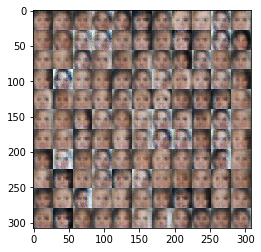

Epoch: 1/16 Discriminator Loss: 1.6084 Generator Loss: 7.9498
Epoch: 1/16 Discriminator Loss: 0.2577 Generator Loss: 2.0417
Epoch: 1/16 Discriminator Loss: 0.0206 Generator Loss: 5.3449
Epoch: 1/16 Discriminator Loss: 0.0957 Generator Loss: 3.3140
Epoch: 1/16 Discriminator Loss: 1.0946 Generator Loss: 9.1465
Epoch: 1/16 Discriminator Loss: 0.5218 Generator Loss: 1.2275
Epoch: 1/16 Discriminator Loss: 0.1582 Generator Loss: 10.6461
Epoch: 1/16 Discriminator Loss: 0.0345 Generator Loss: 9.1039
Epoch: 1/16 Discriminator Loss: 1.0057 Generator Loss: 0.6100
Epoch: 1/16 Discriminator Loss: 3.0227 Generator Loss: 0.0727


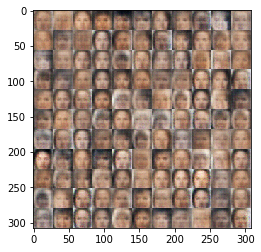

Epoch: 1/16 Discriminator Loss: 0.0438 Generator Loss: 4.0983
Epoch: 1/16 Discriminator Loss: 0.0437 Generator Loss: 4.4692
Epoch: 1/16 Discriminator Loss: 1.7705 Generator Loss: 0.2427
Epoch: 1/16 Discriminator Loss: 0.3503 Generator Loss: 12.1725
Epoch: 1/16 Discriminator Loss: 0.0282 Generator Loss: 8.6978
Epoch: 1/16 Discriminator Loss: 1.4982 Generator Loss: 8.9873
Epoch: 1/16 Discriminator Loss: 0.0328 Generator Loss: 5.9098
Epoch: 1/16 Discriminator Loss: 0.0901 Generator Loss: 5.4120
Epoch: 1/16 Discriminator Loss: 0.0778 Generator Loss: 6.0714
Epoch: 1/16 Discriminator Loss: 0.8498 Generator Loss: 0.7177


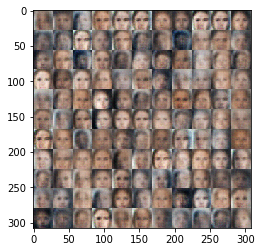

Epoch: 1/16 Discriminator Loss: 0.2613 Generator Loss: 2.0997
Epoch: 1/16 Discriminator Loss: 0.0549 Generator Loss: 11.7795
Epoch: 1/16 Discriminator Loss: 0.0626 Generator Loss: 3.9334
Epoch: 1/16 Discriminator Loss: 0.0418 Generator Loss: 4.1134
Epoch: 1/16 Discriminator Loss: 0.1858 Generator Loss: 2.0619
Epoch: 1/16 Discriminator Loss: 0.0239 Generator Loss: 6.5070
Epoch: 1/16 Discriminator Loss: 0.0701 Generator Loss: 6.5757
Epoch: 1/16 Discriminator Loss: 0.3698 Generator Loss: 1.4425
Epoch: 1/16 Discriminator Loss: 0.0150 Generator Loss: 7.4155
Epoch: 1/16 Discriminator Loss: 2.2241 Generator Loss: 0.1359


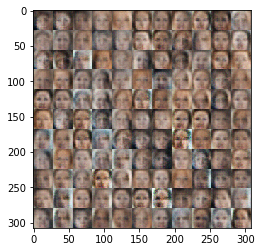

Epoch: 1/16 Discriminator Loss: 0.1001 Generator Loss: 4.3095
Epoch: 1/16 Discriminator Loss: 0.9001 Generator Loss: 0.6191
Epoch: 1/16 Discriminator Loss: 0.0622 Generator Loss: 3.7078
Epoch: 1/16 Discriminator Loss: 0.0146 Generator Loss: 8.2279
Epoch: 1/16 Discriminator Loss: 0.0367 Generator Loss: 10.0032
Epoch: 1/16 Discriminator Loss: 1.9601 Generator Loss: 6.9401
Epoch: 1/16 Discriminator Loss: 0.0337 Generator Loss: 7.6432
Epoch: 1/16 Discriminator Loss: 0.0156 Generator Loss: 13.0490
Epoch: 1/16 Discriminator Loss: 0.0179 Generator Loss: 6.3289
Epoch: 1/16 Discriminator Loss: 0.0282 Generator Loss: 8.4727


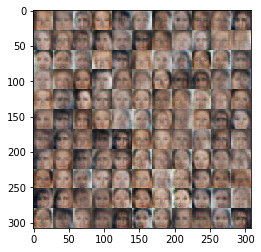

Epoch: 1/16 Discriminator Loss: 0.0319 Generator Loss: 5.6197
Epoch: 1/16 Discriminator Loss: 0.0608 Generator Loss: 9.9927
Epoch: 1/16 Discriminator Loss: 0.0218 Generator Loss: 6.7222
Epoch: 1/16 Discriminator Loss: 0.1183 Generator Loss: 9.3654
Epoch: 1/16 Discriminator Loss: 0.0950 Generator Loss: 2.8276
Epoch: 1/16 Discriminator Loss: 0.0221 Generator Loss: 8.7956
Epoch: 1/16 Discriminator Loss: 0.9396 Generator Loss: 0.5730
Epoch: 1/16 Discriminator Loss: 0.0165 Generator Loss: 12.2752
Epoch: 1/16 Discriminator Loss: 0.0257 Generator Loss: 4.7932
Epoch: 1/16 Discriminator Loss: 0.0516 Generator Loss: 11.2926


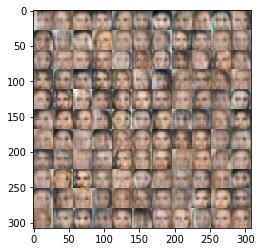

Epoch: 1/16 Discriminator Loss: 0.0112 Generator Loss: 7.8902
Epoch: 1/16 Discriminator Loss: 0.0216 Generator Loss: 8.9659
Epoch: 1/16 Discriminator Loss: 1.9370 Generator Loss: 0.2082
Epoch: 1/16 Discriminator Loss: 0.4230 Generator Loss: 1.3763
Epoch: 1/16 Discriminator Loss: 0.0324 Generator Loss: 7.0429
Epoch: 1/16 Discriminator Loss: 0.0133 Generator Loss: 5.6250
Epoch: 1/16 Discriminator Loss: 0.0303 Generator Loss: 4.8583
Epoch: 1/16 Discriminator Loss: 0.0329 Generator Loss: 9.2300
Epoch: 1/16 Discriminator Loss: 0.0730 Generator Loss: 3.0437
Epoch: 1/16 Discriminator Loss: 0.0386 Generator Loss: 8.3446


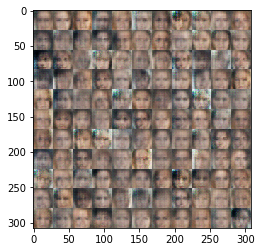

Epoch: 1/16 Discriminator Loss: 0.1096 Generator Loss: 4.1855
Epoch: 1/16 Discriminator Loss: 0.0340 Generator Loss: 4.3499
Epoch: 1/16 Discriminator Loss: 0.0287 Generator Loss: 5.2007
Epoch: 1/16 Discriminator Loss: 0.0922 Generator Loss: 11.2806
Epoch: 1/16 Discriminator Loss: 0.0200 Generator Loss: 5.2029
Epoch: 1/16 Discriminator Loss: 0.0222 Generator Loss: 8.7327
Epoch: 1/16 Discriminator Loss: 0.0306 Generator Loss: 4.5250
Epoch: 1/16 Discriminator Loss: 0.0137 Generator Loss: 6.4959
Epoch: 1/16 Discriminator Loss: 0.0314 Generator Loss: 8.8583
Epoch: 1/16 Discriminator Loss: 0.0064 Generator Loss: 8.6379


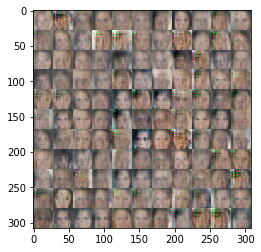

Epoch: 1/16 Discriminator Loss: 0.0123 Generator Loss: 6.1273
Epoch: 1/16 Discriminator Loss: 0.0364 Generator Loss: 4.0450
Epoch: 1/16 Discriminator Loss: 0.0494 Generator Loss: 6.9827
Epoch: 1/16 Discriminator Loss: 1.0432 Generator Loss: 0.7705
Epoch: 1/16 Discriminator Loss: 0.2777 Generator Loss: 2.9970
Epoch: 1/16 Discriminator Loss: 0.0991 Generator Loss: 3.0300
Epoch: 1/16 Discriminator Loss: 0.1657 Generator Loss: 11.9441
Epoch: 1/16 Discriminator Loss: 0.0136 Generator Loss: 9.6232
Epoch: 2/16 Discriminator Loss: 0.0276 Generator Loss: 5.9861
Epoch: 2/16 Discriminator Loss: 0.1403 Generator Loss: 5.7209


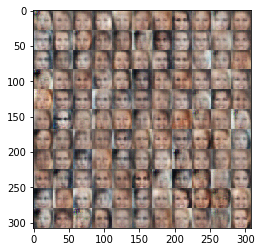

Epoch: 2/16 Discriminator Loss: 0.0143 Generator Loss: 6.5984
Epoch: 2/16 Discriminator Loss: 0.0471 Generator Loss: 4.3737
Epoch: 2/16 Discriminator Loss: 0.0143 Generator Loss: 9.8266
Epoch: 2/16 Discriminator Loss: 0.0584 Generator Loss: 6.2259
Epoch: 2/16 Discriminator Loss: 0.0185 Generator Loss: 8.7436
Epoch: 2/16 Discriminator Loss: 0.0263 Generator Loss: 7.5708
Epoch: 2/16 Discriminator Loss: 0.0213 Generator Loss: 11.1563
Epoch: 2/16 Discriminator Loss: 0.0546 Generator Loss: 10.7860
Epoch: 2/16 Discriminator Loss: 0.0278 Generator Loss: 6.6278
Epoch: 2/16 Discriminator Loss: 0.0108 Generator Loss: 9.9268


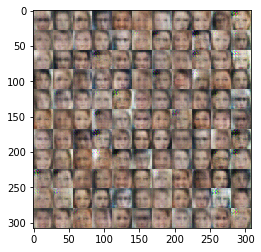

Epoch: 2/16 Discriminator Loss: 0.3954 Generator Loss: 9.0491
Epoch: 2/16 Discriminator Loss: 0.0110 Generator Loss: 7.6990
Epoch: 2/16 Discriminator Loss: 0.0270 Generator Loss: 4.5962
Epoch: 2/16 Discriminator Loss: 0.0798 Generator Loss: 3.5589
Epoch: 2/16 Discriminator Loss: 0.0174 Generator Loss: 5.8612
Epoch: 2/16 Discriminator Loss: 0.0161 Generator Loss: 6.4248
Epoch: 2/16 Discriminator Loss: 0.0321 Generator Loss: 5.2571
Epoch: 2/16 Discriminator Loss: 0.2900 Generator Loss: 1.8285
Epoch: 2/16 Discriminator Loss: 0.0180 Generator Loss: 6.6343
Epoch: 2/16 Discriminator Loss: 0.0167 Generator Loss: 6.2847


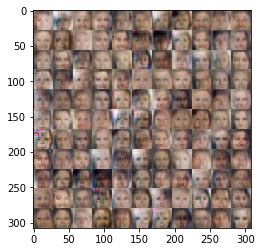

Epoch: 2/16 Discriminator Loss: 0.0240 Generator Loss: 4.8502
Epoch: 2/16 Discriminator Loss: 0.2474 Generator Loss: 1.8426
Epoch: 2/16 Discriminator Loss: 0.0176 Generator Loss: 5.5777
Epoch: 2/16 Discriminator Loss: 0.1464 Generator Loss: 2.8310
Epoch: 2/16 Discriminator Loss: 0.0167 Generator Loss: 6.1527
Epoch: 2/16 Discriminator Loss: 0.0110 Generator Loss: 8.1712
Epoch: 2/16 Discriminator Loss: 0.0453 Generator Loss: 11.0962
Epoch: 2/16 Discriminator Loss: 0.0061 Generator Loss: 7.6214
Epoch: 2/16 Discriminator Loss: 0.0966 Generator Loss: 2.9388
Epoch: 2/16 Discriminator Loss: 0.1429 Generator Loss: 2.3391


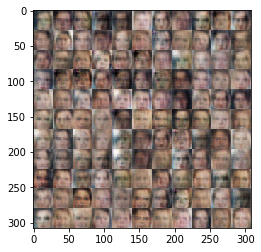

Epoch: 2/16 Discriminator Loss: 0.0261 Generator Loss: 11.5979
Epoch: 2/16 Discriminator Loss: 0.0185 Generator Loss: 5.3450
Epoch: 2/16 Discriminator Loss: 1.5400 Generator Loss: 8.1266
Epoch: 2/16 Discriminator Loss: 0.0304 Generator Loss: 10.1091
Epoch: 2/16 Discriminator Loss: 0.0464 Generator Loss: 7.5032
Epoch: 2/16 Discriminator Loss: 0.0123 Generator Loss: 6.9615
Epoch: 2/16 Discriminator Loss: 0.0208 Generator Loss: 9.3715
Epoch: 2/16 Discriminator Loss: 0.0534 Generator Loss: 7.6403
Epoch: 2/16 Discriminator Loss: 0.0115 Generator Loss: 9.0103
Epoch: 2/16 Discriminator Loss: 0.2987 Generator Loss: 11.8648


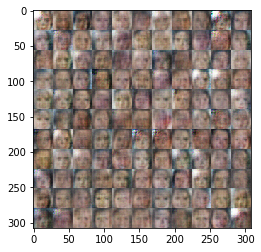

Epoch: 2/16 Discriminator Loss: 0.0553 Generator Loss: 10.3189
Epoch: 2/16 Discriminator Loss: 0.0065 Generator Loss: 8.4299
Epoch: 2/16 Discriminator Loss: 0.0046 Generator Loss: 8.0888
Epoch: 2/16 Discriminator Loss: 0.0127 Generator Loss: 5.8832
Epoch: 2/16 Discriminator Loss: 0.0079 Generator Loss: 6.5779
Epoch: 2/16 Discriminator Loss: 0.0252 Generator Loss: 9.1547
Epoch: 2/16 Discriminator Loss: 0.0138 Generator Loss: 8.3506
Epoch: 2/16 Discriminator Loss: 0.0055 Generator Loss: 8.7351
Epoch: 2/16 Discriminator Loss: 0.0119 Generator Loss: 6.0815
Epoch: 2/16 Discriminator Loss: 0.0326 Generator Loss: 9.2879


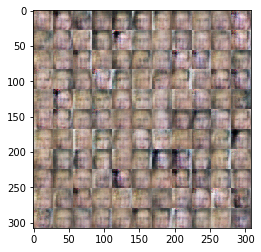

Epoch: 2/16 Discriminator Loss: 0.0055 Generator Loss: 8.0752
Epoch: 2/16 Discriminator Loss: 0.0066 Generator Loss: 9.0641
Epoch: 2/16 Discriminator Loss: 0.0051 Generator Loss: 9.3340
Epoch: 2/16 Discriminator Loss: 0.0104 Generator Loss: 9.8712
Epoch: 2/16 Discriminator Loss: 0.0105 Generator Loss: 7.3159
Epoch: 2/16 Discriminator Loss: 0.0086 Generator Loss: 10.9664
Epoch: 2/16 Discriminator Loss: 0.0059 Generator Loss: 7.0934
Epoch: 2/16 Discriminator Loss: 0.0129 Generator Loss: 12.0385
Epoch: 2/16 Discriminator Loss: 0.0029 Generator Loss: 8.1787
Epoch: 2/16 Discriminator Loss: 0.0048 Generator Loss: 7.4928


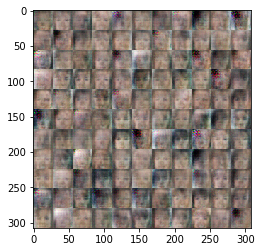

Epoch: 2/16 Discriminator Loss: 0.0120 Generator Loss: 5.6715
Epoch: 2/16 Discriminator Loss: 0.0229 Generator Loss: 4.3548
Epoch: 2/16 Discriminator Loss: 0.0093 Generator Loss: 8.4510
Epoch: 2/16 Discriminator Loss: 0.0348 Generator Loss: 6.0401
Epoch: 2/16 Discriminator Loss: 0.0030 Generator Loss: 8.7001
Epoch: 2/16 Discriminator Loss: 0.0169 Generator Loss: 4.7864
Epoch: 2/16 Discriminator Loss: 0.1971 Generator Loss: 4.1754
Epoch: 2/16 Discriminator Loss: 0.0053 Generator Loss: 6.8245
Epoch: 2/16 Discriminator Loss: 0.0046 Generator Loss: 10.9678
Epoch: 2/16 Discriminator Loss: 0.0332 Generator Loss: 4.9637


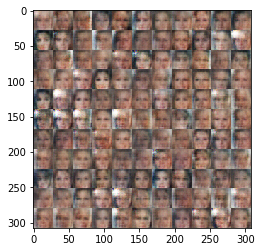

Epoch: 2/16 Discriminator Loss: 0.0312 Generator Loss: 10.3480
Epoch: 2/16 Discriminator Loss: 0.0140 Generator Loss: 10.8141
Epoch: 2/16 Discriminator Loss: 0.0258 Generator Loss: 4.2252
Epoch: 2/16 Discriminator Loss: 0.0104 Generator Loss: 10.5963
Epoch: 2/16 Discriminator Loss: 0.0095 Generator Loss: 11.4159
Epoch: 2/16 Discriminator Loss: 0.0321 Generator Loss: 9.6518
Epoch: 2/16 Discriminator Loss: 0.0086 Generator Loss: 6.9297
Epoch: 2/16 Discriminator Loss: 0.0056 Generator Loss: 8.5319
Epoch: 2/16 Discriminator Loss: 0.0068 Generator Loss: 7.2041
Epoch: 2/16 Discriminator Loss: 0.0142 Generator Loss: 8.8896


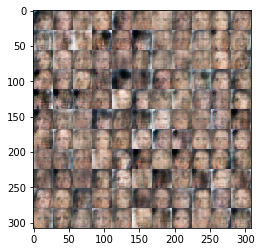

Epoch: 2/16 Discriminator Loss: 0.1855 Generator Loss: 2.2827
Epoch: 2/16 Discriminator Loss: 0.0550 Generator Loss: 3.5316
Epoch: 2/16 Discriminator Loss: 0.1033 Generator Loss: 2.8667
Epoch: 2/16 Discriminator Loss: 0.6131 Generator Loss: 1.0548
Epoch: 2/16 Discriminator Loss: 0.0573 Generator Loss: 3.6958
Epoch: 2/16 Discriminator Loss: 0.5480 Generator Loss: 1.1986
Epoch: 2/16 Discriminator Loss: 0.1208 Generator Loss: 2.8454
Epoch: 2/16 Discriminator Loss: 0.1124 Generator Loss: 2.5853
Epoch: 2/16 Discriminator Loss: 0.0271 Generator Loss: 5.9369
Epoch: 2/16 Discriminator Loss: 0.0409 Generator Loss: 3.9340


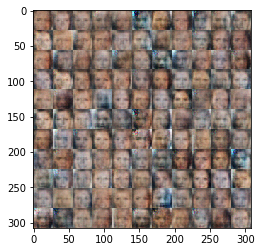

Epoch: 2/16 Discriminator Loss: 0.0109 Generator Loss: 6.3687
Epoch: 2/16 Discriminator Loss: 0.0145 Generator Loss: 5.1859
Epoch: 2/16 Discriminator Loss: 0.0078 Generator Loss: 8.0256
Epoch: 2/16 Discriminator Loss: 1.2153 Generator Loss: 10.9169
Epoch: 2/16 Discriminator Loss: 0.0496 Generator Loss: 3.7583
Epoch: 2/16 Discriminator Loss: 0.0864 Generator Loss: 6.4122
Epoch: 2/16 Discriminator Loss: 0.0034 Generator Loss: 7.9554
Epoch: 2/16 Discriminator Loss: 0.0375 Generator Loss: 9.0862
Epoch: 2/16 Discriminator Loss: 0.0721 Generator Loss: 4.2239
Epoch: 2/16 Discriminator Loss: 1.7300 Generator Loss: 8.5693


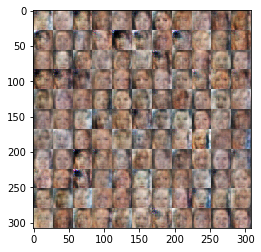

Epoch: 2/16 Discriminator Loss: 0.0047 Generator Loss: 7.0572
Epoch: 2/16 Discriminator Loss: 0.0115 Generator Loss: 8.2721
Epoch: 2/16 Discriminator Loss: 0.3437 Generator Loss: 7.7347
Epoch: 2/16 Discriminator Loss: 0.0093 Generator Loss: 9.6752
Epoch: 2/16 Discriminator Loss: 0.0059 Generator Loss: 9.2590
Epoch: 2/16 Discriminator Loss: 0.0419 Generator Loss: 3.6174
Epoch: 2/16 Discriminator Loss: 0.0333 Generator Loss: 10.7231
Epoch: 2/16 Discriminator Loss: 0.0154 Generator Loss: 4.8010
Epoch: 2/16 Discriminator Loss: 0.0523 Generator Loss: 9.3436
Epoch: 2/16 Discriminator Loss: 0.0340 Generator Loss: 5.3763


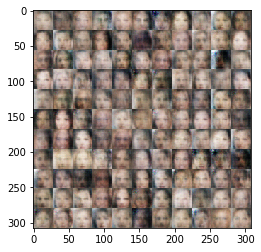

Epoch: 2/16 Discriminator Loss: 0.0978 Generator Loss: 7.5149
Epoch: 2/16 Discriminator Loss: 0.5115 Generator Loss: 10.8583
Epoch: 2/16 Discriminator Loss: 0.0062 Generator Loss: 8.2574
Epoch: 2/16 Discriminator Loss: 0.0471 Generator Loss: 8.8114
Epoch: 2/16 Discriminator Loss: 0.0126 Generator Loss: 8.6725
Epoch: 2/16 Discriminator Loss: 0.0084 Generator Loss: 11.3959
Epoch: 2/16 Discriminator Loss: 0.0038 Generator Loss: 8.2348
Epoch: 2/16 Discriminator Loss: 0.0063 Generator Loss: 7.3609
Epoch: 2/16 Discriminator Loss: 0.0058 Generator Loss: 6.0817
Epoch: 2/16 Discriminator Loss: 0.0051 Generator Loss: 8.5396


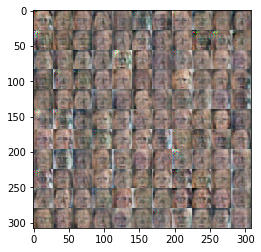

Epoch: 2/16 Discriminator Loss: 0.0048 Generator Loss: 6.8799
Epoch: 2/16 Discriminator Loss: 0.0369 Generator Loss: 3.7509
Epoch: 2/16 Discriminator Loss: 0.0121 Generator Loss: 5.3658
Epoch: 2/16 Discriminator Loss: 0.0094 Generator Loss: 10.0557
Epoch: 2/16 Discriminator Loss: 0.0053 Generator Loss: 7.7662
Epoch: 2/16 Discriminator Loss: 0.0048 Generator Loss: 7.0687
Epoch: 2/16 Discriminator Loss: 0.0063 Generator Loss: 5.6497
Epoch: 2/16 Discriminator Loss: 0.0022 Generator Loss: 9.8602
Epoch: 2/16 Discriminator Loss: 0.0093 Generator Loss: 5.2829
Epoch: 2/16 Discriminator Loss: 0.0016 Generator Loss: 9.3843


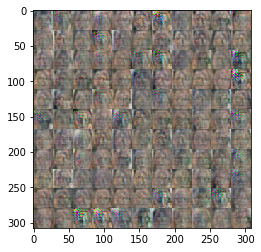

Epoch: 2/16 Discriminator Loss: 0.0036 Generator Loss: 6.8172
Epoch: 2/16 Discriminator Loss: 0.0052 Generator Loss: 6.3562
Epoch: 2/16 Discriminator Loss: 0.0031 Generator Loss: 6.6733
Epoch: 2/16 Discriminator Loss: 0.0147 Generator Loss: 4.6257
Epoch: 2/16 Discriminator Loss: 0.0031 Generator Loss: 7.4671
Epoch: 2/16 Discriminator Loss: 0.0044 Generator Loss: 6.1620
Epoch: 2/16 Discriminator Loss: 0.0158 Generator Loss: 4.4405
Epoch: 2/16 Discriminator Loss: 0.0043 Generator Loss: 9.3604
Epoch: 2/16 Discriminator Loss: 0.0044 Generator Loss: 7.2972
Epoch: 2/16 Discriminator Loss: 0.0013 Generator Loss: 8.4414


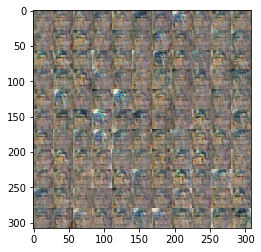

Epoch: 2/16 Discriminator Loss: 0.0071 Generator Loss: 9.3553
Epoch: 2/16 Discriminator Loss: 0.0038 Generator Loss: 7.0150
Epoch: 2/16 Discriminator Loss: 0.0079 Generator Loss: 5.4930
Epoch: 2/16 Discriminator Loss: 0.0086 Generator Loss: 5.0140
Epoch: 2/16 Discriminator Loss: 0.0015 Generator Loss: 9.3034
Epoch: 2/16 Discriminator Loss: 0.0033 Generator Loss: 7.4252
Epoch: 2/16 Discriminator Loss: 0.0075 Generator Loss: 5.6037
Epoch: 2/16 Discriminator Loss: 0.0129 Generator Loss: 4.9699
Epoch: 2/16 Discriminator Loss: 0.0013 Generator Loss: 8.5945
Epoch: 2/16 Discriminator Loss: 0.0076 Generator Loss: 5.4574


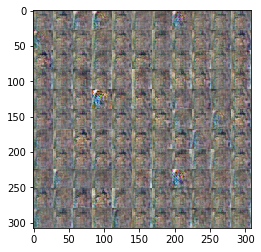

Epoch: 2/16 Discriminator Loss: 0.0056 Generator Loss: 5.8031
Epoch: 2/16 Discriminator Loss: 0.0021 Generator Loss: 7.5747
Epoch: 2/16 Discriminator Loss: 0.0067 Generator Loss: 6.7771
Epoch: 2/16 Discriminator Loss: 0.0034 Generator Loss: 6.5039
Epoch: 2/16 Discriminator Loss: 0.0046 Generator Loss: 6.1026
Epoch: 2/16 Discriminator Loss: 0.0078 Generator Loss: 5.2890
Epoch: 3/16 Discriminator Loss: 0.0080 Generator Loss: 5.3742
Epoch: 3/16 Discriminator Loss: 0.0233 Generator Loss: 4.0849
Epoch: 3/16 Discriminator Loss: 0.0017 Generator Loss: 8.9270
Epoch: 3/16 Discriminator Loss: 0.0037 Generator Loss: 8.0269


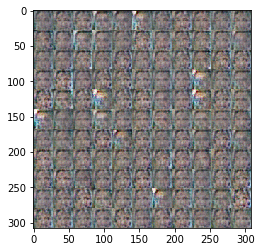

Epoch: 3/16 Discriminator Loss: 0.0044 Generator Loss: 12.0393
Epoch: 3/16 Discriminator Loss: 0.0061 Generator Loss: 9.5557
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 8.3459
Epoch: 3/16 Discriminator Loss: 0.0019 Generator Loss: 7.5547
Epoch: 3/16 Discriminator Loss: 0.0033 Generator Loss: 6.6006
Epoch: 3/16 Discriminator Loss: 0.0084 Generator Loss: 5.3654
Epoch: 3/16 Discriminator Loss: 0.0065 Generator Loss: 5.4129
Epoch: 3/16 Discriminator Loss: 0.0106 Generator Loss: 4.8609
Epoch: 3/16 Discriminator Loss: 0.0068 Generator Loss: 5.3012
Epoch: 3/16 Discriminator Loss: 0.0037 Generator Loss: 5.8587


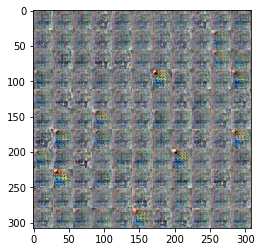

Epoch: 3/16 Discriminator Loss: 0.0027 Generator Loss: 6.3783
Epoch: 3/16 Discriminator Loss: 0.0035 Generator Loss: 5.9051
Epoch: 3/16 Discriminator Loss: 0.0075 Generator Loss: 5.2048
Epoch: 3/16 Discriminator Loss: 0.0043 Generator Loss: 5.7190
Epoch: 3/16 Discriminator Loss: 0.0027 Generator Loss: 6.2103
Epoch: 3/16 Discriminator Loss: 0.0061 Generator Loss: 5.3910
Epoch: 3/16 Discriminator Loss: 0.0038 Generator Loss: 5.8618
Epoch: 3/16 Discriminator Loss: 0.0035 Generator Loss: 5.9882
Epoch: 3/16 Discriminator Loss: 0.0023 Generator Loss: 6.3051
Epoch: 3/16 Discriminator Loss: 0.0033 Generator Loss: 6.1358


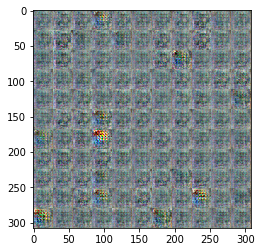

Epoch: 3/16 Discriminator Loss: 0.0035 Generator Loss: 5.8704
Epoch: 3/16 Discriminator Loss: 0.0069 Generator Loss: 5.1759
Epoch: 3/16 Discriminator Loss: 0.0028 Generator Loss: 6.2895
Epoch: 3/16 Discriminator Loss: 0.0059 Generator Loss: 5.3166
Epoch: 3/16 Discriminator Loss: 0.0032 Generator Loss: 5.9160
Epoch: 3/16 Discriminator Loss: 0.0040 Generator Loss: 5.7479
Epoch: 3/16 Discriminator Loss: 0.0029 Generator Loss: 6.0580
Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.4068
Epoch: 3/16 Discriminator Loss: 0.0042 Generator Loss: 5.6858
Epoch: 3/16 Discriminator Loss: 0.0029 Generator Loss: 6.0128


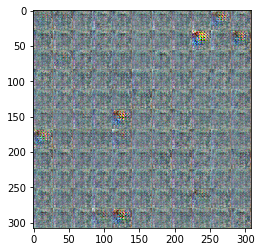

Epoch: 3/16 Discriminator Loss: 0.0033 Generator Loss: 5.9865
Epoch: 3/16 Discriminator Loss: 0.0042 Generator Loss: 5.7466
Epoch: 3/16 Discriminator Loss: 0.0014 Generator Loss: 6.8008
Epoch: 3/16 Discriminator Loss: 0.0026 Generator Loss: 6.2021
Epoch: 3/16 Discriminator Loss: 0.0086 Generator Loss: 5.0098
Epoch: 3/16 Discriminator Loss: 0.0081 Generator Loss: 5.0336
Epoch: 3/16 Discriminator Loss: 0.0054 Generator Loss: 5.3878
Epoch: 3/16 Discriminator Loss: 0.0032 Generator Loss: 5.9256
Epoch: 3/16 Discriminator Loss: 0.0084 Generator Loss: 4.9274
Epoch: 3/16 Discriminator Loss: 0.0075 Generator Loss: 5.0060


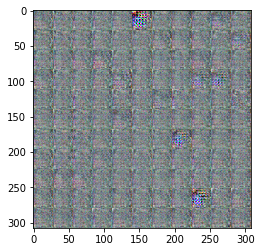

Epoch: 3/16 Discriminator Loss: 0.0067 Generator Loss: 5.1032
Epoch: 3/16 Discriminator Loss: 0.0031 Generator Loss: 5.8581
Epoch: 3/16 Discriminator Loss: 0.0056 Generator Loss: 5.2677
Epoch: 3/16 Discriminator Loss: 0.0024 Generator Loss: 6.1767
Epoch: 3/16 Discriminator Loss: 0.0029 Generator Loss: 5.9462
Epoch: 3/16 Discriminator Loss: 0.0055 Generator Loss: 5.2965
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.1992
Epoch: 3/16 Discriminator Loss: 0.0038 Generator Loss: 5.6786
Epoch: 3/16 Discriminator Loss: 0.0042 Generator Loss: 5.6557
Epoch: 3/16 Discriminator Loss: 0.0030 Generator Loss: 5.9539


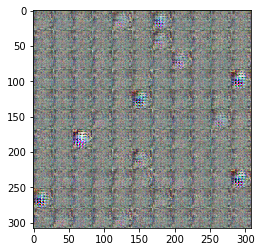

Epoch: 3/16 Discriminator Loss: 0.0014 Generator Loss: 6.8011
Epoch: 3/16 Discriminator Loss: 0.0032 Generator Loss: 5.8384
Epoch: 3/16 Discriminator Loss: 0.0026 Generator Loss: 6.0809
Epoch: 3/16 Discriminator Loss: 0.0020 Generator Loss: 6.3126
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 6.8380
Epoch: 3/16 Discriminator Loss: 0.0014 Generator Loss: 6.7495
Epoch: 3/16 Discriminator Loss: 0.0022 Generator Loss: 6.3191
Epoch: 3/16 Discriminator Loss: 0.0020 Generator Loss: 6.3465
Epoch: 3/16 Discriminator Loss: 0.0035 Generator Loss: 5.7389
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.3122


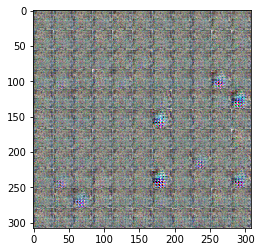

Epoch: 3/16 Discriminator Loss: 0.0019 Generator Loss: 6.3946
Epoch: 3/16 Discriminator Loss: 0.0024 Generator Loss: 6.1493
Epoch: 3/16 Discriminator Loss: 0.0024 Generator Loss: 6.1328
Epoch: 3/16 Discriminator Loss: 0.0017 Generator Loss: 6.4610
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 8.0211
Epoch: 3/16 Discriminator Loss: 0.0024 Generator Loss: 6.1463
Epoch: 3/16 Discriminator Loss: 0.0019 Generator Loss: 6.3620
Epoch: 3/16 Discriminator Loss: 0.0015 Generator Loss: 6.6645
Epoch: 3/16 Discriminator Loss: 0.0016 Generator Loss: 6.5795
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 6.8037


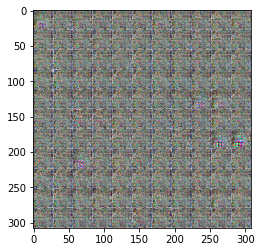

Epoch: 3/16 Discriminator Loss: 0.0006 Generator Loss: 7.6358
Epoch: 3/16 Discriminator Loss: 0.0012 Generator Loss: 6.9373
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.2373
Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.3361
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 6.7978
Epoch: 3/16 Discriminator Loss: 0.0018 Generator Loss: 6.4393
Epoch: 3/16 Discriminator Loss: 0.0010 Generator Loss: 6.9950
Epoch: 3/16 Discriminator Loss: 0.0003 Generator Loss: 8.8365
Epoch: 3/16 Discriminator Loss: 0.0018 Generator Loss: 6.4175
Epoch: 3/16 Discriminator Loss: 0.0045 Generator Loss: 6.5632


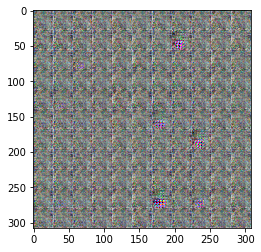

Epoch: 3/16 Discriminator Loss: 0.0010 Generator Loss: 7.0460
Epoch: 3/16 Discriminator Loss: 0.0014 Generator Loss: 6.6437
Epoch: 3/16 Discriminator Loss: 0.0012 Generator Loss: 6.9502
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 6.7216
Epoch: 3/16 Discriminator Loss: 0.0010 Generator Loss: 7.0895
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.1682
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.9087
Epoch: 3/16 Discriminator Loss: 0.0016 Generator Loss: 6.5302
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 6.7186
Epoch: 3/16 Discriminator Loss: 0.0014 Generator Loss: 6.6791


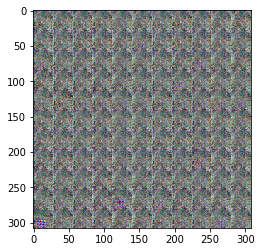

Epoch: 3/16 Discriminator Loss: 0.0014 Generator Loss: 6.6599
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.1254
Epoch: 3/16 Discriminator Loss: 0.0011 Generator Loss: 6.9825
Epoch: 3/16 Discriminator Loss: 0.0007 Generator Loss: 7.6904
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.0509
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.7963
Epoch: 3/16 Discriminator Loss: 0.0002 Generator Loss: 9.7077
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 6.8091
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.7925
Epoch: 3/16 Discriminator Loss: 0.0007 Generator Loss: 7.4501


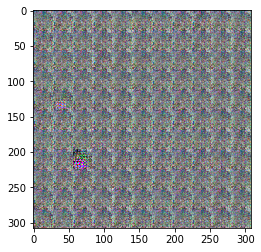

Epoch: 3/16 Discriminator Loss: 0.0015 Generator Loss: 6.6368
Epoch: 3/16 Discriminator Loss: 0.0006 Generator Loss: 7.5039
Epoch: 3/16 Discriminator Loss: 0.0015 Generator Loss: 6.6418
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.1794
Epoch: 3/16 Discriminator Loss: 0.0022 Generator Loss: 6.3820
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 7.0399
Epoch: 3/16 Discriminator Loss: 0.0035 Generator Loss: 5.9561
Epoch: 3/16 Discriminator Loss: 0.0040 Generator Loss: 5.8443
Epoch: 3/16 Discriminator Loss: 0.0034 Generator Loss: 6.0189
Epoch: 3/16 Discriminator Loss: 0.0034 Generator Loss: 6.0015


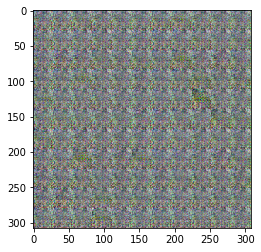

Epoch: 3/16 Discriminator Loss: 0.0018 Generator Loss: 6.6057
Epoch: 3/16 Discriminator Loss: 0.0028 Generator Loss: 6.1828
Epoch: 3/16 Discriminator Loss: 0.0006 Generator Loss: 7.9120
Epoch: 3/16 Discriminator Loss: 0.0013 Generator Loss: 6.9381
Epoch: 3/16 Discriminator Loss: 0.0015 Generator Loss: 6.7956
Epoch: 3/16 Discriminator Loss: 0.0021 Generator Loss: 6.3547
Epoch: 3/16 Discriminator Loss: 0.0016 Generator Loss: 6.6159
Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.3031
Epoch: 3/16 Discriminator Loss: 0.0010 Generator Loss: 7.1046
Epoch: 3/16 Discriminator Loss: 0.0018 Generator Loss: 6.5441


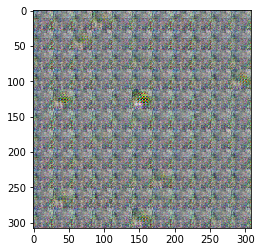

Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.8608
Epoch: 3/16 Discriminator Loss: 0.0020 Generator Loss: 6.3234
Epoch: 3/16 Discriminator Loss: 0.0017 Generator Loss: 6.5231
Epoch: 3/16 Discriminator Loss: 0.0011 Generator Loss: 6.9862
Epoch: 3/16 Discriminator Loss: 0.0006 Generator Loss: 7.6261
Epoch: 3/16 Discriminator Loss: 0.0004 Generator Loss: 8.0350
Epoch: 3/16 Discriminator Loss: 0.0015 Generator Loss: 6.7264
Epoch: 3/16 Discriminator Loss: 0.0012 Generator Loss: 6.9304
Epoch: 3/16 Discriminator Loss: 0.0011 Generator Loss: 6.9084
Epoch: 3/16 Discriminator Loss: 0.0003 Generator Loss: 8.4843


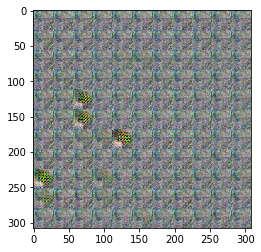

Epoch: 3/16 Discriminator Loss: 0.0007 Generator Loss: 7.4094
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.9284
Epoch: 3/16 Discriminator Loss: 0.0011 Generator Loss: 6.9092
Epoch: 3/16 Discriminator Loss: 0.0007 Generator Loss: 7.4196
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.1456
Epoch: 3/16 Discriminator Loss: 0.0009 Generator Loss: 7.1860
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.7434
Epoch: 3/16 Discriminator Loss: 0.0006 Generator Loss: 7.6652
Epoch: 3/16 Discriminator Loss: 0.0004 Generator Loss: 7.9613
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.7828


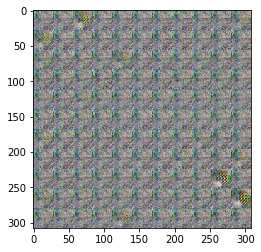

Epoch: 3/16 Discriminator Loss: 0.0007 Generator Loss: 7.4578
Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.1909
Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.2268
Epoch: 3/16 Discriminator Loss: 0.0004 Generator Loss: 7.9834
Epoch: 3/16 Discriminator Loss: 0.0004 Generator Loss: 8.0183
Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.3007
Epoch: 3/16 Discriminator Loss: 0.0003 Generator Loss: 8.4379
Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.2052
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.9439
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.6842


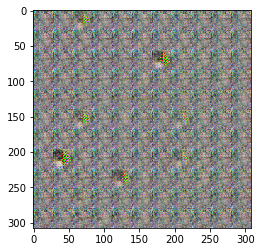

Epoch: 3/16 Discriminator Loss: 0.0008 Generator Loss: 7.3190
Epoch: 3/16 Discriminator Loss: 0.0005 Generator Loss: 7.7880
Epoch: 3/16 Discriminator Loss: 0.0004 Generator Loss: 7.9655
Epoch: 3/16 Discriminator Loss: 0.0006 Generator Loss: 7.6094
Epoch: 4/16 Discriminator Loss: 0.0009 Generator Loss: 7.0956
Epoch: 4/16 Discriminator Loss: 0.0008 Generator Loss: 7.3296
Epoch: 4/16 Discriminator Loss: 0.0008 Generator Loss: 7.2780
Epoch: 4/16 Discriminator Loss: 0.0007 Generator Loss: 7.5887
Epoch: 4/16 Discriminator Loss: 0.0001 Generator Loss: 9.0856
Epoch: 4/16 Discriminator Loss: 0.0007 Generator Loss: 7.4819


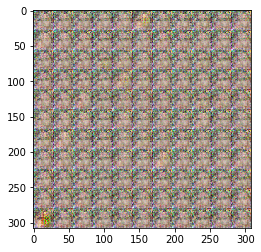

Epoch: 4/16 Discriminator Loss: 0.0001 Generator Loss: 16.2399
Epoch: 4/16 Discriminator Loss: 0.0002 Generator Loss: 9.9453
Epoch: 4/16 Discriminator Loss: 0.0020 Generator Loss: 19.2708
Epoch: 4/16 Discriminator Loss: 0.0009 Generator Loss: 13.1122
Epoch: 4/16 Discriminator Loss: 0.0013 Generator Loss: 19.4901
Epoch: 4/16 Discriminator Loss: 0.0009 Generator Loss: 11.3437
Epoch: 4/16 Discriminator Loss: 0.0004 Generator Loss: 10.7412
Epoch: 4/16 Discriminator Loss: 0.0002 Generator Loss: 10.3354
Epoch: 4/16 Discriminator Loss: 0.0009 Generator Loss: 19.5475
Epoch: 4/16 Discriminator Loss: 0.0003 Generator Loss: 12.1727


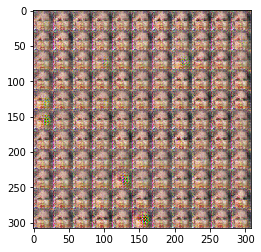

Epoch: 4/16 Discriminator Loss: 0.0002 Generator Loss: 9.5273
Epoch: 4/16 Discriminator Loss: 0.0003 Generator Loss: 9.2035
Epoch: 4/16 Discriminator Loss: 0.0003 Generator Loss: 9.6204
Epoch: 4/16 Discriminator Loss: 0.0003 Generator Loss: 8.6337
Epoch: 4/16 Discriminator Loss: 0.0001 Generator Loss: 19.7371
Epoch: 4/16 Discriminator Loss: 0.0003 Generator Loss: 9.8304
Epoch: 4/16 Discriminator Loss: 22.6454 Generator Loss: 31.0033
Epoch: 4/16 Discriminator Loss: 0.0548 Generator Loss: 7.7939
Epoch: 4/16 Discriminator Loss: 0.0300 Generator Loss: 3.8146
Epoch: 4/16 Discriminator Loss: 0.0594 Generator Loss: 3.4041


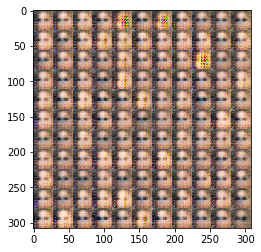

Epoch: 4/16 Discriminator Loss: 0.3082 Generator Loss: 4.6821
Epoch: 4/16 Discriminator Loss: 0.2119 Generator Loss: 5.6046
Epoch: 4/16 Discriminator Loss: 0.2834 Generator Loss: 5.2787
Epoch: 4/16 Discriminator Loss: 0.0584 Generator Loss: 3.2156
Epoch: 4/16 Discriminator Loss: 0.0542 Generator Loss: 3.2311
Epoch: 4/16 Discriminator Loss: 0.0793 Generator Loss: 3.0039
Epoch: 4/16 Discriminator Loss: 0.0155 Generator Loss: 5.2040
Epoch: 4/16 Discriminator Loss: 0.3404 Generator Loss: 8.6370
Epoch: 4/16 Discriminator Loss: 0.0135 Generator Loss: 7.4444
Epoch: 4/16 Discriminator Loss: 0.0850 Generator Loss: 2.7881


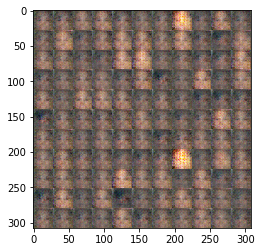

Epoch: 4/16 Discriminator Loss: 0.0456 Generator Loss: 8.7829
Epoch: 4/16 Discriminator Loss: 0.0104 Generator Loss: 4.9354
Epoch: 4/16 Discriminator Loss: 0.0578 Generator Loss: 3.2431
Epoch: 4/16 Discriminator Loss: 0.0265 Generator Loss: 10.5086
Epoch: 4/16 Discriminator Loss: 0.0054 Generator Loss: 6.4042
Epoch: 4/16 Discriminator Loss: 0.1865 Generator Loss: 3.5214
Epoch: 4/16 Discriminator Loss: 0.0051 Generator Loss: 6.8349
Epoch: 4/16 Discriminator Loss: 0.0057 Generator Loss: 5.5824
Epoch: 4/16 Discriminator Loss: 0.0455 Generator Loss: 8.8825
Epoch: 4/16 Discriminator Loss: 0.0105 Generator Loss: 5.8112


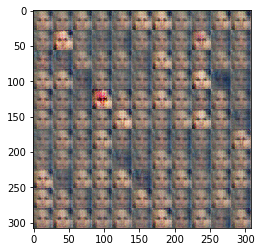

Epoch: 4/16 Discriminator Loss: 0.0057 Generator Loss: 9.8662
Epoch: 4/16 Discriminator Loss: 0.0809 Generator Loss: 2.8931
Epoch: 4/16 Discriminator Loss: 0.0091 Generator Loss: 6.4498
Epoch: 4/16 Discriminator Loss: 0.6634 Generator Loss: 0.7641
Epoch: 4/16 Discriminator Loss: 0.0154 Generator Loss: 4.6229
Epoch: 4/16 Discriminator Loss: 0.0191 Generator Loss: 4.1265
Epoch: 4/16 Discriminator Loss: 0.0391 Generator Loss: 5.3916
Epoch: 4/16 Discriminator Loss: 0.1013 Generator Loss: 8.0560
Epoch: 4/16 Discriminator Loss: 0.0737 Generator Loss: 4.2875
Epoch: 4/16 Discriminator Loss: 0.0025 Generator Loss: 8.0283


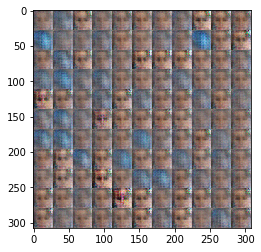

Epoch: 4/16 Discriminator Loss: 0.0081 Generator Loss: 9.8222
Epoch: 4/16 Discriminator Loss: 0.0102 Generator Loss: 9.4333
Epoch: 4/16 Discriminator Loss: 0.0099 Generator Loss: 7.0490
Epoch: 4/16 Discriminator Loss: 0.0088 Generator Loss: 13.2914
Epoch: 4/16 Discriminator Loss: 0.3575 Generator Loss: 1.4481
Epoch: 4/16 Discriminator Loss: 0.0208 Generator Loss: 6.1583
Epoch: 4/16 Discriminator Loss: 0.0081 Generator Loss: 6.5166
Epoch: 4/16 Discriminator Loss: 0.0044 Generator Loss: 12.1351
Epoch: 4/16 Discriminator Loss: 0.0114 Generator Loss: 4.9373
Epoch: 4/16 Discriminator Loss: 0.2307 Generator Loss: 9.9672


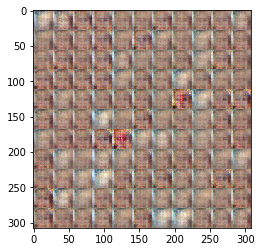

Epoch: 4/16 Discriminator Loss: 0.0084 Generator Loss: 5.6395
Epoch: 4/16 Discriminator Loss: 0.0010 Generator Loss: 13.7846
Epoch: 4/16 Discriminator Loss: 0.0009 Generator Loss: 10.2737
Epoch: 4/16 Discriminator Loss: 0.0050 Generator Loss: 9.2929
Epoch: 4/16 Discriminator Loss: 0.0033 Generator Loss: 12.2756
Epoch: 4/16 Discriminator Loss: 0.0035 Generator Loss: 6.2812
Epoch: 4/16 Discriminator Loss: 0.0022 Generator Loss: 9.3233
Epoch: 4/16 Discriminator Loss: 0.0153 Generator Loss: 5.4962
Epoch: 4/16 Discriminator Loss: 0.0221 Generator Loss: 5.1946
Epoch: 4/16 Discriminator Loss: 7.8489 Generator Loss: 11.7766


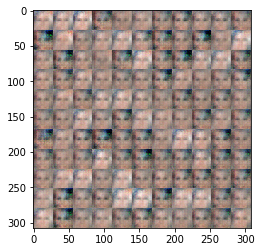

Epoch: 4/16 Discriminator Loss: 0.1177 Generator Loss: 10.5305
Epoch: 4/16 Discriminator Loss: 0.4435 Generator Loss: 1.2034
Epoch: 4/16 Discriminator Loss: 0.0115 Generator Loss: 9.8909
Epoch: 4/16 Discriminator Loss: 0.0715 Generator Loss: 6.4220
Epoch: 4/16 Discriminator Loss: 0.6084 Generator Loss: 9.1481
Epoch: 4/16 Discriminator Loss: 0.0248 Generator Loss: 8.5669
Epoch: 4/16 Discriminator Loss: 0.0061 Generator Loss: 10.4636
Epoch: 4/16 Discriminator Loss: 0.1947 Generator Loss: 2.8124
Epoch: 4/16 Discriminator Loss: 0.0100 Generator Loss: 11.0633
Epoch: 4/16 Discriminator Loss: 0.0415 Generator Loss: 8.4209


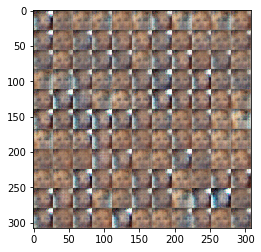

Epoch: 4/16 Discriminator Loss: 5.2529 Generator Loss: 14.2121
Epoch: 4/16 Discriminator Loss: 0.0484 Generator Loss: 3.5003
Epoch: 4/16 Discriminator Loss: 0.0532 Generator Loss: 3.4577
Epoch: 4/16 Discriminator Loss: 0.0480 Generator Loss: 11.0538
Epoch: 4/16 Discriminator Loss: 0.0285 Generator Loss: 4.1871
Epoch: 4/16 Discriminator Loss: 1.0057 Generator Loss: 0.5309
Epoch: 4/16 Discriminator Loss: 0.0088 Generator Loss: 8.7361
Epoch: 4/16 Discriminator Loss: 0.7740 Generator Loss: 0.7342
Epoch: 4/16 Discriminator Loss: 0.4053 Generator Loss: 2.6278
Epoch: 4/16 Discriminator Loss: 0.1555 Generator Loss: 6.4155


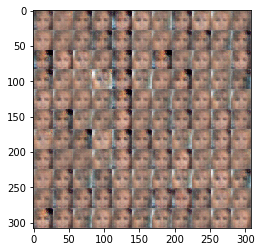

Epoch: 4/16 Discriminator Loss: 0.3954 Generator Loss: 1.5295
Epoch: 4/16 Discriminator Loss: 0.0304 Generator Loss: 4.8405
Epoch: 4/16 Discriminator Loss: 0.2719 Generator Loss: 1.6898
Epoch: 4/16 Discriminator Loss: 0.0324 Generator Loss: 6.2950
Epoch: 4/16 Discriminator Loss: 0.0732 Generator Loss: 8.6795
Epoch: 4/16 Discriminator Loss: 0.9200 Generator Loss: 7.9813
Epoch: 4/16 Discriminator Loss: 0.0157 Generator Loss: 9.5386
Epoch: 4/16 Discriminator Loss: 0.7465 Generator Loss: 9.0039
Epoch: 4/16 Discriminator Loss: 0.2574 Generator Loss: 9.2460
Epoch: 4/16 Discriminator Loss: 0.0619 Generator Loss: 5.1310


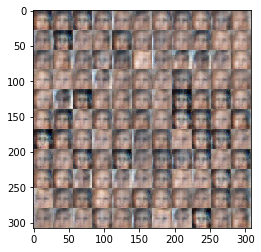

Epoch: 4/16 Discriminator Loss: 0.0406 Generator Loss: 5.7251
Epoch: 4/16 Discriminator Loss: 0.0296 Generator Loss: 4.8987
Epoch: 4/16 Discriminator Loss: 1.2753 Generator Loss: 0.4503
Epoch: 4/16 Discriminator Loss: 0.0199 Generator Loss: 10.5516
Epoch: 4/16 Discriminator Loss: 0.0186 Generator Loss: 8.1701
Epoch: 4/16 Discriminator Loss: 0.0226 Generator Loss: 10.8983
Epoch: 4/16 Discriminator Loss: 0.0360 Generator Loss: 4.7567
Epoch: 4/16 Discriminator Loss: 0.0217 Generator Loss: 5.2685
Epoch: 4/16 Discriminator Loss: 0.5942 Generator Loss: 1.0313
Epoch: 4/16 Discriminator Loss: 0.3003 Generator Loss: 5.0862


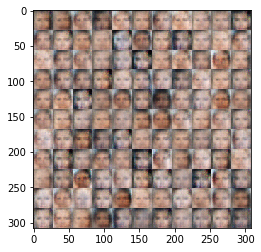

Epoch: 4/16 Discriminator Loss: 0.0084 Generator Loss: 9.2623
Epoch: 4/16 Discriminator Loss: 0.4190 Generator Loss: 1.1983
Epoch: 4/16 Discriminator Loss: 0.0488 Generator Loss: 3.4600
Epoch: 4/16 Discriminator Loss: 0.0326 Generator Loss: 10.7528
Epoch: 4/16 Discriminator Loss: 0.0350 Generator Loss: 9.6531
Epoch: 4/16 Discriminator Loss: 0.0032 Generator Loss: 11.3983
Epoch: 4/16 Discriminator Loss: 0.0201 Generator Loss: 11.7985
Epoch: 4/16 Discriminator Loss: 0.0434 Generator Loss: 4.0404
Epoch: 4/16 Discriminator Loss: 0.0281 Generator Loss: 6.0406
Epoch: 4/16 Discriminator Loss: 0.0023 Generator Loss: 11.0525


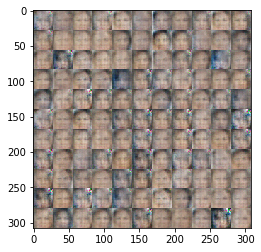

Epoch: 4/16 Discriminator Loss: 0.0281 Generator Loss: 4.1436
Epoch: 4/16 Discriminator Loss: 0.0023 Generator Loss: 9.9050
Epoch: 4/16 Discriminator Loss: 0.0391 Generator Loss: 11.9501
Epoch: 4/16 Discriminator Loss: 0.0059 Generator Loss: 10.1402
Epoch: 4/16 Discriminator Loss: 0.0163 Generator Loss: 13.1766
Epoch: 4/16 Discriminator Loss: 0.3358 Generator Loss: 1.6948
Epoch: 4/16 Discriminator Loss: 0.0626 Generator Loss: 10.0544
Epoch: 4/16 Discriminator Loss: 3.8013 Generator Loss: 8.2077
Epoch: 4/16 Discriminator Loss: 0.0649 Generator Loss: 10.9724
Epoch: 4/16 Discriminator Loss: 0.5069 Generator Loss: 1.0491


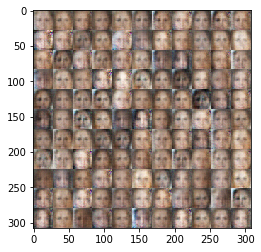

Epoch: 4/16 Discriminator Loss: 0.1708 Generator Loss: 2.7675
Epoch: 4/16 Discriminator Loss: 0.0361 Generator Loss: 6.2841
Epoch: 4/16 Discriminator Loss: 0.0020 Generator Loss: 9.2825
Epoch: 4/16 Discriminator Loss: 1.4310 Generator Loss: 10.1700
Epoch: 4/16 Discriminator Loss: 0.2056 Generator Loss: 9.4463
Epoch: 4/16 Discriminator Loss: 0.0112 Generator Loss: 7.2422
Epoch: 4/16 Discriminator Loss: 0.0050 Generator Loss: 13.5216
Epoch: 4/16 Discriminator Loss: 0.0014 Generator Loss: 10.7830
Epoch: 4/16 Discriminator Loss: 0.0035 Generator Loss: 8.6137
Epoch: 4/16 Discriminator Loss: 0.5346 Generator Loss: 1.0485


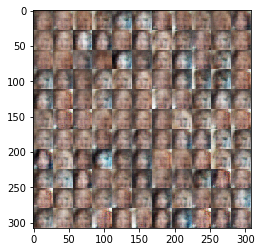

Epoch: 4/16 Discriminator Loss: 0.0097 Generator Loss: 7.9646
Epoch: 4/16 Discriminator Loss: 0.0130 Generator Loss: 11.4468
Epoch: 4/16 Discriminator Loss: 0.0501 Generator Loss: 4.0668
Epoch: 4/16 Discriminator Loss: 0.0738 Generator Loss: 8.2750
Epoch: 4/16 Discriminator Loss: 0.0036 Generator Loss: 7.6420
Epoch: 4/16 Discriminator Loss: 0.0847 Generator Loss: 2.7368
Epoch: 4/16 Discriminator Loss: 0.0053 Generator Loss: 10.2303
Epoch: 4/16 Discriminator Loss: 0.0291 Generator Loss: 9.8601
Epoch: 4/16 Discriminator Loss: 0.0190 Generator Loss: 5.5132
Epoch: 4/16 Discriminator Loss: 0.0155 Generator Loss: 11.6622


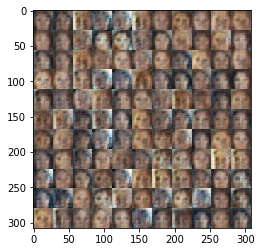

Epoch: 4/16 Discriminator Loss: 0.0180 Generator Loss: 5.4641
Epoch: 4/16 Discriminator Loss: 0.0641 Generator Loss: 4.0049
Epoch: 5/16 Discriminator Loss: 0.1639 Generator Loss: 2.9200
Epoch: 5/16 Discriminator Loss: 0.0124 Generator Loss: 11.4623
Epoch: 5/16 Discriminator Loss: 0.0178 Generator Loss: 7.9085
Epoch: 5/16 Discriminator Loss: 0.0686 Generator Loss: 6.8710
Epoch: 5/16 Discriminator Loss: 0.0120 Generator Loss: 5.3140
Epoch: 5/16 Discriminator Loss: 0.0315 Generator Loss: 10.3447
Epoch: 5/16 Discriminator Loss: 0.0065 Generator Loss: 7.5265
Epoch: 5/16 Discriminator Loss: 0.1377 Generator Loss: 2.5402


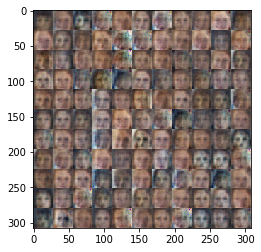

Epoch: 5/16 Discriminator Loss: 0.0176 Generator Loss: 11.0388
Epoch: 5/16 Discriminator Loss: 1.8905 Generator Loss: 0.2331
Epoch: 5/16 Discriminator Loss: 0.0163 Generator Loss: 5.4159
Epoch: 5/16 Discriminator Loss: 0.0348 Generator Loss: 5.0408
Epoch: 5/16 Discriminator Loss: 0.0368 Generator Loss: 11.6841
Epoch: 5/16 Discriminator Loss: 0.0409 Generator Loss: 5.6559
Epoch: 5/16 Discriminator Loss: 0.0626 Generator Loss: 3.4703
Epoch: 5/16 Discriminator Loss: 0.0648 Generator Loss: 4.1968
Epoch: 5/16 Discriminator Loss: 0.3919 Generator Loss: 1.6306
Epoch: 5/16 Discriminator Loss: 1.1782 Generator Loss: 0.4810


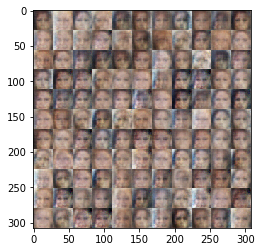

Epoch: 5/16 Discriminator Loss: 0.0325 Generator Loss: 7.3906
Epoch: 5/16 Discriminator Loss: 0.2069 Generator Loss: 3.2760
Epoch: 5/16 Discriminator Loss: 0.0648 Generator Loss: 4.1995
Epoch: 5/16 Discriminator Loss: 0.0276 Generator Loss: 6.4314
Epoch: 5/16 Discriminator Loss: 0.1913 Generator Loss: 2.3685
Epoch: 5/16 Discriminator Loss: 0.2685 Generator Loss: 2.1479
Epoch: 5/16 Discriminator Loss: 0.0176 Generator Loss: 8.3166
Epoch: 5/16 Discriminator Loss: 0.0501 Generator Loss: 6.2207
Epoch: 5/16 Discriminator Loss: 0.6182 Generator Loss: 0.9444
Epoch: 5/16 Discriminator Loss: 0.0890 Generator Loss: 8.3355


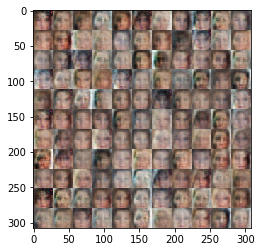

Epoch: 5/16 Discriminator Loss: 0.0505 Generator Loss: 3.8483
Epoch: 5/16 Discriminator Loss: 0.1753 Generator Loss: 11.7422
Epoch: 5/16 Discriminator Loss: 0.0275 Generator Loss: 5.2114
Epoch: 5/16 Discriminator Loss: 0.2059 Generator Loss: 2.1880
Epoch: 5/16 Discriminator Loss: 0.0499 Generator Loss: 3.9352
Epoch: 5/16 Discriminator Loss: 0.9087 Generator Loss: 0.6338
Epoch: 5/16 Discriminator Loss: 0.0095 Generator Loss: 7.8750
Epoch: 5/16 Discriminator Loss: 0.0501 Generator Loss: 3.6638
Epoch: 5/16 Discriminator Loss: 0.0179 Generator Loss: 7.6840
Epoch: 5/16 Discriminator Loss: 0.1545 Generator Loss: 3.3299


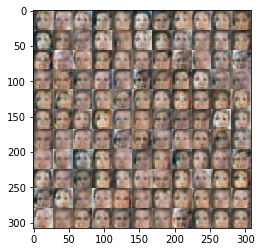

Epoch: 5/16 Discriminator Loss: 0.0636 Generator Loss: 3.4594
Epoch: 5/16 Discriminator Loss: 1.6483 Generator Loss: 0.3440
Epoch: 5/16 Discriminator Loss: 0.0625 Generator Loss: 4.5144
Epoch: 5/16 Discriminator Loss: 0.0569 Generator Loss: 7.9313
Epoch: 5/16 Discriminator Loss: 0.0189 Generator Loss: 9.4594
Epoch: 5/16 Discriminator Loss: 0.4444 Generator Loss: 8.2836
Epoch: 5/16 Discriminator Loss: 0.1443 Generator Loss: 2.7576
Epoch: 5/16 Discriminator Loss: 0.2943 Generator Loss: 1.9923
Epoch: 5/16 Discriminator Loss: 0.1774 Generator Loss: 2.4107
Epoch: 5/16 Discriminator Loss: 0.0331 Generator Loss: 8.2303


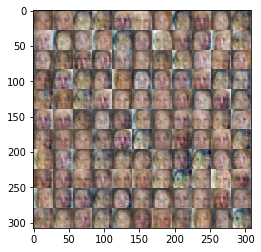

Epoch: 5/16 Discriminator Loss: 0.0386 Generator Loss: 5.0847
Epoch: 5/16 Discriminator Loss: 0.0863 Generator Loss: 8.9298
Epoch: 5/16 Discriminator Loss: 0.0539 Generator Loss: 12.1765
Epoch: 5/16 Discriminator Loss: 0.0953 Generator Loss: 3.3391
Epoch: 5/16 Discriminator Loss: 0.8223 Generator Loss: 12.5765
Epoch: 5/16 Discriminator Loss: 0.2159 Generator Loss: 11.0870
Epoch: 5/16 Discriminator Loss: 0.1034 Generator Loss: 6.2349
Epoch: 5/16 Discriminator Loss: 0.0449 Generator Loss: 5.4319
Epoch: 5/16 Discriminator Loss: 0.6726 Generator Loss: 1.1539
Epoch: 5/16 Discriminator Loss: 1.6089 Generator Loss: 8.1176


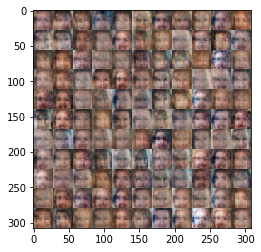

Epoch: 5/16 Discriminator Loss: 0.3278 Generator Loss: 1.7944
Epoch: 5/16 Discriminator Loss: 0.0758 Generator Loss: 7.3274
Epoch: 5/16 Discriminator Loss: 0.5959 Generator Loss: 0.9735
Epoch: 5/16 Discriminator Loss: 0.1140 Generator Loss: 3.1181
Epoch: 5/16 Discriminator Loss: 0.2454 Generator Loss: 2.2521
Epoch: 5/16 Discriminator Loss: 0.0461 Generator Loss: 10.5575
Epoch: 5/16 Discriminator Loss: 0.0938 Generator Loss: 4.8034
Epoch: 5/16 Discriminator Loss: 0.0680 Generator Loss: 6.5713
Epoch: 5/16 Discriminator Loss: 0.3627 Generator Loss: 1.7636
Epoch: 5/16 Discriminator Loss: 0.0190 Generator Loss: 6.1493


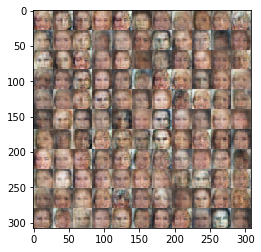

Epoch: 5/16 Discriminator Loss: 0.0057 Generator Loss: 8.9509
Epoch: 5/16 Discriminator Loss: 0.0446 Generator Loss: 6.5718
Epoch: 5/16 Discriminator Loss: 0.2559 Generator Loss: 2.3695
Epoch: 5/16 Discriminator Loss: 0.0180 Generator Loss: 6.2415
Epoch: 5/16 Discriminator Loss: 0.2625 Generator Loss: 1.9847
Epoch: 5/16 Discriminator Loss: 1.3819 Generator Loss: 0.3736
Epoch: 5/16 Discriminator Loss: 0.2009 Generator Loss: 2.7285
Epoch: 5/16 Discriminator Loss: 0.1854 Generator Loss: 5.4986
Epoch: 5/16 Discriminator Loss: 0.1404 Generator Loss: 5.1588
Epoch: 5/16 Discriminator Loss: 0.0262 Generator Loss: 5.3761


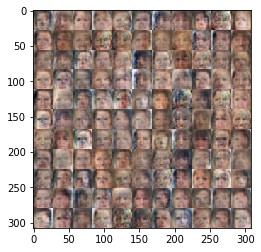

Epoch: 5/16 Discriminator Loss: 0.0456 Generator Loss: 6.5741
Epoch: 5/16 Discriminator Loss: 1.0206 Generator Loss: 4.8351
Epoch: 5/16 Discriminator Loss: 0.1716 Generator Loss: 2.9243
Epoch: 5/16 Discriminator Loss: 0.0769 Generator Loss: 10.2503
Epoch: 5/16 Discriminator Loss: 0.0972 Generator Loss: 8.3850
Epoch: 5/16 Discriminator Loss: 0.0626 Generator Loss: 9.7402
Epoch: 5/16 Discriminator Loss: 0.2131 Generator Loss: 7.5710
Epoch: 5/16 Discriminator Loss: 0.0217 Generator Loss: 6.2993
Epoch: 5/16 Discriminator Loss: 0.0386 Generator Loss: 7.4283
Epoch: 5/16 Discriminator Loss: 0.0407 Generator Loss: 6.2156


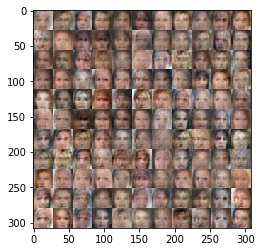

Epoch: 5/16 Discriminator Loss: 0.1261 Generator Loss: 6.0452
Epoch: 5/16 Discriminator Loss: 0.0900 Generator Loss: 4.1855
Epoch: 5/16 Discriminator Loss: 1.3115 Generator Loss: 0.4121
Epoch: 5/16 Discriminator Loss: 0.1638 Generator Loss: 2.6563
Epoch: 5/16 Discriminator Loss: 0.1832 Generator Loss: 3.3742
Epoch: 5/16 Discriminator Loss: 0.1970 Generator Loss: 6.6518
Epoch: 5/16 Discriminator Loss: 0.1850 Generator Loss: 5.4941
Epoch: 5/16 Discriminator Loss: 0.0934 Generator Loss: 3.5031
Epoch: 5/16 Discriminator Loss: 0.1373 Generator Loss: 3.3173
Epoch: 5/16 Discriminator Loss: 0.0651 Generator Loss: 5.6300


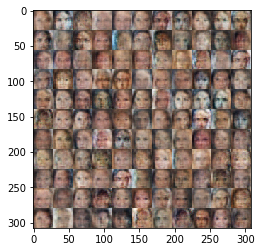

Epoch: 5/16 Discriminator Loss: 0.3168 Generator Loss: 5.5355
Epoch: 5/16 Discriminator Loss: 0.0563 Generator Loss: 5.5932
Epoch: 5/16 Discriminator Loss: 0.2632 Generator Loss: 5.7903
Epoch: 5/16 Discriminator Loss: 0.0654 Generator Loss: 5.3400
Epoch: 5/16 Discriminator Loss: 0.0945 Generator Loss: 3.4884
Epoch: 5/16 Discriminator Loss: 1.1762 Generator Loss: 0.6713
Epoch: 5/16 Discriminator Loss: 0.1506 Generator Loss: 2.7534
Epoch: 5/16 Discriminator Loss: 0.1042 Generator Loss: 4.7199
Epoch: 5/16 Discriminator Loss: 0.0578 Generator Loss: 6.6352
Epoch: 5/16 Discriminator Loss: 0.1164 Generator Loss: 3.6784


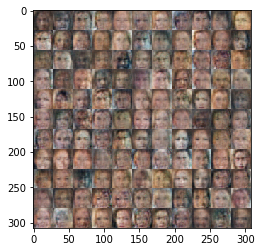

Epoch: 5/16 Discriminator Loss: 0.3088 Generator Loss: 4.4741
Epoch: 5/16 Discriminator Loss: 0.7131 Generator Loss: 1.0683
Epoch: 5/16 Discriminator Loss: 1.0355 Generator Loss: 0.6925
Epoch: 5/16 Discriminator Loss: 0.0654 Generator Loss: 4.6103
Epoch: 5/16 Discriminator Loss: 0.0897 Generator Loss: 4.3405
Epoch: 5/16 Discriminator Loss: 1.1526 Generator Loss: 0.5073
Epoch: 5/16 Discriminator Loss: 1.1697 Generator Loss: 8.3379
Epoch: 5/16 Discriminator Loss: 0.8530 Generator Loss: 7.0431
Epoch: 5/16 Discriminator Loss: 0.1476 Generator Loss: 5.2499
Epoch: 5/16 Discriminator Loss: 0.1313 Generator Loss: 4.6409


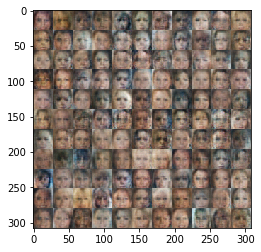

Epoch: 5/16 Discriminator Loss: 0.5287 Generator Loss: 10.3011
Epoch: 5/16 Discriminator Loss: 1.1260 Generator Loss: 0.7043
Epoch: 5/16 Discriminator Loss: 0.2774 Generator Loss: 1.9968
Epoch: 5/16 Discriminator Loss: 0.1857 Generator Loss: 2.7828
Epoch: 5/16 Discriminator Loss: 0.0966 Generator Loss: 5.6672
Epoch: 5/16 Discriminator Loss: 0.2006 Generator Loss: 3.1295
Epoch: 5/16 Discriminator Loss: 0.2060 Generator Loss: 2.4001
Epoch: 5/16 Discriminator Loss: 0.2468 Generator Loss: 2.0446
Epoch: 5/16 Discriminator Loss: 0.2271 Generator Loss: 2.8653
Epoch: 5/16 Discriminator Loss: 0.2795 Generator Loss: 2.7414


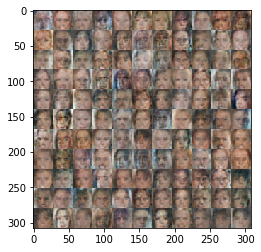

Epoch: 5/16 Discriminator Loss: 0.1452 Generator Loss: 3.3282
Epoch: 5/16 Discriminator Loss: 0.2039 Generator Loss: 3.2291
Epoch: 5/16 Discriminator Loss: 0.0533 Generator Loss: 3.9831
Epoch: 5/16 Discriminator Loss: 0.1643 Generator Loss: 2.7413
Epoch: 5/16 Discriminator Loss: 0.0976 Generator Loss: 3.1250
Epoch: 5/16 Discriminator Loss: 0.7010 Generator Loss: 1.0113
Epoch: 5/16 Discriminator Loss: 0.7455 Generator Loss: 0.9132
Epoch: 5/16 Discriminator Loss: 0.1321 Generator Loss: 3.8701
Epoch: 5/16 Discriminator Loss: 0.2951 Generator Loss: 2.0629
Epoch: 5/16 Discriminator Loss: 0.5504 Generator Loss: 1.1571


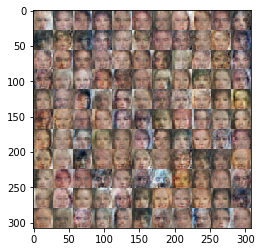

Epoch: 5/16 Discriminator Loss: 0.2326 Generator Loss: 3.0011
Epoch: 5/16 Discriminator Loss: 0.2427 Generator Loss: 3.4181
Epoch: 5/16 Discriminator Loss: 0.2113 Generator Loss: 2.3373
Epoch: 5/16 Discriminator Loss: 0.1219 Generator Loss: 3.7583
Epoch: 5/16 Discriminator Loss: 0.8910 Generator Loss: 5.8627
Epoch: 5/16 Discriminator Loss: 0.0878 Generator Loss: 3.4842
Epoch: 5/16 Discriminator Loss: 0.9220 Generator Loss: 0.8075
Epoch: 5/16 Discriminator Loss: 0.4231 Generator Loss: 1.5172
Epoch: 5/16 Discriminator Loss: 0.1680 Generator Loss: 2.7203
Epoch: 5/16 Discriminator Loss: 0.1536 Generator Loss: 4.5634


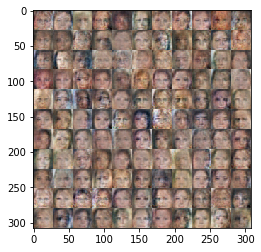

Epoch: 5/16 Discriminator Loss: 0.2331 Generator Loss: 3.0407
Epoch: 5/16 Discriminator Loss: 0.1909 Generator Loss: 5.2896
Epoch: 5/16 Discriminator Loss: 0.6444 Generator Loss: 10.2639
Epoch: 5/16 Discriminator Loss: 0.6042 Generator Loss: 8.2228
Epoch: 5/16 Discriminator Loss: 0.0873 Generator Loss: 4.3395
Epoch: 5/16 Discriminator Loss: 0.3110 Generator Loss: 6.4567
Epoch: 5/16 Discriminator Loss: 0.0468 Generator Loss: 5.5393
Epoch: 5/16 Discriminator Loss: 0.2503 Generator Loss: 3.5761
Epoch: 5/16 Discriminator Loss: 0.1374 Generator Loss: 4.2101
Epoch: 5/16 Discriminator Loss: 0.1291 Generator Loss: 3.5433


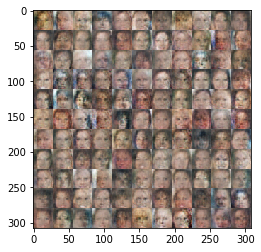

Epoch: 5/16 Discriminator Loss: 0.1663 Generator Loss: 5.0181
Epoch: 6/16 Discriminator Loss: 0.0976 Generator Loss: 6.4360
Epoch: 6/16 Discriminator Loss: 0.2561 Generator Loss: 2.3370
Epoch: 6/16 Discriminator Loss: 0.0854 Generator Loss: 3.9042
Epoch: 6/16 Discriminator Loss: 0.5457 Generator Loss: 3.8090
Epoch: 6/16 Discriminator Loss: 2.5033 Generator Loss: 4.7907
Epoch: 6/16 Discriminator Loss: 0.5115 Generator Loss: 1.3845
Epoch: 6/16 Discriminator Loss: 0.2211 Generator Loss: 3.3874
Epoch: 6/16 Discriminator Loss: 0.1072 Generator Loss: 6.0169
Epoch: 6/16 Discriminator Loss: 0.4635 Generator Loss: 1.3568


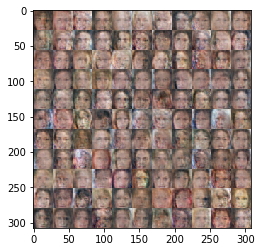

Epoch: 6/16 Discriminator Loss: 0.3511 Generator Loss: 2.2044
Epoch: 6/16 Discriminator Loss: 0.5563 Generator Loss: 5.3700
Epoch: 6/16 Discriminator Loss: 1.0909 Generator Loss: 6.2034
Epoch: 6/16 Discriminator Loss: 0.4852 Generator Loss: 2.3531
Epoch: 6/16 Discriminator Loss: 0.6173 Generator Loss: 1.2258
Epoch: 6/16 Discriminator Loss: 0.3484 Generator Loss: 1.8825
Epoch: 6/16 Discriminator Loss: 0.0986 Generator Loss: 5.7561
Epoch: 6/16 Discriminator Loss: 0.1909 Generator Loss: 2.9436
Epoch: 6/16 Discriminator Loss: 0.2187 Generator Loss: 2.4402
Epoch: 6/16 Discriminator Loss: 0.2668 Generator Loss: 4.1051


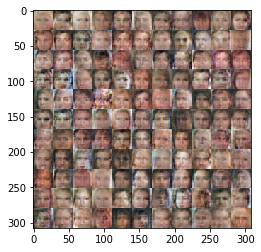

Epoch: 6/16 Discriminator Loss: 0.6851 Generator Loss: 3.8592
Epoch: 6/16 Discriminator Loss: 0.2082 Generator Loss: 3.3988
Epoch: 6/16 Discriminator Loss: 0.1575 Generator Loss: 6.1465
Epoch: 6/16 Discriminator Loss: 0.3372 Generator Loss: 2.1119
Epoch: 6/16 Discriminator Loss: 0.2770 Generator Loss: 2.6877
Epoch: 6/16 Discriminator Loss: 0.1435 Generator Loss: 3.1528
Epoch: 6/16 Discriminator Loss: 0.0756 Generator Loss: 3.7395
Epoch: 6/16 Discriminator Loss: 0.1383 Generator Loss: 5.4593
Epoch: 6/16 Discriminator Loss: 0.4712 Generator Loss: 1.4214
Epoch: 6/16 Discriminator Loss: 1.2531 Generator Loss: 0.4936


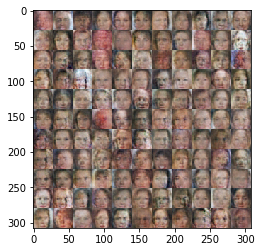

Epoch: 6/16 Discriminator Loss: 0.3695 Generator Loss: 1.6758
Epoch: 6/16 Discriminator Loss: 0.7240 Generator Loss: 0.9566
Epoch: 6/16 Discriminator Loss: 0.2659 Generator Loss: 2.5713
Epoch: 6/16 Discriminator Loss: 0.1688 Generator Loss: 2.9272
Epoch: 6/16 Discriminator Loss: 0.2779 Generator Loss: 1.9845
Epoch: 6/16 Discriminator Loss: 0.1425 Generator Loss: 3.6919
Epoch: 6/16 Discriminator Loss: 0.1618 Generator Loss: 5.9256
Epoch: 6/16 Discriminator Loss: 0.4188 Generator Loss: 1.4541
Epoch: 6/16 Discriminator Loss: 0.1764 Generator Loss: 3.0742
Epoch: 6/16 Discriminator Loss: 0.3137 Generator Loss: 1.8673


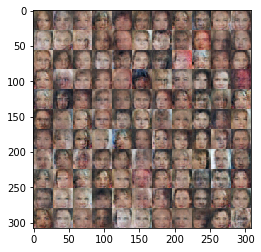

Epoch: 6/16 Discriminator Loss: 0.2160 Generator Loss: 3.7007
Epoch: 6/16 Discriminator Loss: 0.4178 Generator Loss: 1.5412
Epoch: 6/16 Discriminator Loss: 0.3021 Generator Loss: 1.9056
Epoch: 6/16 Discriminator Loss: 0.1792 Generator Loss: 3.7274
Epoch: 6/16 Discriminator Loss: 0.8886 Generator Loss: 0.7994
Epoch: 6/16 Discriminator Loss: 0.3812 Generator Loss: 2.4692
Epoch: 6/16 Discriminator Loss: 0.4216 Generator Loss: 1.7244
Epoch: 6/16 Discriminator Loss: 0.3848 Generator Loss: 2.0019
Epoch: 6/16 Discriminator Loss: 0.2244 Generator Loss: 3.3295
Epoch: 6/16 Discriminator Loss: 0.3683 Generator Loss: 3.7683


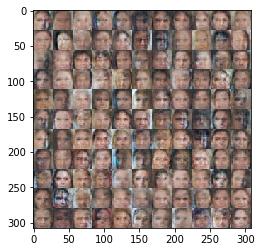

Epoch: 6/16 Discriminator Loss: 0.1939 Generator Loss: 3.5568
Epoch: 6/16 Discriminator Loss: 0.3091 Generator Loss: 1.9845
Epoch: 6/16 Discriminator Loss: 1.0533 Generator Loss: 4.5392
Epoch: 6/16 Discriminator Loss: 0.3199 Generator Loss: 1.8582
Epoch: 6/16 Discriminator Loss: 0.1435 Generator Loss: 2.7705
Epoch: 6/16 Discriminator Loss: 0.2633 Generator Loss: 1.9047
Epoch: 6/16 Discriminator Loss: 0.1566 Generator Loss: 3.0344
Epoch: 6/16 Discriminator Loss: 0.1383 Generator Loss: 6.8408
Epoch: 6/16 Discriminator Loss: 0.2788 Generator Loss: 2.2312
Epoch: 6/16 Discriminator Loss: 0.0610 Generator Loss: 6.0578


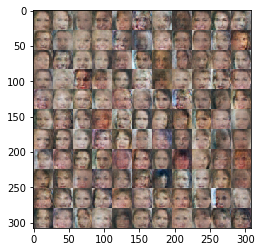

Epoch: 6/16 Discriminator Loss: 0.5095 Generator Loss: 1.4268
Epoch: 6/16 Discriminator Loss: 0.1088 Generator Loss: 4.0348
Epoch: 6/16 Discriminator Loss: 0.6431 Generator Loss: 4.0493
Epoch: 6/16 Discriminator Loss: 0.3675 Generator Loss: 1.8216
Epoch: 6/16 Discriminator Loss: 0.1669 Generator Loss: 3.2648
Epoch: 6/16 Discriminator Loss: 0.0481 Generator Loss: 6.6426
Epoch: 6/16 Discriminator Loss: 0.2627 Generator Loss: 2.0758
Epoch: 6/16 Discriminator Loss: 0.0924 Generator Loss: 4.5456
Epoch: 6/16 Discriminator Loss: 0.3695 Generator Loss: 1.8085
Epoch: 6/16 Discriminator Loss: 5.9279 Generator Loss: 8.7814


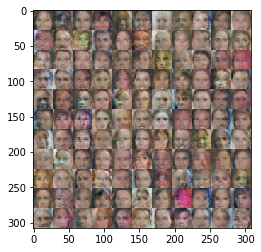

Epoch: 6/16 Discriminator Loss: 0.5215 Generator Loss: 2.0687
Epoch: 6/16 Discriminator Loss: 0.1478 Generator Loss: 4.2996
Epoch: 6/16 Discriminator Loss: 0.4210 Generator Loss: 1.6328
Epoch: 6/16 Discriminator Loss: 0.4504 Generator Loss: 3.1518
Epoch: 6/16 Discriminator Loss: 0.2200 Generator Loss: 2.3151
Epoch: 6/16 Discriminator Loss: 0.2990 Generator Loss: 1.8753
Epoch: 6/16 Discriminator Loss: 0.2401 Generator Loss: 2.7400
Epoch: 6/16 Discriminator Loss: 0.3564 Generator Loss: 1.9844
Epoch: 6/16 Discriminator Loss: 0.3263 Generator Loss: 1.8872
Epoch: 6/16 Discriminator Loss: 0.5214 Generator Loss: 1.2600


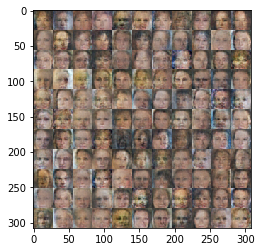

Epoch: 6/16 Discriminator Loss: 0.2884 Generator Loss: 2.3907
Epoch: 6/16 Discriminator Loss: 0.2855 Generator Loss: 2.0504
Epoch: 6/16 Discriminator Loss: 0.2505 Generator Loss: 2.7841
Epoch: 6/16 Discriminator Loss: 0.2100 Generator Loss: 4.1706
Epoch: 6/16 Discriminator Loss: 0.7808 Generator Loss: 0.9696
Epoch: 6/16 Discriminator Loss: 0.9129 Generator Loss: 0.8098
Epoch: 6/16 Discriminator Loss: 0.3450 Generator Loss: 2.9198
Epoch: 6/16 Discriminator Loss: 0.4358 Generator Loss: 2.8972
Epoch: 6/16 Discriminator Loss: 0.2291 Generator Loss: 3.3173
Epoch: 6/16 Discriminator Loss: 0.4091 Generator Loss: 1.9653


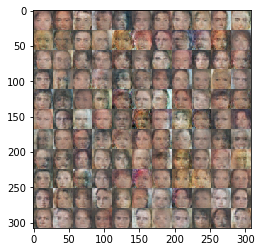

Epoch: 6/16 Discriminator Loss: 0.4388 Generator Loss: 1.6515
Epoch: 6/16 Discriminator Loss: 0.3194 Generator Loss: 1.8977
Epoch: 6/16 Discriminator Loss: 0.1684 Generator Loss: 2.9801
Epoch: 6/16 Discriminator Loss: 0.1548 Generator Loss: 3.6000
Epoch: 6/16 Discriminator Loss: 0.2024 Generator Loss: 3.7391
Epoch: 6/16 Discriminator Loss: 0.0710 Generator Loss: 4.7838
Epoch: 6/16 Discriminator Loss: 0.7167 Generator Loss: 0.9974
Epoch: 6/16 Discriminator Loss: 0.2746 Generator Loss: 2.4999
Epoch: 6/16 Discriminator Loss: 0.5050 Generator Loss: 1.4590
Epoch: 6/16 Discriminator Loss: 0.4394 Generator Loss: 1.8080


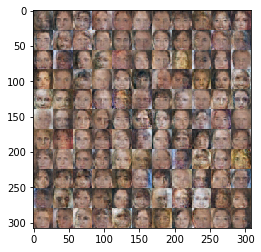

Epoch: 6/16 Discriminator Loss: 0.3507 Generator Loss: 2.3490
Epoch: 6/16 Discriminator Loss: 0.3381 Generator Loss: 1.7163
Epoch: 6/16 Discriminator Loss: 0.2628 Generator Loss: 2.1323
Epoch: 6/16 Discriminator Loss: 0.4653 Generator Loss: 1.4059
Epoch: 6/16 Discriminator Loss: 0.1221 Generator Loss: 5.4702
Epoch: 6/16 Discriminator Loss: 0.6142 Generator Loss: 1.1257
Epoch: 6/16 Discriminator Loss: 0.2181 Generator Loss: 3.6942
Epoch: 6/16 Discriminator Loss: 0.2702 Generator Loss: 2.4338
Epoch: 6/16 Discriminator Loss: 0.1582 Generator Loss: 4.2460
Epoch: 6/16 Discriminator Loss: 1.7407 Generator Loss: 0.3173


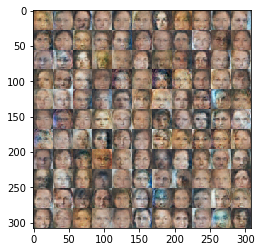

Epoch: 6/16 Discriminator Loss: 0.7395 Generator Loss: 2.5241
Epoch: 6/16 Discriminator Loss: 0.2787 Generator Loss: 3.0047
Epoch: 6/16 Discriminator Loss: 0.3853 Generator Loss: 2.8174
Epoch: 6/16 Discriminator Loss: 0.3529 Generator Loss: 1.8525
Epoch: 6/16 Discriminator Loss: 0.2858 Generator Loss: 4.6113
Epoch: 6/16 Discriminator Loss: 0.2327 Generator Loss: 2.7180
Epoch: 6/16 Discriminator Loss: 0.3498 Generator Loss: 1.7888
Epoch: 6/16 Discriminator Loss: 0.3447 Generator Loss: 1.7490
Epoch: 6/16 Discriminator Loss: 0.3101 Generator Loss: 1.9037
Epoch: 6/16 Discriminator Loss: 0.1490 Generator Loss: 4.0738


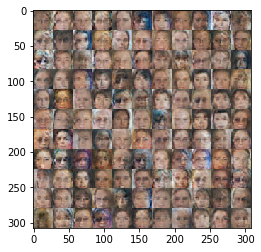

Epoch: 6/16 Discriminator Loss: 0.7017 Generator Loss: 0.8987
Epoch: 6/16 Discriminator Loss: 0.2138 Generator Loss: 2.9985
Epoch: 6/16 Discriminator Loss: 0.2740 Generator Loss: 2.5844
Epoch: 6/16 Discriminator Loss: 0.2220 Generator Loss: 2.7169
Epoch: 6/16 Discriminator Loss: 0.1234 Generator Loss: 3.8223
Epoch: 6/16 Discriminator Loss: 0.0690 Generator Loss: 5.4949
Epoch: 6/16 Discriminator Loss: 0.1031 Generator Loss: 7.5597
Epoch: 6/16 Discriminator Loss: 0.9969 Generator Loss: 0.6283
Epoch: 6/16 Discriminator Loss: 0.7700 Generator Loss: 0.8930
Epoch: 6/16 Discriminator Loss: 0.2636 Generator Loss: 2.3669


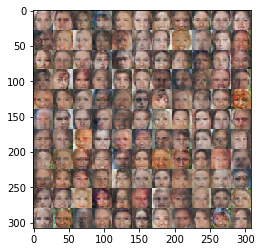

Epoch: 6/16 Discriminator Loss: 0.2044 Generator Loss: 3.3740
Epoch: 6/16 Discriminator Loss: 0.2304 Generator Loss: 2.7081
Epoch: 6/16 Discriminator Loss: 0.2923 Generator Loss: 1.9495
Epoch: 6/16 Discriminator Loss: 1.4818 Generator Loss: 0.4244
Epoch: 6/16 Discriminator Loss: 0.2550 Generator Loss: 4.6894
Epoch: 6/16 Discriminator Loss: 1.5353 Generator Loss: 0.3296
Epoch: 6/16 Discriminator Loss: 0.3019 Generator Loss: 1.9444
Epoch: 6/16 Discriminator Loss: 0.3839 Generator Loss: 7.4048
Epoch: 6/16 Discriminator Loss: 0.3718 Generator Loss: 2.0981
Epoch: 6/16 Discriminator Loss: 0.2747 Generator Loss: 2.1050


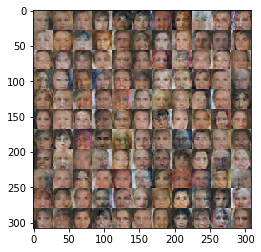

Epoch: 6/16 Discriminator Loss: 0.2241 Generator Loss: 4.3137
Epoch: 6/16 Discriminator Loss: 0.1519 Generator Loss: 5.2473
Epoch: 6/16 Discriminator Loss: 0.1336 Generator Loss: 5.6777
Epoch: 6/16 Discriminator Loss: 0.0989 Generator Loss: 5.4648
Epoch: 6/16 Discriminator Loss: 0.2588 Generator Loss: 2.3538
Epoch: 6/16 Discriminator Loss: 0.4660 Generator Loss: 1.5269
Epoch: 6/16 Discriminator Loss: 0.1948 Generator Loss: 2.8409
Epoch: 6/16 Discriminator Loss: 0.1949 Generator Loss: 5.7936
Epoch: 6/16 Discriminator Loss: 1.1520 Generator Loss: 0.6478
Epoch: 6/16 Discriminator Loss: 0.7316 Generator Loss: 0.9086


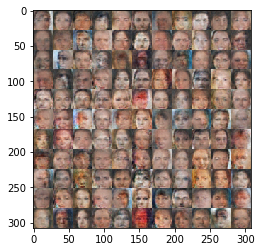

Epoch: 6/16 Discriminator Loss: 0.1524 Generator Loss: 3.2528
Epoch: 6/16 Discriminator Loss: 0.1061 Generator Loss: 5.3914
Epoch: 6/16 Discriminator Loss: 1.0107 Generator Loss: 3.7027
Epoch: 6/16 Discriminator Loss: 1.0264 Generator Loss: 0.7197
Epoch: 6/16 Discriminator Loss: 0.0786 Generator Loss: 4.4914
Epoch: 6/16 Discriminator Loss: 0.3131 Generator Loss: 3.4675
Epoch: 6/16 Discriminator Loss: 0.2132 Generator Loss: 3.2875
Epoch: 6/16 Discriminator Loss: 0.2293 Generator Loss: 4.5728
Epoch: 6/16 Discriminator Loss: 0.5325 Generator Loss: 4.6583
Epoch: 7/16 Discriminator Loss: 0.1643 Generator Loss: 3.3600


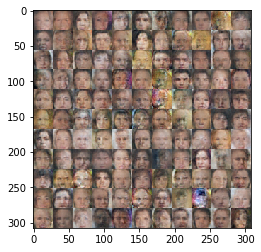

Epoch: 7/16 Discriminator Loss: 0.1750 Generator Loss: 3.8480
Epoch: 7/16 Discriminator Loss: 0.3113 Generator Loss: 6.6811
Epoch: 7/16 Discriminator Loss: 0.1629 Generator Loss: 4.0743
Epoch: 7/16 Discriminator Loss: 0.2235 Generator Loss: 2.7082
Epoch: 7/16 Discriminator Loss: 1.1410 Generator Loss: 0.5293
Epoch: 7/16 Discriminator Loss: 1.0497 Generator Loss: 2.1467
Epoch: 7/16 Discriminator Loss: 0.6788 Generator Loss: 1.8475
Epoch: 7/16 Discriminator Loss: 0.3716 Generator Loss: 2.0139
Epoch: 7/16 Discriminator Loss: 0.2887 Generator Loss: 2.6609
Epoch: 7/16 Discriminator Loss: 0.4915 Generator Loss: 1.4053


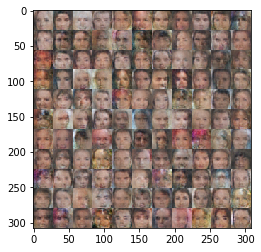

Epoch: 7/16 Discriminator Loss: 0.4326 Generator Loss: 1.3702
Epoch: 7/16 Discriminator Loss: 0.2415 Generator Loss: 2.3050
Epoch: 7/16 Discriminator Loss: 0.8721 Generator Loss: 0.7305
Epoch: 7/16 Discriminator Loss: 0.5512 Generator Loss: 4.3485
Epoch: 7/16 Discriminator Loss: 0.1982 Generator Loss: 6.5487
Epoch: 7/16 Discriminator Loss: 0.3321 Generator Loss: 2.4575
Epoch: 7/16 Discriminator Loss: 0.3025 Generator Loss: 3.0999
Epoch: 7/16 Discriminator Loss: 0.2616 Generator Loss: 2.2357
Epoch: 7/16 Discriminator Loss: 0.3571 Generator Loss: 1.9633
Epoch: 7/16 Discriminator Loss: 0.1708 Generator Loss: 5.1327


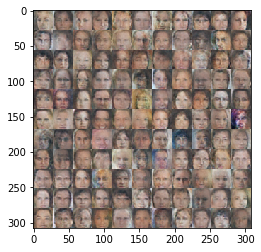

Epoch: 7/16 Discriminator Loss: 0.3966 Generator Loss: 4.7441
Epoch: 7/16 Discriminator Loss: 0.3399 Generator Loss: 1.8934
Epoch: 7/16 Discriminator Loss: 0.1188 Generator Loss: 4.5445
Epoch: 7/16 Discriminator Loss: 0.1740 Generator Loss: 3.1476
Epoch: 7/16 Discriminator Loss: 0.2021 Generator Loss: 3.5522
Epoch: 7/16 Discriminator Loss: 0.1606 Generator Loss: 3.6355
Epoch: 7/16 Discriminator Loss: 0.6215 Generator Loss: 1.2899
Epoch: 7/16 Discriminator Loss: 0.0817 Generator Loss: 4.9346
Epoch: 7/16 Discriminator Loss: 0.3953 Generator Loss: 6.3432
Epoch: 7/16 Discriminator Loss: 0.1365 Generator Loss: 3.4306


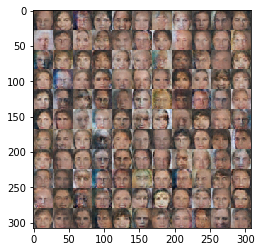

Epoch: 7/16 Discriminator Loss: 0.3375 Generator Loss: 4.9252
Epoch: 7/16 Discriminator Loss: 0.5849 Generator Loss: 1.2367
Epoch: 7/16 Discriminator Loss: 0.1831 Generator Loss: 3.0657
Epoch: 7/16 Discriminator Loss: 0.9627 Generator Loss: 0.8141
Epoch: 7/16 Discriminator Loss: 0.3526 Generator Loss: 2.5205
Epoch: 7/16 Discriminator Loss: 0.1230 Generator Loss: 3.7783
Epoch: 7/16 Discriminator Loss: 0.2012 Generator Loss: 3.0278
Epoch: 7/16 Discriminator Loss: 0.1817 Generator Loss: 5.5480
Epoch: 7/16 Discriminator Loss: 0.3182 Generator Loss: 2.4143
Epoch: 7/16 Discriminator Loss: 0.3520 Generator Loss: 1.8912


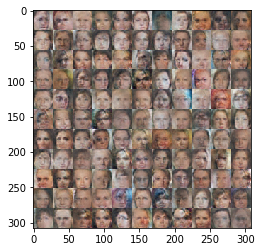

Epoch: 7/16 Discriminator Loss: 0.1193 Generator Loss: 4.7197
Epoch: 7/16 Discriminator Loss: 0.1690 Generator Loss: 3.3763
Epoch: 7/16 Discriminator Loss: 0.2791 Generator Loss: 2.0933
Epoch: 7/16 Discriminator Loss: 0.3936 Generator Loss: 1.6835
Epoch: 7/16 Discriminator Loss: 1.2888 Generator Loss: 0.7158
Epoch: 7/16 Discriminator Loss: 0.2911 Generator Loss: 3.1811
Epoch: 7/16 Discriminator Loss: 0.7561 Generator Loss: 1.0843
Epoch: 7/16 Discriminator Loss: 0.1617 Generator Loss: 9.9503
Epoch: 7/16 Discriminator Loss: 0.5003 Generator Loss: 1.3328
Epoch: 7/16 Discriminator Loss: 0.2020 Generator Loss: 2.7209


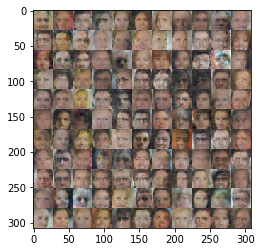

Epoch: 7/16 Discriminator Loss: 0.2550 Generator Loss: 2.6148
Epoch: 7/16 Discriminator Loss: 0.0417 Generator Loss: 8.0895
Epoch: 7/16 Discriminator Loss: 0.0888 Generator Loss: 4.5518
Epoch: 7/16 Discriminator Loss: 1.2856 Generator Loss: 0.4960
Epoch: 7/16 Discriminator Loss: 0.2129 Generator Loss: 2.7192
Epoch: 7/16 Discriminator Loss: 0.4298 Generator Loss: 2.9635
Epoch: 7/16 Discriminator Loss: 0.4091 Generator Loss: 4.6885
Epoch: 7/16 Discriminator Loss: 0.2610 Generator Loss: 3.5607
Epoch: 7/16 Discriminator Loss: 0.2899 Generator Loss: 2.2704
Epoch: 7/16 Discriminator Loss: 0.1919 Generator Loss: 3.4106


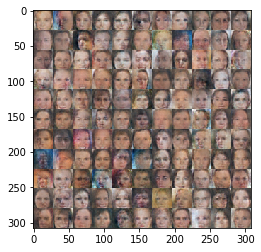

Epoch: 7/16 Discriminator Loss: 0.2707 Generator Loss: 3.6252
Epoch: 7/16 Discriminator Loss: 0.3337 Generator Loss: 1.9159
Epoch: 7/16 Discriminator Loss: 0.8596 Generator Loss: 0.7840
Epoch: 7/16 Discriminator Loss: 0.3675 Generator Loss: 2.0144
Epoch: 7/16 Discriminator Loss: 0.3850 Generator Loss: 1.9248
Epoch: 7/16 Discriminator Loss: 0.1824 Generator Loss: 2.7830
Epoch: 7/16 Discriminator Loss: 0.5342 Generator Loss: 1.5681
Epoch: 7/16 Discriminator Loss: 0.0802 Generator Loss: 4.8828
Epoch: 7/16 Discriminator Loss: 0.3930 Generator Loss: 7.6852
Epoch: 7/16 Discriminator Loss: 0.0726 Generator Loss: 9.6532


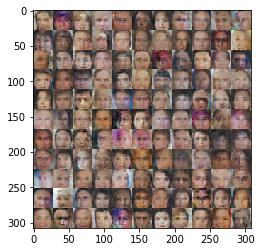

Epoch: 7/16 Discriminator Loss: 1.9234 Generator Loss: 0.2053
Epoch: 7/16 Discriminator Loss: 0.1664 Generator Loss: 4.8065
Epoch: 7/16 Discriminator Loss: 0.1514 Generator Loss: 3.6396
Epoch: 7/16 Discriminator Loss: 0.8644 Generator Loss: 4.4031
Epoch: 7/16 Discriminator Loss: 0.4175 Generator Loss: 4.3634
Epoch: 7/16 Discriminator Loss: 0.2990 Generator Loss: 2.0400
Epoch: 7/16 Discriminator Loss: 0.0537 Generator Loss: 5.5435
Epoch: 7/16 Discriminator Loss: 0.2092 Generator Loss: 2.6750
Epoch: 7/16 Discriminator Loss: 0.1694 Generator Loss: 3.4897
Epoch: 7/16 Discriminator Loss: 0.0986 Generator Loss: 7.9858


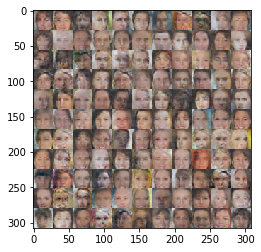

Epoch: 7/16 Discriminator Loss: 0.2180 Generator Loss: 2.9314
Epoch: 7/16 Discriminator Loss: 2.2699 Generator Loss: 0.1967
Epoch: 7/16 Discriminator Loss: 1.8869 Generator Loss: 4.4428
Epoch: 7/16 Discriminator Loss: 0.4469 Generator Loss: 3.3719
Epoch: 7/16 Discriminator Loss: 0.4903 Generator Loss: 1.7888
Epoch: 7/16 Discriminator Loss: 0.2416 Generator Loss: 5.1463
Epoch: 7/16 Discriminator Loss: 0.2223 Generator Loss: 2.8162
Epoch: 7/16 Discriminator Loss: 0.4388 Generator Loss: 1.5706
Epoch: 7/16 Discriminator Loss: 0.4133 Generator Loss: 1.6520
Epoch: 7/16 Discriminator Loss: 0.1198 Generator Loss: 4.9280


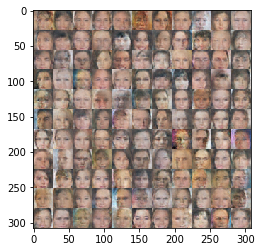

Epoch: 7/16 Discriminator Loss: 0.3095 Generator Loss: 2.2035
Epoch: 7/16 Discriminator Loss: 0.3299 Generator Loss: 2.0160
Epoch: 7/16 Discriminator Loss: 0.4886 Generator Loss: 6.7599
Epoch: 7/16 Discriminator Loss: 1.1596 Generator Loss: 0.5545
Epoch: 7/16 Discriminator Loss: 0.1302 Generator Loss: 3.5982
Epoch: 7/16 Discriminator Loss: 0.0744 Generator Loss: 6.2587
Epoch: 7/16 Discriminator Loss: 0.0565 Generator Loss: 7.3969
Epoch: 7/16 Discriminator Loss: 0.1850 Generator Loss: 2.8500
Epoch: 7/16 Discriminator Loss: 0.2669 Generator Loss: 2.2471
Epoch: 7/16 Discriminator Loss: 0.1453 Generator Loss: 5.4735


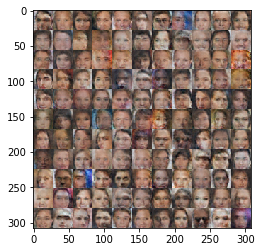

Epoch: 7/16 Discriminator Loss: 0.1528 Generator Loss: 5.6585
Epoch: 7/16 Discriminator Loss: 0.3040 Generator Loss: 2.0666
Epoch: 7/16 Discriminator Loss: 0.1192 Generator Loss: 3.5619
Epoch: 7/16 Discriminator Loss: 0.0981 Generator Loss: 3.5887
Epoch: 7/16 Discriminator Loss: 0.1748 Generator Loss: 3.0852
Epoch: 7/16 Discriminator Loss: 0.3653 Generator Loss: 1.6791
Epoch: 7/16 Discriminator Loss: 0.1073 Generator Loss: 3.1860
Epoch: 7/16 Discriminator Loss: 3.6688 Generator Loss: 0.0544
Epoch: 7/16 Discriminator Loss: 1.1362 Generator Loss: 0.5905
Epoch: 7/16 Discriminator Loss: 1.5042 Generator Loss: 0.3751


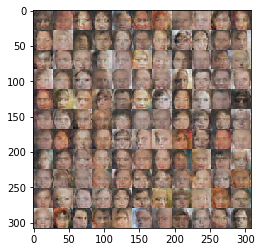

Epoch: 7/16 Discriminator Loss: 0.6194 Generator Loss: 1.1500
Epoch: 7/16 Discriminator Loss: 0.2952 Generator Loss: 2.9202
Epoch: 7/16 Discriminator Loss: 0.3870 Generator Loss: 1.9378
Epoch: 7/16 Discriminator Loss: 0.3515 Generator Loss: 4.0805
Epoch: 7/16 Discriminator Loss: 0.1753 Generator Loss: 5.3877
Epoch: 7/16 Discriminator Loss: 0.1802 Generator Loss: 2.7217
Epoch: 7/16 Discriminator Loss: 0.2134 Generator Loss: 4.1183
Epoch: 7/16 Discriminator Loss: 1.4928 Generator Loss: 0.3768
Epoch: 7/16 Discriminator Loss: 0.1911 Generator Loss: 2.9988
Epoch: 7/16 Discriminator Loss: 0.4748 Generator Loss: 3.4681


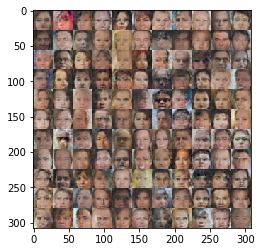

Epoch: 7/16 Discriminator Loss: 0.1272 Generator Loss: 3.4991
Epoch: 7/16 Discriminator Loss: 1.6980 Generator Loss: 0.3051
Epoch: 7/16 Discriminator Loss: 0.1843 Generator Loss: 3.5816
Epoch: 7/16 Discriminator Loss: 0.1137 Generator Loss: 5.7245
Epoch: 7/16 Discriminator Loss: 0.0798 Generator Loss: 4.4379
Epoch: 7/16 Discriminator Loss: 0.0988 Generator Loss: 4.1470
Epoch: 7/16 Discriminator Loss: 1.3064 Generator Loss: 7.9790
Epoch: 7/16 Discriminator Loss: 4.4184 Generator Loss: 2.7783
Epoch: 7/16 Discriminator Loss: 0.7637 Generator Loss: 1.3330
Epoch: 7/16 Discriminator Loss: 0.3136 Generator Loss: 2.3397


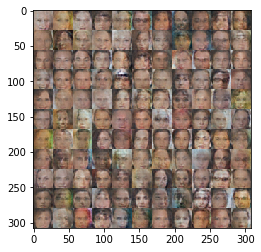

Epoch: 7/16 Discriminator Loss: 0.6560 Generator Loss: 1.6663
Epoch: 7/16 Discriminator Loss: 0.7608 Generator Loss: 0.8821
Epoch: 7/16 Discriminator Loss: 0.2092 Generator Loss: 3.9480
Epoch: 7/16 Discriminator Loss: 0.7625 Generator Loss: 0.8725
Epoch: 7/16 Discriminator Loss: 1.0499 Generator Loss: 0.6390
Epoch: 7/16 Discriminator Loss: 0.3579 Generator Loss: 2.0337
Epoch: 7/16 Discriminator Loss: 0.6011 Generator Loss: 2.2207
Epoch: 7/16 Discriminator Loss: 0.4902 Generator Loss: 1.3902
Epoch: 7/16 Discriminator Loss: 0.3175 Generator Loss: 1.9701
Epoch: 7/16 Discriminator Loss: 0.6205 Generator Loss: 1.1970


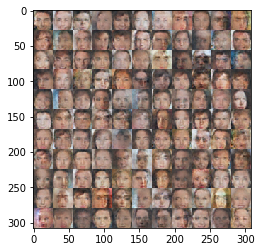

Epoch: 7/16 Discriminator Loss: 0.8001 Generator Loss: 1.1802
Epoch: 7/16 Discriminator Loss: 0.1552 Generator Loss: 2.7707
Epoch: 7/16 Discriminator Loss: 0.2271 Generator Loss: 3.2073
Epoch: 7/16 Discriminator Loss: 0.2672 Generator Loss: 5.7790
Epoch: 7/16 Discriminator Loss: 0.3620 Generator Loss: 1.5980
Epoch: 7/16 Discriminator Loss: 0.1116 Generator Loss: 4.4312
Epoch: 7/16 Discriminator Loss: 1.2171 Generator Loss: 0.5707
Epoch: 7/16 Discriminator Loss: 0.5338 Generator Loss: 1.3196
Epoch: 7/16 Discriminator Loss: 0.8131 Generator Loss: 0.9805
Epoch: 7/16 Discriminator Loss: 0.4070 Generator Loss: 1.7604


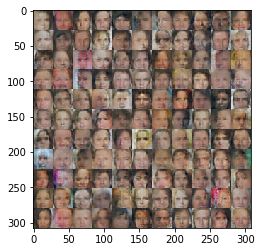

Epoch: 7/16 Discriminator Loss: 0.2405 Generator Loss: 3.1636
Epoch: 7/16 Discriminator Loss: 0.2022 Generator Loss: 3.9725
Epoch: 7/16 Discriminator Loss: 0.2830 Generator Loss: 2.2337
Epoch: 7/16 Discriminator Loss: 0.6716 Generator Loss: 0.9643
Epoch: 7/16 Discriminator Loss: 0.2876 Generator Loss: 2.3973
Epoch: 7/16 Discriminator Loss: 0.2059 Generator Loss: 4.7875
Epoch: 7/16 Discriminator Loss: 0.2257 Generator Loss: 2.2877
Epoch: 8/16 Discriminator Loss: 0.1329 Generator Loss: 3.4881
Epoch: 8/16 Discriminator Loss: 1.1607 Generator Loss: 0.5360
Epoch: 8/16 Discriminator Loss: 0.4180 Generator Loss: 1.6038


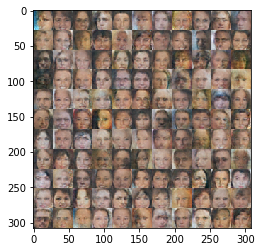

Epoch: 8/16 Discriminator Loss: 0.0885 Generator Loss: 5.6382
Epoch: 8/16 Discriminator Loss: 1.7839 Generator Loss: 0.2945
Epoch: 8/16 Discriminator Loss: 0.9402 Generator Loss: 1.6966
Epoch: 8/16 Discriminator Loss: 0.8007 Generator Loss: 0.9968
Epoch: 8/16 Discriminator Loss: 0.9147 Generator Loss: 0.8141
Epoch: 8/16 Discriminator Loss: 0.6722 Generator Loss: 0.9824
Epoch: 8/16 Discriminator Loss: 0.4372 Generator Loss: 1.4939
Epoch: 8/16 Discriminator Loss: 0.4415 Generator Loss: 2.5847
Epoch: 8/16 Discriminator Loss: 0.4965 Generator Loss: 1.5128
Epoch: 8/16 Discriminator Loss: 0.6696 Generator Loss: 1.0278


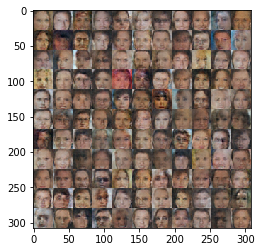

Epoch: 8/16 Discriminator Loss: 0.0985 Generator Loss: 4.8494
Epoch: 8/16 Discriminator Loss: 0.2064 Generator Loss: 2.6631
Epoch: 8/16 Discriminator Loss: 0.2942 Generator Loss: 1.8775
Epoch: 8/16 Discriminator Loss: 0.3203 Generator Loss: 1.9726
Epoch: 8/16 Discriminator Loss: 0.2746 Generator Loss: 3.0121
Epoch: 8/16 Discriminator Loss: 0.7364 Generator Loss: 0.8756
Epoch: 8/16 Discriminator Loss: 1.0820 Generator Loss: 0.6383
Epoch: 8/16 Discriminator Loss: 0.1433 Generator Loss: 4.0651
Epoch: 8/16 Discriminator Loss: 0.2298 Generator Loss: 2.4882
Epoch: 8/16 Discriminator Loss: 0.4787 Generator Loss: 1.5062


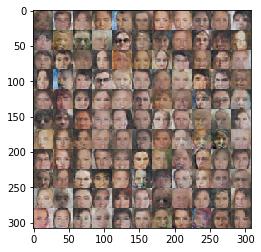

Epoch: 8/16 Discriminator Loss: 0.1865 Generator Loss: 2.5076
Epoch: 8/16 Discriminator Loss: 0.1320 Generator Loss: 3.1924
Epoch: 8/16 Discriminator Loss: 0.1570 Generator Loss: 3.4706
Epoch: 8/16 Discriminator Loss: 0.1757 Generator Loss: 5.8211
Epoch: 8/16 Discriminator Loss: 0.0438 Generator Loss: 7.2375
Epoch: 8/16 Discriminator Loss: 0.4343 Generator Loss: 1.4715
Epoch: 8/16 Discriminator Loss: 0.1816 Generator Loss: 3.7097
Epoch: 8/16 Discriminator Loss: 0.6809 Generator Loss: 0.9131
Epoch: 8/16 Discriminator Loss: 0.0539 Generator Loss: 4.1550
Epoch: 8/16 Discriminator Loss: 2.9534 Generator Loss: 4.3650


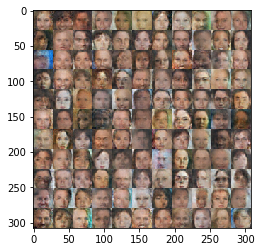

Epoch: 8/16 Discriminator Loss: 0.5610 Generator Loss: 1.2463
Epoch: 8/16 Discriminator Loss: 1.2710 Generator Loss: 0.5255
Epoch: 8/16 Discriminator Loss: 0.6357 Generator Loss: 1.1144
Epoch: 8/16 Discriminator Loss: 0.6613 Generator Loss: 5.6812
Epoch: 8/16 Discriminator Loss: 0.2836 Generator Loss: 2.9972
Epoch: 8/16 Discriminator Loss: 0.3622 Generator Loss: 1.7615
Epoch: 8/16 Discriminator Loss: 0.0867 Generator Loss: 4.2843
Epoch: 8/16 Discriminator Loss: 0.4889 Generator Loss: 1.3658
Epoch: 8/16 Discriminator Loss: 0.1582 Generator Loss: 3.1878
Epoch: 8/16 Discriminator Loss: 0.1127 Generator Loss: 3.8993


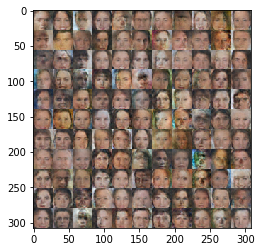

Epoch: 8/16 Discriminator Loss: 0.1890 Generator Loss: 3.1486
Epoch: 8/16 Discriminator Loss: 0.2840 Generator Loss: 6.2093
Epoch: 8/16 Discriminator Loss: 0.1259 Generator Loss: 3.2892
Epoch: 8/16 Discriminator Loss: 0.2551 Generator Loss: 3.0028
Epoch: 8/16 Discriminator Loss: 1.1281 Generator Loss: 0.5718
Epoch: 8/16 Discriminator Loss: 1.6471 Generator Loss: 3.4281
Epoch: 8/16 Discriminator Loss: 0.7662 Generator Loss: 1.0008
Epoch: 8/16 Discriminator Loss: 0.2194 Generator Loss: 2.5173
Epoch: 8/16 Discriminator Loss: 0.1875 Generator Loss: 4.6035
Epoch: 8/16 Discriminator Loss: 0.4021 Generator Loss: 6.6284


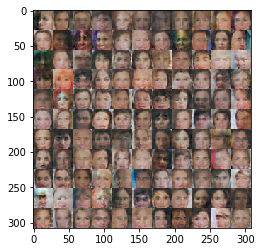

Epoch: 8/16 Discriminator Loss: 0.5118 Generator Loss: 2.4562
Epoch: 8/16 Discriminator Loss: 0.7852 Generator Loss: 0.7960
Epoch: 8/16 Discriminator Loss: 0.5636 Generator Loss: 1.3091
Epoch: 8/16 Discriminator Loss: 0.1331 Generator Loss: 3.8635
Epoch: 8/16 Discriminator Loss: 0.1574 Generator Loss: 3.2815
Epoch: 8/16 Discriminator Loss: 1.1111 Generator Loss: 0.6145
Epoch: 8/16 Discriminator Loss: 0.6857 Generator Loss: 0.9181
Epoch: 8/16 Discriminator Loss: 0.1014 Generator Loss: 3.7107
Epoch: 8/16 Discriminator Loss: 0.5187 Generator Loss: 1.2035
Epoch: 8/16 Discriminator Loss: 0.2911 Generator Loss: 2.3844


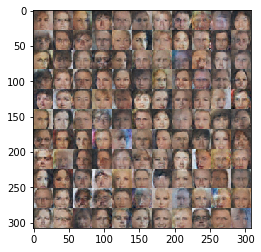

Epoch: 8/16 Discriminator Loss: 0.0657 Generator Loss: 10.7951
Epoch: 8/16 Discriminator Loss: 0.1000 Generator Loss: 9.3937
Epoch: 8/16 Discriminator Loss: 0.0964 Generator Loss: 4.4210
Epoch: 8/16 Discriminator Loss: 0.0953 Generator Loss: 5.0096
Epoch: 8/16 Discriminator Loss: 0.0491 Generator Loss: 5.1563
Epoch: 8/16 Discriminator Loss: 0.0689 Generator Loss: 5.7798
Epoch: 8/16 Discriminator Loss: 0.1341 Generator Loss: 5.2551
Epoch: 8/16 Discriminator Loss: 0.1409 Generator Loss: 5.1012
Epoch: 8/16 Discriminator Loss: 0.0673 Generator Loss: 8.9781
Epoch: 8/16 Discriminator Loss: 0.1380 Generator Loss: 5.5359


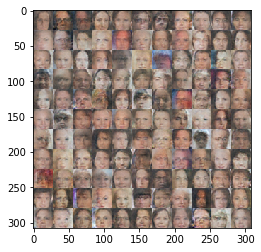

Epoch: 8/16 Discriminator Loss: 2.4266 Generator Loss: 3.6285
Epoch: 8/16 Discriminator Loss: 0.6104 Generator Loss: 1.3260
Epoch: 8/16 Discriminator Loss: 0.7186 Generator Loss: 1.0800
Epoch: 8/16 Discriminator Loss: 0.4231 Generator Loss: 1.8313
Epoch: 8/16 Discriminator Loss: 0.2660 Generator Loss: 2.2600
Epoch: 8/16 Discriminator Loss: 0.1081 Generator Loss: 3.6468
Epoch: 8/16 Discriminator Loss: 0.8364 Generator Loss: 0.8472
Epoch: 8/16 Discriminator Loss: 0.4412 Generator Loss: 9.7876
Epoch: 8/16 Discriminator Loss: 0.0259 Generator Loss: 9.8641
Epoch: 8/16 Discriminator Loss: 0.3823 Generator Loss: 1.8592


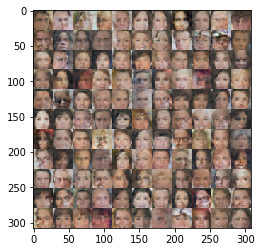

Epoch: 8/16 Discriminator Loss: 0.3942 Generator Loss: 8.9040
Epoch: 8/16 Discriminator Loss: 0.1018 Generator Loss: 13.0799
Epoch: 8/16 Discriminator Loss: 1.4737 Generator Loss: 1.0133
Epoch: 8/16 Discriminator Loss: 0.9896 Generator Loss: 0.9988
Epoch: 8/16 Discriminator Loss: 1.0494 Generator Loss: 0.6523
Epoch: 8/16 Discriminator Loss: 0.7025 Generator Loss: 1.4548
Epoch: 8/16 Discriminator Loss: 0.5419 Generator Loss: 1.6306
Epoch: 8/16 Discriminator Loss: 0.2686 Generator Loss: 2.1466
Epoch: 8/16 Discriminator Loss: 0.2696 Generator Loss: 2.5122
Epoch: 8/16 Discriminator Loss: 0.1441 Generator Loss: 4.2388


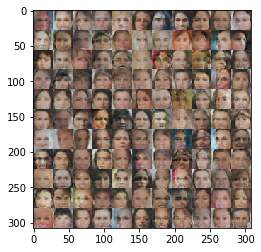

Epoch: 8/16 Discriminator Loss: 0.2774 Generator Loss: 2.2542
Epoch: 8/16 Discriminator Loss: 0.2473 Generator Loss: 2.3978
Epoch: 8/16 Discriminator Loss: 0.1022 Generator Loss: 3.9407
Epoch: 8/16 Discriminator Loss: 0.9472 Generator Loss: 0.7152
Epoch: 8/16 Discriminator Loss: 0.9819 Generator Loss: 0.7316
Epoch: 8/16 Discriminator Loss: 0.1642 Generator Loss: 6.9792
Epoch: 8/16 Discriminator Loss: 0.4545 Generator Loss: 5.1087
Epoch: 8/16 Discriminator Loss: 0.6015 Generator Loss: 1.1613
Epoch: 8/16 Discriminator Loss: 1.0968 Generator Loss: 0.5681
Epoch: 8/16 Discriminator Loss: 0.1737 Generator Loss: 2.7461


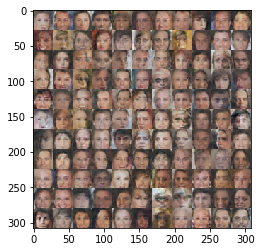

Epoch: 8/16 Discriminator Loss: 0.4563 Generator Loss: 4.9110
Epoch: 8/16 Discriminator Loss: 0.2103 Generator Loss: 2.7237
Epoch: 8/16 Discriminator Loss: 0.0588 Generator Loss: 5.9587
Epoch: 8/16 Discriminator Loss: 1.0873 Generator Loss: 0.6407
Epoch: 8/16 Discriminator Loss: 0.1205 Generator Loss: 3.3262
Epoch: 8/16 Discriminator Loss: 0.1588 Generator Loss: 2.6046
Epoch: 8/16 Discriminator Loss: 0.2447 Generator Loss: 4.1927
Epoch: 8/16 Discriminator Loss: 0.0607 Generator Loss: 3.9133
Epoch: 8/16 Discriminator Loss: 1.3745 Generator Loss: 0.8787
Epoch: 8/16 Discriminator Loss: 1.4911 Generator Loss: 0.9261


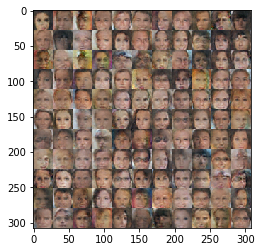

Epoch: 8/16 Discriminator Loss: 1.4408 Generator Loss: 0.7015
Epoch: 8/16 Discriminator Loss: 1.3642 Generator Loss: 0.6551
Epoch: 8/16 Discriminator Loss: 0.6136 Generator Loss: 1.4068
Epoch: 8/16 Discriminator Loss: 0.6763 Generator Loss: 1.0308
Epoch: 8/16 Discriminator Loss: 0.6008 Generator Loss: 1.8321
Epoch: 8/16 Discriminator Loss: 0.5173 Generator Loss: 1.4829
Epoch: 8/16 Discriminator Loss: 0.2722 Generator Loss: 3.0720
Epoch: 8/16 Discriminator Loss: 0.4631 Generator Loss: 1.6194
Epoch: 8/16 Discriminator Loss: 0.8876 Generator Loss: 0.7557
Epoch: 8/16 Discriminator Loss: 0.1077 Generator Loss: 4.6039


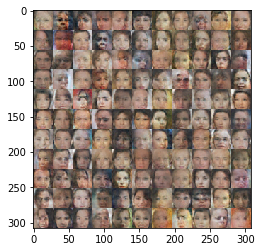

Epoch: 8/16 Discriminator Loss: 0.7506 Generator Loss: 0.8654
Epoch: 8/16 Discriminator Loss: 0.4583 Generator Loss: 2.2709
Epoch: 8/16 Discriminator Loss: 0.5333 Generator Loss: 1.3158
Epoch: 8/16 Discriminator Loss: 0.2805 Generator Loss: 2.3626
Epoch: 8/16 Discriminator Loss: 1.8105 Generator Loss: 0.2809
Epoch: 8/16 Discriminator Loss: 0.3521 Generator Loss: 4.2538
Epoch: 8/16 Discriminator Loss: 0.5030 Generator Loss: 1.2476
Epoch: 8/16 Discriminator Loss: 0.1172 Generator Loss: 3.2840
Epoch: 8/16 Discriminator Loss: 0.2359 Generator Loss: 3.2762
Epoch: 8/16 Discriminator Loss: 0.3886 Generator Loss: 7.5051


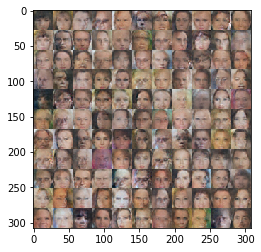

Epoch: 8/16 Discriminator Loss: 0.4641 Generator Loss: 3.1822
Epoch: 8/16 Discriminator Loss: 7.9941 Generator Loss: 10.4265
Epoch: 8/16 Discriminator Loss: 0.8627 Generator Loss: 0.8323
Epoch: 8/16 Discriminator Loss: 0.8402 Generator Loss: 0.7628
Epoch: 8/16 Discriminator Loss: 0.2286 Generator Loss: 3.5944
Epoch: 8/16 Discriminator Loss: 0.4437 Generator Loss: 1.5030
Epoch: 8/16 Discriminator Loss: 0.5388 Generator Loss: 1.2343
Epoch: 8/16 Discriminator Loss: 0.1339 Generator Loss: 3.3418
Epoch: 8/16 Discriminator Loss: 0.2521 Generator Loss: 2.0736
Epoch: 8/16 Discriminator Loss: 0.1919 Generator Loss: 5.0217


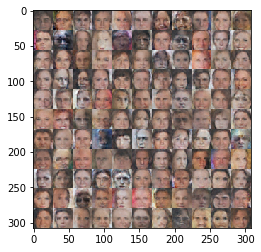

Epoch: 8/16 Discriminator Loss: 0.0586 Generator Loss: 7.6316
Epoch: 8/16 Discriminator Loss: 0.7947 Generator Loss: 0.8887
Epoch: 8/16 Discriminator Loss: 0.3570 Generator Loss: 1.8259
Epoch: 8/16 Discriminator Loss: 1.4007 Generator Loss: 10.2322
Epoch: 8/16 Discriminator Loss: 1.5705 Generator Loss: 2.7002
Epoch: 8/16 Discriminator Loss: 0.4099 Generator Loss: 1.7274
Epoch: 8/16 Discriminator Loss: 0.1144 Generator Loss: 4.6618
Epoch: 8/16 Discriminator Loss: 0.3060 Generator Loss: 1.8814
Epoch: 8/16 Discriminator Loss: 0.1185 Generator Loss: 6.1798
Epoch: 8/16 Discriminator Loss: 0.9083 Generator Loss: 3.1689


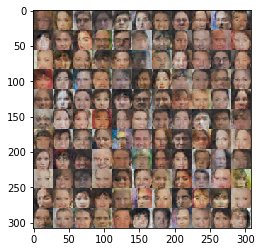

Epoch: 8/16 Discriminator Loss: 0.3167 Generator Loss: 1.6965
Epoch: 8/16 Discriminator Loss: 0.4675 Generator Loss: 1.3401
Epoch: 8/16 Discriminator Loss: 0.1232 Generator Loss: 3.0844
Epoch: 8/16 Discriminator Loss: 0.0786 Generator Loss: 5.1431
Epoch: 8/16 Discriminator Loss: 0.1305 Generator Loss: 3.5707
Epoch: 9/16 Discriminator Loss: 0.6157 Generator Loss: 10.1099
Epoch: 9/16 Discriminator Loss: 0.1653 Generator Loss: 7.8587
Epoch: 9/16 Discriminator Loss: 0.8420 Generator Loss: 0.7280
Epoch: 9/16 Discriminator Loss: 0.4266 Generator Loss: 3.0923
Epoch: 9/16 Discriminator Loss: 0.2229 Generator Loss: 2.4402


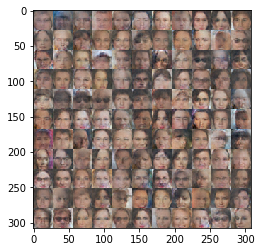

Epoch: 9/16 Discriminator Loss: 0.0997 Generator Loss: 3.6483
Epoch: 9/16 Discriminator Loss: 0.0242 Generator Loss: 5.5876
Epoch: 9/16 Discriminator Loss: 0.0733 Generator Loss: 4.4356
Epoch: 9/16 Discriminator Loss: 1.2438 Generator Loss: 2.9076
Epoch: 9/16 Discriminator Loss: 1.0771 Generator Loss: 2.0840
Epoch: 9/16 Discriminator Loss: 1.0955 Generator Loss: 0.6180
Epoch: 9/16 Discriminator Loss: 0.3872 Generator Loss: 1.6778
Epoch: 9/16 Discriminator Loss: 0.2206 Generator Loss: 9.4135
Epoch: 9/16 Discriminator Loss: 0.1234 Generator Loss: 4.9550
Epoch: 9/16 Discriminator Loss: 0.0701 Generator Loss: 6.0998


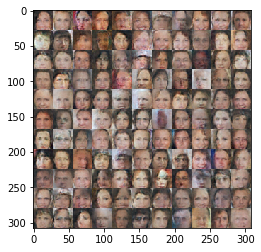

Epoch: 9/16 Discriminator Loss: 0.0813 Generator Loss: 4.4865
Epoch: 9/16 Discriminator Loss: 0.1169 Generator Loss: 4.4162
Epoch: 9/16 Discriminator Loss: 0.6430 Generator Loss: 10.8150
Epoch: 9/16 Discriminator Loss: 0.0417 Generator Loss: 7.0946
Epoch: 9/16 Discriminator Loss: 0.0399 Generator Loss: 5.3865
Epoch: 9/16 Discriminator Loss: 0.3545 Generator Loss: 1.5769
Epoch: 9/16 Discriminator Loss: 2.6978 Generator Loss: 1.2745
Epoch: 9/16 Discriminator Loss: 1.0584 Generator Loss: 0.9425
Epoch: 9/16 Discriminator Loss: 0.3486 Generator Loss: 3.3381
Epoch: 9/16 Discriminator Loss: 0.2690 Generator Loss: 4.5315


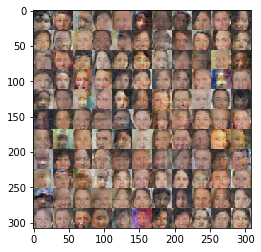

Epoch: 9/16 Discriminator Loss: 0.1707 Generator Loss: 4.2700
Epoch: 9/16 Discriminator Loss: 0.2002 Generator Loss: 2.8489
Epoch: 9/16 Discriminator Loss: 1.4768 Generator Loss: 0.3679
Epoch: 9/16 Discriminator Loss: 2.0613 Generator Loss: 0.1910
Epoch: 9/16 Discriminator Loss: 0.1940 Generator Loss: 2.3402
Epoch: 9/16 Discriminator Loss: 0.2072 Generator Loss: 5.3662
Epoch: 9/16 Discriminator Loss: 0.8793 Generator Loss: 0.8089
Epoch: 9/16 Discriminator Loss: 0.1130 Generator Loss: 3.2681
Epoch: 9/16 Discriminator Loss: 0.4035 Generator Loss: 1.6922
Epoch: 9/16 Discriminator Loss: 0.6222 Generator Loss: 2.6205


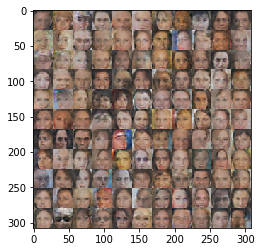

Epoch: 9/16 Discriminator Loss: 0.8134 Generator Loss: 0.8193
Epoch: 9/16 Discriminator Loss: 0.1548 Generator Loss: 3.0823
Epoch: 9/16 Discriminator Loss: 0.9506 Generator Loss: 0.6734
Epoch: 9/16 Discriminator Loss: 0.4576 Generator Loss: 1.4590
Epoch: 9/16 Discriminator Loss: 0.3101 Generator Loss: 1.8756
Epoch: 9/16 Discriminator Loss: 0.2488 Generator Loss: 3.0708
Epoch: 9/16 Discriminator Loss: 0.3822 Generator Loss: 1.6187
Epoch: 9/16 Discriminator Loss: 0.1561 Generator Loss: 5.3591
Epoch: 9/16 Discriminator Loss: 0.1641 Generator Loss: 4.6432
Epoch: 9/16 Discriminator Loss: 0.2135 Generator Loss: 4.4870


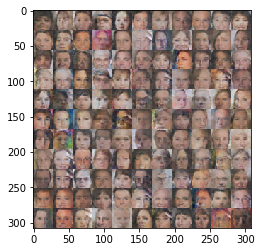

Epoch: 9/16 Discriminator Loss: 0.2972 Generator Loss: 2.6718
Epoch: 9/16 Discriminator Loss: 0.0811 Generator Loss: 4.2696
Epoch: 9/16 Discriminator Loss: 0.0738 Generator Loss: 3.5861
Epoch: 9/16 Discriminator Loss: 4.6129 Generator Loss: 5.3125
Epoch: 9/16 Discriminator Loss: 1.1850 Generator Loss: 0.6419
Epoch: 9/16 Discriminator Loss: 0.4558 Generator Loss: 3.3638
Epoch: 9/16 Discriminator Loss: 0.1416 Generator Loss: 5.2862
Epoch: 9/16 Discriminator Loss: 1.0927 Generator Loss: 0.5816
Epoch: 9/16 Discriminator Loss: 0.6020 Generator Loss: 3.0597
Epoch: 9/16 Discriminator Loss: 0.1236 Generator Loss: 3.5845


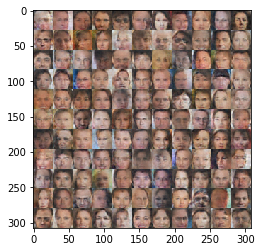

Epoch: 9/16 Discriminator Loss: 0.3775 Generator Loss: 7.0600
Epoch: 9/16 Discriminator Loss: 0.5178 Generator Loss: 1.3149
Epoch: 9/16 Discriminator Loss: 0.3558 Generator Loss: 1.6919
Epoch: 9/16 Discriminator Loss: 0.2135 Generator Loss: 2.2667
Epoch: 9/16 Discriminator Loss: 0.2295 Generator Loss: 2.7664
Epoch: 9/16 Discriminator Loss: 0.0911 Generator Loss: 5.8935
Epoch: 9/16 Discriminator Loss: 1.2694 Generator Loss: 5.4065
Epoch: 9/16 Discriminator Loss: 1.2657 Generator Loss: 0.9789
Epoch: 9/16 Discriminator Loss: 1.0056 Generator Loss: 0.7463
Epoch: 9/16 Discriminator Loss: 0.3892 Generator Loss: 1.6542


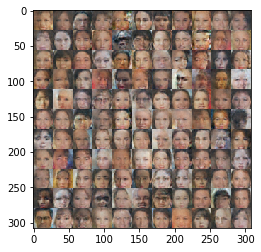

Epoch: 9/16 Discriminator Loss: 0.3772 Generator Loss: 2.5394
Epoch: 9/16 Discriminator Loss: 0.0984 Generator Loss: 4.4766
Epoch: 9/16 Discriminator Loss: 0.2537 Generator Loss: 9.3067
Epoch: 9/16 Discriminator Loss: 0.3291 Generator Loss: 1.6916
Epoch: 9/16 Discriminator Loss: 0.6478 Generator Loss: 1.0714
Epoch: 9/16 Discriminator Loss: 0.7051 Generator Loss: 6.1190
Epoch: 9/16 Discriminator Loss: 0.0798 Generator Loss: 6.0391
Epoch: 9/16 Discriminator Loss: 1.4478 Generator Loss: 0.4446
Epoch: 9/16 Discriminator Loss: 0.4996 Generator Loss: 1.3134
Epoch: 9/16 Discriminator Loss: 0.1099 Generator Loss: 2.8738


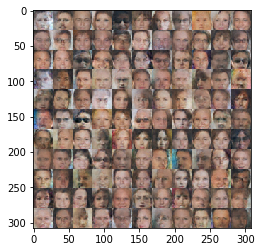

Epoch: 9/16 Discriminator Loss: 0.1116 Generator Loss: 3.7556
Epoch: 9/16 Discriminator Loss: 0.1022 Generator Loss: 3.7401
Epoch: 9/16 Discriminator Loss: 0.7813 Generator Loss: 0.8365
Epoch: 9/16 Discriminator Loss: 0.6100 Generator Loss: 1.5110
Epoch: 9/16 Discriminator Loss: 1.0098 Generator Loss: 0.5879
Epoch: 9/16 Discriminator Loss: 0.8499 Generator Loss: 1.1080
Epoch: 9/16 Discriminator Loss: 0.2651 Generator Loss: 3.2188
Epoch: 9/16 Discriminator Loss: 0.3876 Generator Loss: 1.9755
Epoch: 9/16 Discriminator Loss: 0.4024 Generator Loss: 1.5702
Epoch: 9/16 Discriminator Loss: 0.1057 Generator Loss: 5.0463


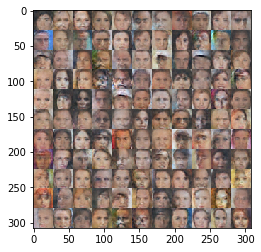

Epoch: 9/16 Discriminator Loss: 0.1814 Generator Loss: 2.4956
Epoch: 9/16 Discriminator Loss: 2.1758 Generator Loss: 0.1631
Epoch: 9/16 Discriminator Loss: 0.5631 Generator Loss: 1.4640
Epoch: 9/16 Discriminator Loss: 0.8247 Generator Loss: 4.0761
Epoch: 9/16 Discriminator Loss: 0.6438 Generator Loss: 1.4768
Epoch: 9/16 Discriminator Loss: 0.4195 Generator Loss: 5.8593
Epoch: 9/16 Discriminator Loss: 0.1517 Generator Loss: 3.2057
Epoch: 9/16 Discriminator Loss: 0.5617 Generator Loss: 1.2465
Epoch: 9/16 Discriminator Loss: 2.9064 Generator Loss: 5.7967
Epoch: 9/16 Discriminator Loss: 0.5300 Generator Loss: 1.3371


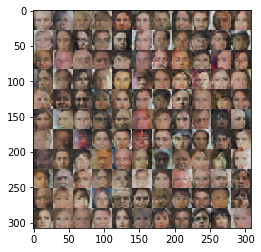

Epoch: 9/16 Discriminator Loss: 0.4299 Generator Loss: 2.8259
Epoch: 9/16 Discriminator Loss: 0.5932 Generator Loss: 3.5615
Epoch: 9/16 Discriminator Loss: 0.8533 Generator Loss: 1.6335
Epoch: 9/16 Discriminator Loss: 0.2476 Generator Loss: 2.4812
Epoch: 9/16 Discriminator Loss: 0.1779 Generator Loss: 4.1298
Epoch: 9/16 Discriminator Loss: 0.6946 Generator Loss: 1.0617
Epoch: 9/16 Discriminator Loss: 0.3265 Generator Loss: 1.6861
Epoch: 9/16 Discriminator Loss: 0.4367 Generator Loss: 6.6129
Epoch: 9/16 Discriminator Loss: 0.0826 Generator Loss: 4.6396
Epoch: 9/16 Discriminator Loss: 3.5143 Generator Loss: 3.4776


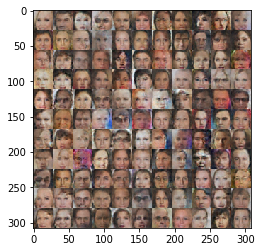

Epoch: 9/16 Discriminator Loss: 0.7672 Generator Loss: 1.6890
Epoch: 9/16 Discriminator Loss: 0.9474 Generator Loss: 0.6985
Epoch: 9/16 Discriminator Loss: 0.4604 Generator Loss: 2.0865
Epoch: 9/16 Discriminator Loss: 0.6469 Generator Loss: 1.0927
Epoch: 9/16 Discriminator Loss: 0.1542 Generator Loss: 3.0239
Epoch: 9/16 Discriminator Loss: 0.3133 Generator Loss: 8.1178
Epoch: 9/16 Discriminator Loss: 0.1524 Generator Loss: 6.9639
Epoch: 9/16 Discriminator Loss: 1.0708 Generator Loss: 1.8285
Epoch: 9/16 Discriminator Loss: 0.1988 Generator Loss: 3.2120
Epoch: 9/16 Discriminator Loss: 0.6523 Generator Loss: 1.5305


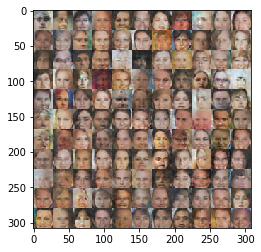

Epoch: 9/16 Discriminator Loss: 0.4969 Generator Loss: 1.3114
Epoch: 9/16 Discriminator Loss: 0.1858 Generator Loss: 3.9576
Epoch: 9/16 Discriminator Loss: 1.2001 Generator Loss: 0.4927
Epoch: 9/16 Discriminator Loss: 0.8409 Generator Loss: 0.7703
Epoch: 9/16 Discriminator Loss: 0.4849 Generator Loss: 2.5213
Epoch: 9/16 Discriminator Loss: 0.9406 Generator Loss: 0.7081
Epoch: 9/16 Discriminator Loss: 0.4207 Generator Loss: 1.6140
Epoch: 9/16 Discriminator Loss: 0.6238 Generator Loss: 1.3035
Epoch: 9/16 Discriminator Loss: 0.3264 Generator Loss: 3.1554
Epoch: 9/16 Discriminator Loss: 0.4104 Generator Loss: 1.4426


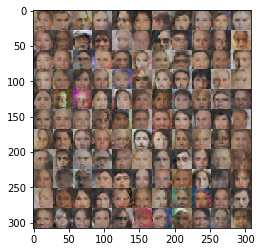

Epoch: 9/16 Discriminator Loss: 0.1147 Generator Loss: 7.6410
Epoch: 9/16 Discriminator Loss: 0.2666 Generator Loss: 4.1382
Epoch: 9/16 Discriminator Loss: 0.0917 Generator Loss: 4.1715
Epoch: 9/16 Discriminator Loss: 0.9274 Generator Loss: 1.8557
Epoch: 9/16 Discriminator Loss: 0.2523 Generator Loss: 3.1867
Epoch: 9/16 Discriminator Loss: 0.1265 Generator Loss: 3.6914
Epoch: 9/16 Discriminator Loss: 0.2691 Generator Loss: 6.7308
Epoch: 9/16 Discriminator Loss: 0.3407 Generator Loss: 3.9670
Epoch: 9/16 Discriminator Loss: 0.2875 Generator Loss: 3.7454
Epoch: 9/16 Discriminator Loss: 0.0790 Generator Loss: 7.4606


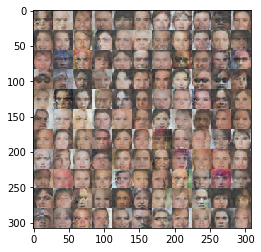

Epoch: 9/16 Discriminator Loss: 0.2368 Generator Loss: 2.2089
Epoch: 9/16 Discriminator Loss: 0.4908 Generator Loss: 1.2597
Epoch: 9/16 Discriminator Loss: 0.0763 Generator Loss: 5.0049
Epoch: 9/16 Discriminator Loss: 0.1853 Generator Loss: 3.5806
Epoch: 9/16 Discriminator Loss: 0.2943 Generator Loss: 2.1976
Epoch: 9/16 Discriminator Loss: 1.8560 Generator Loss: 2.8065
Epoch: 9/16 Discriminator Loss: 0.8766 Generator Loss: 1.0976
Epoch: 9/16 Discriminator Loss: 0.9250 Generator Loss: 0.7863
Epoch: 9/16 Discriminator Loss: 0.5377 Generator Loss: 1.9893
Epoch: 9/16 Discriminator Loss: 2.9214 Generator Loss: 5.2778


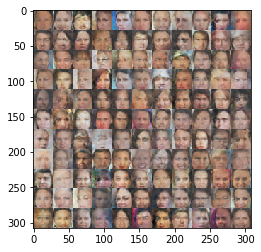

Epoch: 9/16 Discriminator Loss: 0.6125 Generator Loss: 2.0581
Epoch: 9/16 Discriminator Loss: 0.8028 Generator Loss: 0.8339
Epoch: 9/16 Discriminator Loss: 1.7220 Generator Loss: 0.2992
Epoch: 9/16 Discriminator Loss: 0.9078 Generator Loss: 0.8753
Epoch: 9/16 Discriminator Loss: 0.3396 Generator Loss: 1.7682
Epoch: 9/16 Discriminator Loss: 1.2619 Generator Loss: 1.0401
Epoch: 9/16 Discriminator Loss: 0.6093 Generator Loss: 1.9546
Epoch: 9/16 Discriminator Loss: 0.2015 Generator Loss: 3.0237
Epoch: 9/16 Discriminator Loss: 0.2145 Generator Loss: 2.4409
Epoch: 9/16 Discriminator Loss: 0.3867 Generator Loss: 1.4151


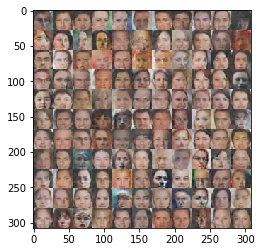

Epoch: 9/16 Discriminator Loss: 0.4010 Generator Loss: 1.8837
Epoch: 9/16 Discriminator Loss: 0.2589 Generator Loss: 1.9805
Epoch: 9/16 Discriminator Loss: 0.2178 Generator Loss: 2.6977
Epoch: 10/16 Discriminator Loss: 0.0607 Generator Loss: 4.5612
Epoch: 10/16 Discriminator Loss: 0.4840 Generator Loss: 1.2656
Epoch: 10/16 Discriminator Loss: 1.0635 Generator Loss: 0.7411
Epoch: 10/16 Discriminator Loss: 0.0925 Generator Loss: 3.6933
Epoch: 10/16 Discriminator Loss: 0.8569 Generator Loss: 0.7180
Epoch: 10/16 Discriminator Loss: 0.9351 Generator Loss: 1.1572
Epoch: 10/16 Discriminator Loss: 0.6369 Generator Loss: 0.9860


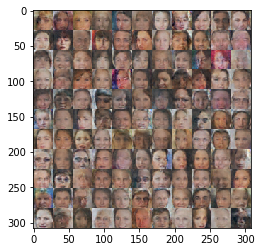

Epoch: 10/16 Discriminator Loss: 1.5097 Generator Loss: 0.3502
Epoch: 10/16 Discriminator Loss: 0.2313 Generator Loss: 2.3091
Epoch: 10/16 Discriminator Loss: 0.8747 Generator Loss: 0.7508
Epoch: 10/16 Discriminator Loss: 0.1952 Generator Loss: 2.4077
Epoch: 10/16 Discriminator Loss: 0.1028 Generator Loss: 3.5613
Epoch: 10/16 Discriminator Loss: 0.3031 Generator Loss: 2.0185
Epoch: 10/16 Discriminator Loss: 1.6470 Generator Loss: 0.2944
Epoch: 10/16 Discriminator Loss: 1.3589 Generator Loss: 0.4264
Epoch: 10/16 Discriminator Loss: 0.5081 Generator Loss: 1.3214
Epoch: 10/16 Discriminator Loss: 0.2719 Generator Loss: 4.4958


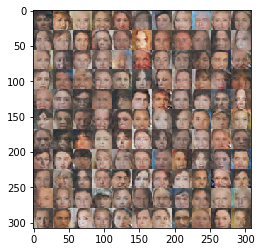

Epoch: 10/16 Discriminator Loss: 0.1718 Generator Loss: 3.0190
Epoch: 10/16 Discriminator Loss: 0.9565 Generator Loss: 0.7089
Epoch: 10/16 Discriminator Loss: 0.6546 Generator Loss: 0.9973
Epoch: 10/16 Discriminator Loss: 0.0378 Generator Loss: 5.2158
Epoch: 10/16 Discriminator Loss: 1.2705 Generator Loss: 0.6212
Epoch: 10/16 Discriminator Loss: 0.7418 Generator Loss: 1.8458
Epoch: 10/16 Discriminator Loss: 0.1460 Generator Loss: 3.7341
Epoch: 10/16 Discriminator Loss: 0.3380 Generator Loss: 1.6250
Epoch: 10/16 Discriminator Loss: 0.2520 Generator Loss: 2.2938
Epoch: 10/16 Discriminator Loss: 0.6463 Generator Loss: 1.0365


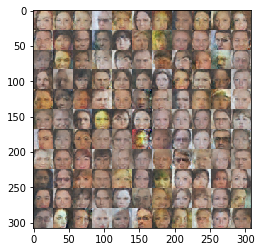

Epoch: 10/16 Discriminator Loss: 0.7474 Generator Loss: 3.3410
Epoch: 10/16 Discriminator Loss: 0.2659 Generator Loss: 1.9320
Epoch: 10/16 Discriminator Loss: 0.0880 Generator Loss: 5.0615
Epoch: 10/16 Discriminator Loss: 0.9352 Generator Loss: 0.6683
Epoch: 10/16 Discriminator Loss: 0.0896 Generator Loss: 4.2564
Epoch: 10/16 Discriminator Loss: 0.3218 Generator Loss: 2.0580
Epoch: 10/16 Discriminator Loss: 0.3228 Generator Loss: 1.7358
Epoch: 10/16 Discriminator Loss: 0.1879 Generator Loss: 2.7363
Epoch: 10/16 Discriminator Loss: 0.1577 Generator Loss: 2.6102
Epoch: 10/16 Discriminator Loss: 0.8229 Generator Loss: 0.8338


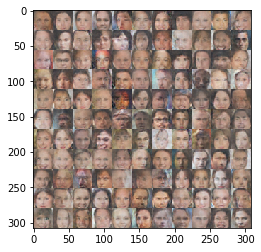

Epoch: 10/16 Discriminator Loss: 0.1693 Generator Loss: 2.8248
Epoch: 10/16 Discriminator Loss: 0.6825 Generator Loss: 1.0103
Epoch: 10/16 Discriminator Loss: 0.2456 Generator Loss: 2.3633
Epoch: 10/16 Discriminator Loss: 0.6466 Generator Loss: 1.0768
Epoch: 10/16 Discriminator Loss: 0.1881 Generator Loss: 2.7469
Epoch: 10/16 Discriminator Loss: 0.9158 Generator Loss: 0.8196
Epoch: 10/16 Discriminator Loss: 0.0962 Generator Loss: 3.8166
Epoch: 10/16 Discriminator Loss: 0.2038 Generator Loss: 2.3849
Epoch: 10/16 Discriminator Loss: 0.0852 Generator Loss: 4.6101
Epoch: 10/16 Discriminator Loss: 0.3249 Generator Loss: 4.0854


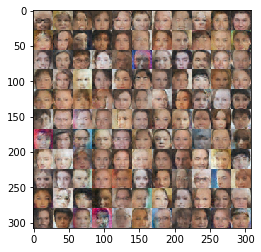

Epoch: 10/16 Discriminator Loss: 1.2889 Generator Loss: 0.5000
Epoch: 10/16 Discriminator Loss: 1.0869 Generator Loss: 3.5879
Epoch: 10/16 Discriminator Loss: 0.1001 Generator Loss: 3.9111
Epoch: 10/16 Discriminator Loss: 0.1487 Generator Loss: 2.5174
Epoch: 10/16 Discriminator Loss: 0.4588 Generator Loss: 1.4282
Epoch: 10/16 Discriminator Loss: 1.2317 Generator Loss: 0.5361
Epoch: 10/16 Discriminator Loss: 0.3680 Generator Loss: 1.8858
Epoch: 10/16 Discriminator Loss: 0.6734 Generator Loss: 1.0094
Epoch: 10/16 Discriminator Loss: 0.7097 Generator Loss: 1.0448
Epoch: 10/16 Discriminator Loss: 0.0587 Generator Loss: 8.4992


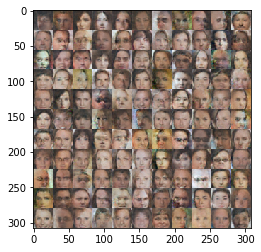

Epoch: 10/16 Discriminator Loss: 0.1049 Generator Loss: 4.3363
Epoch: 10/16 Discriminator Loss: 0.4690 Generator Loss: 1.3844
Epoch: 10/16 Discriminator Loss: 0.2652 Generator Loss: 2.2408
Epoch: 10/16 Discriminator Loss: 0.0475 Generator Loss: 5.2907
Epoch: 10/16 Discriminator Loss: 0.3574 Generator Loss: 1.8581
Epoch: 10/16 Discriminator Loss: 0.7879 Generator Loss: 0.8591
Epoch: 10/16 Discriminator Loss: 0.3462 Generator Loss: 1.8143
Epoch: 10/16 Discriminator Loss: 0.1146 Generator Loss: 3.8517
Epoch: 10/16 Discriminator Loss: 1.5590 Generator Loss: 0.3305
Epoch: 10/16 Discriminator Loss: 1.4146 Generator Loss: 0.4115


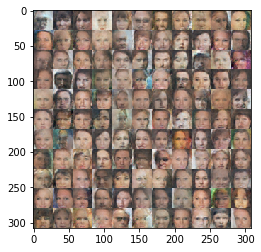

Epoch: 10/16 Discriminator Loss: 0.5629 Generator Loss: 1.2480
Epoch: 10/16 Discriminator Loss: 0.8521 Generator Loss: 1.3721
Epoch: 10/16 Discriminator Loss: 0.6812 Generator Loss: 4.5887
Epoch: 10/16 Discriminator Loss: 0.2110 Generator Loss: 3.7375
Epoch: 10/16 Discriminator Loss: 0.2883 Generator Loss: 6.1709
Epoch: 10/16 Discriminator Loss: 0.1437 Generator Loss: 2.9697
Epoch: 10/16 Discriminator Loss: 0.2061 Generator Loss: 2.4791
Epoch: 10/16 Discriminator Loss: 0.1317 Generator Loss: 3.1100
Epoch: 10/16 Discriminator Loss: 0.1546 Generator Loss: 2.8321
Epoch: 10/16 Discriminator Loss: 0.1501 Generator Loss: 4.0681


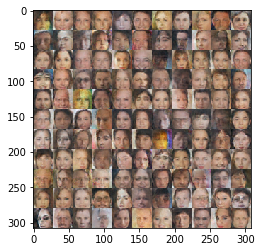

Epoch: 10/16 Discriminator Loss: 0.0610 Generator Loss: 4.5785
Epoch: 10/16 Discriminator Loss: 0.5150 Generator Loss: 1.1914
Epoch: 10/16 Discriminator Loss: 1.8973 Generator Loss: 0.2905
Epoch: 10/16 Discriminator Loss: 1.0733 Generator Loss: 0.6702
Epoch: 10/16 Discriminator Loss: 0.1473 Generator Loss: 3.0551
Epoch: 10/16 Discriminator Loss: 0.0939 Generator Loss: 5.2673
Epoch: 10/16 Discriminator Loss: 0.3862 Generator Loss: 1.6638
Epoch: 10/16 Discriminator Loss: 1.0883 Generator Loss: 4.7015
Epoch: 10/16 Discriminator Loss: 3.0648 Generator Loss: 5.8932
Epoch: 10/16 Discriminator Loss: 0.3714 Generator Loss: 1.6536


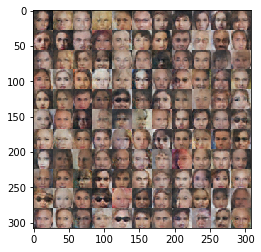

Epoch: 10/16 Discriminator Loss: 0.2282 Generator Loss: 2.5748
Epoch: 10/16 Discriminator Loss: 0.8115 Generator Loss: 2.0643
Epoch: 10/16 Discriminator Loss: 1.4978 Generator Loss: 2.7692
Epoch: 10/16 Discriminator Loss: 0.7064 Generator Loss: 0.8943
Epoch: 10/16 Discriminator Loss: 0.1910 Generator Loss: 3.6770
Epoch: 10/16 Discriminator Loss: 0.3214 Generator Loss: 1.8323
Epoch: 10/16 Discriminator Loss: 0.1766 Generator Loss: 3.2290
Epoch: 10/16 Discriminator Loss: 0.6363 Generator Loss: 1.0294
Epoch: 10/16 Discriminator Loss: 0.1373 Generator Loss: 4.8820
Epoch: 10/16 Discriminator Loss: 0.6179 Generator Loss: 1.0153


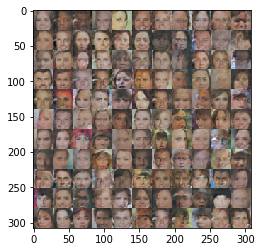

Epoch: 10/16 Discriminator Loss: 0.9345 Generator Loss: 0.6657
Epoch: 10/16 Discriminator Loss: 0.0386 Generator Loss: 4.6426
Epoch: 10/16 Discriminator Loss: 0.1133 Generator Loss: 2.9757
Epoch: 10/16 Discriminator Loss: 2.4074 Generator Loss: 4.5233
Epoch: 10/16 Discriminator Loss: 0.2538 Generator Loss: 2.6833
Epoch: 10/16 Discriminator Loss: 3.0097 Generator Loss: 0.0772
Epoch: 10/16 Discriminator Loss: 0.9783 Generator Loss: 2.3052
Epoch: 10/16 Discriminator Loss: 0.5432 Generator Loss: 1.3212
Epoch: 10/16 Discriminator Loss: 0.0840 Generator Loss: 4.8875
Epoch: 10/16 Discriminator Loss: 0.0880 Generator Loss: 6.0303


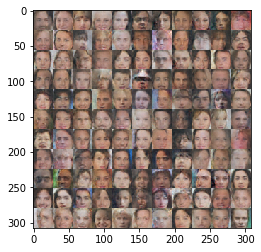

Epoch: 10/16 Discriminator Loss: 0.8153 Generator Loss: 0.7885
Epoch: 10/16 Discriminator Loss: 0.2358 Generator Loss: 2.2359
Epoch: 10/16 Discriminator Loss: 0.0987 Generator Loss: 4.8383
Epoch: 10/16 Discriminator Loss: 0.5188 Generator Loss: 3.1001
Epoch: 10/16 Discriminator Loss: 0.1774 Generator Loss: 2.7592
Epoch: 10/16 Discriminator Loss: 0.1308 Generator Loss: 2.9478
Epoch: 10/16 Discriminator Loss: 0.9629 Generator Loss: 0.6518
Epoch: 10/16 Discriminator Loss: 1.0535 Generator Loss: 0.6420
Epoch: 10/16 Discriminator Loss: 0.8193 Generator Loss: 0.9749
Epoch: 10/16 Discriminator Loss: 1.5437 Generator Loss: 0.3426


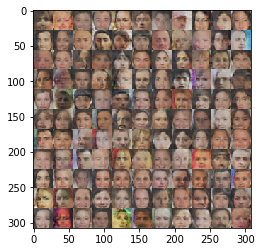

Epoch: 10/16 Discriminator Loss: 0.1841 Generator Loss: 6.4066
Epoch: 10/16 Discriminator Loss: 0.2096 Generator Loss: 3.1620
Epoch: 10/16 Discriminator Loss: 0.0552 Generator Loss: 6.6054
Epoch: 10/16 Discriminator Loss: 0.7309 Generator Loss: 5.4047
Epoch: 10/16 Discriminator Loss: 0.4183 Generator Loss: 5.0267
Epoch: 10/16 Discriminator Loss: 0.0307 Generator Loss: 7.7465
Epoch: 10/16 Discriminator Loss: 0.0475 Generator Loss: 5.3606
Epoch: 10/16 Discriminator Loss: 0.5124 Generator Loss: 1.2305
Epoch: 10/16 Discriminator Loss: 0.5022 Generator Loss: 1.3558
Epoch: 10/16 Discriminator Loss: 0.1382 Generator Loss: 3.9763


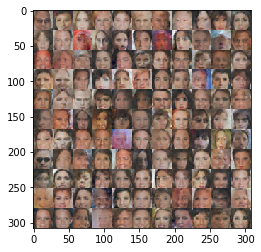

Epoch: 10/16 Discriminator Loss: 0.7998 Generator Loss: 0.8135
Epoch: 10/16 Discriminator Loss: 0.1039 Generator Loss: 7.4857
Epoch: 10/16 Discriminator Loss: 0.0997 Generator Loss: 3.5725
Epoch: 10/16 Discriminator Loss: 0.0573 Generator Loss: 8.8246
Epoch: 10/16 Discriminator Loss: 0.1910 Generator Loss: 2.5072
Epoch: 10/16 Discriminator Loss: 0.0770 Generator Loss: 7.3524
Epoch: 10/16 Discriminator Loss: 0.0278 Generator Loss: 5.8106
Epoch: 10/16 Discriminator Loss: 1.1307 Generator Loss: 0.5237
Epoch: 10/16 Discriminator Loss: 0.5333 Generator Loss: 7.9944
Epoch: 10/16 Discriminator Loss: 3.5753 Generator Loss: 4.0189


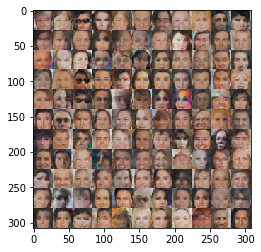

Epoch: 10/16 Discriminator Loss: 0.3082 Generator Loss: 1.9950
Epoch: 10/16 Discriminator Loss: 0.1147 Generator Loss: 4.9207
Epoch: 10/16 Discriminator Loss: 0.0807 Generator Loss: 5.7381
Epoch: 10/16 Discriminator Loss: 0.1611 Generator Loss: 4.6544
Epoch: 10/16 Discriminator Loss: 0.8252 Generator Loss: 0.8175
Epoch: 10/16 Discriminator Loss: 0.7091 Generator Loss: 0.9685
Epoch: 10/16 Discriminator Loss: 0.6301 Generator Loss: 1.1156
Epoch: 10/16 Discriminator Loss: 0.1617 Generator Loss: 3.4260
Epoch: 10/16 Discriminator Loss: 0.0365 Generator Loss: 5.8040
Epoch: 10/16 Discriminator Loss: 0.2641 Generator Loss: 3.2734


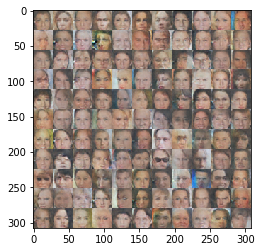

Epoch: 10/16 Discriminator Loss: 0.0506 Generator Loss: 5.0865
Epoch: 10/16 Discriminator Loss: 0.3513 Generator Loss: 1.6288
Epoch: 10/16 Discriminator Loss: 0.6166 Generator Loss: 1.1918
Epoch: 10/16 Discriminator Loss: 0.1863 Generator Loss: 2.7585
Epoch: 10/16 Discriminator Loss: 0.2691 Generator Loss: 2.0890
Epoch: 10/16 Discriminator Loss: 0.0472 Generator Loss: 5.8125
Epoch: 10/16 Discriminator Loss: 0.8491 Generator Loss: 2.7381
Epoch: 10/16 Discriminator Loss: 1.6526 Generator Loss: 0.2958
Epoch: 10/16 Discriminator Loss: 0.5466 Generator Loss: 1.2653
Epoch: 10/16 Discriminator Loss: 0.3253 Generator Loss: 2.2481


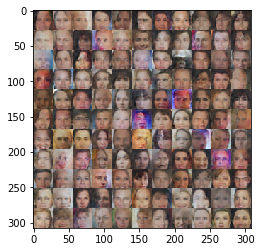

Epoch: 10/16 Discriminator Loss: 0.4161 Generator Loss: 1.5517
Epoch: 10/16 Discriminator Loss: 0.7486 Generator Loss: 2.0218
Epoch: 11/16 Discriminator Loss: 0.7557 Generator Loss: 1.0608
Epoch: 11/16 Discriminator Loss: 1.6186 Generator Loss: 0.3253
Epoch: 11/16 Discriminator Loss: 0.4043 Generator Loss: 1.5508
Epoch: 11/16 Discriminator Loss: 0.3188 Generator Loss: 2.8998
Epoch: 11/16 Discriminator Loss: 0.7594 Generator Loss: 0.8612
Epoch: 11/16 Discriminator Loss: 0.0733 Generator Loss: 5.9729
Epoch: 11/16 Discriminator Loss: 0.0944 Generator Loss: 4.7145
Epoch: 11/16 Discriminator Loss: 0.1226 Generator Loss: 6.1804


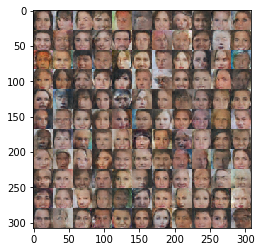

Epoch: 11/16 Discriminator Loss: 1.3770 Generator Loss: 0.4357
Epoch: 11/16 Discriminator Loss: 0.3841 Generator Loss: 2.4670
Epoch: 11/16 Discriminator Loss: 0.1574 Generator Loss: 4.1596
Epoch: 11/16 Discriminator Loss: 0.0829 Generator Loss: 3.9195
Epoch: 11/16 Discriminator Loss: 0.0409 Generator Loss: 9.3125
Epoch: 11/16 Discriminator Loss: 0.2027 Generator Loss: 2.2869
Epoch: 11/16 Discriminator Loss: 0.9157 Generator Loss: 1.1864
Epoch: 11/16 Discriminator Loss: 0.5872 Generator Loss: 1.1897
Epoch: 11/16 Discriminator Loss: 0.2070 Generator Loss: 2.3544
Epoch: 11/16 Discriminator Loss: 1.1415 Generator Loss: 1.8476


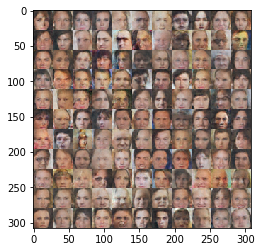

Epoch: 11/16 Discriminator Loss: 0.2021 Generator Loss: 3.3092
Epoch: 11/16 Discriminator Loss: 0.7581 Generator Loss: 0.8435
Epoch: 11/16 Discriminator Loss: 0.1794 Generator Loss: 2.3545
Epoch: 11/16 Discriminator Loss: 0.1592 Generator Loss: 2.5557
Epoch: 11/16 Discriminator Loss: 0.3678 Generator Loss: 2.7924
Epoch: 11/16 Discriminator Loss: 0.6066 Generator Loss: 6.6439
Epoch: 11/16 Discriminator Loss: 0.0531 Generator Loss: 6.1223
Epoch: 11/16 Discriminator Loss: 0.1838 Generator Loss: 2.7774
Epoch: 11/16 Discriminator Loss: 0.2337 Generator Loss: 2.4730
Epoch: 11/16 Discriminator Loss: 2.1851 Generator Loss: 0.1592


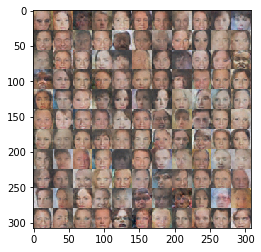

Epoch: 11/16 Discriminator Loss: 0.0539 Generator Loss: 4.2930
Epoch: 11/16 Discriminator Loss: 0.2523 Generator Loss: 2.1507
Epoch: 11/16 Discriminator Loss: 0.5810 Generator Loss: 1.0986
Epoch: 11/16 Discriminator Loss: 0.3133 Generator Loss: 1.8277
Epoch: 11/16 Discriminator Loss: 0.1346 Generator Loss: 5.1048
Epoch: 11/16 Discriminator Loss: 0.0797 Generator Loss: 5.7145
Epoch: 11/16 Discriminator Loss: 0.3020 Generator Loss: 1.8463
Epoch: 11/16 Discriminator Loss: 0.0759 Generator Loss: 5.0231
Epoch: 11/16 Discriminator Loss: 0.1732 Generator Loss: 2.7803
Epoch: 11/16 Discriminator Loss: 0.3934 Generator Loss: 1.9979


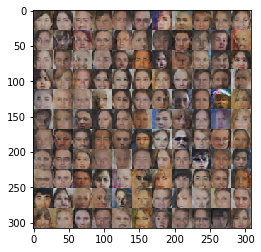

Epoch: 11/16 Discriminator Loss: 0.5278 Generator Loss: 5.0646
Epoch: 11/16 Discriminator Loss: 0.4406 Generator Loss: 1.3855
Epoch: 11/16 Discriminator Loss: 0.0384 Generator Loss: 6.1086
Epoch: 11/16 Discriminator Loss: 0.0985 Generator Loss: 3.7816
Epoch: 11/16 Discriminator Loss: 0.7287 Generator Loss: 3.4282
Epoch: 11/16 Discriminator Loss: 0.4149 Generator Loss: 2.2310
Epoch: 11/16 Discriminator Loss: 0.0697 Generator Loss: 6.8156
Epoch: 11/16 Discriminator Loss: 1.2405 Generator Loss: 0.5212
Epoch: 11/16 Discriminator Loss: 0.1796 Generator Loss: 2.4326
Epoch: 11/16 Discriminator Loss: 1.9629 Generator Loss: 4.7262


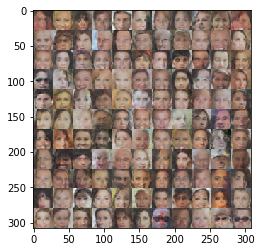

Epoch: 11/16 Discriminator Loss: 0.2474 Generator Loss: 2.0545
Epoch: 11/16 Discriminator Loss: 0.5234 Generator Loss: 1.2352
Epoch: 11/16 Discriminator Loss: 0.1941 Generator Loss: 2.7250
Epoch: 11/16 Discriminator Loss: 0.4357 Generator Loss: 1.3572
Epoch: 11/16 Discriminator Loss: 0.6034 Generator Loss: 1.1506
Epoch: 11/16 Discriminator Loss: 0.3070 Generator Loss: 1.8965
Epoch: 11/16 Discriminator Loss: 0.4340 Generator Loss: 9.1613
Epoch: 11/16 Discriminator Loss: 0.0475 Generator Loss: 6.7534
Epoch: 11/16 Discriminator Loss: 0.9841 Generator Loss: 0.7133
Epoch: 11/16 Discriminator Loss: 0.4192 Generator Loss: 5.3197


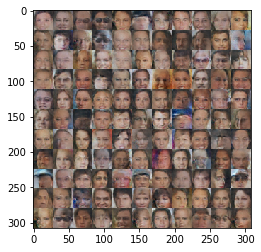

Epoch: 11/16 Discriminator Loss: 0.2815 Generator Loss: 2.5001
Epoch: 11/16 Discriminator Loss: 0.9322 Generator Loss: 0.7163
Epoch: 11/16 Discriminator Loss: 0.6000 Generator Loss: 1.1679
Epoch: 11/16 Discriminator Loss: 1.4371 Generator Loss: 0.4237
Epoch: 11/16 Discriminator Loss: 0.7344 Generator Loss: 0.8914
Epoch: 11/16 Discriminator Loss: 0.0706 Generator Loss: 4.1984
Epoch: 11/16 Discriminator Loss: 0.0609 Generator Loss: 4.5406
Epoch: 11/16 Discriminator Loss: 0.7922 Generator Loss: 0.8074
Epoch: 11/16 Discriminator Loss: 1.3431 Generator Loss: 0.4117
Epoch: 11/16 Discriminator Loss: 0.3211 Generator Loss: 1.9590


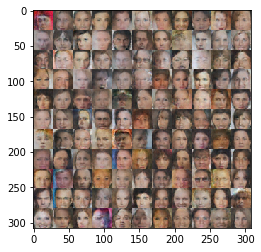

Epoch: 11/16 Discriminator Loss: 1.0454 Generator Loss: 1.2810
Epoch: 11/16 Discriminator Loss: 0.2046 Generator Loss: 3.2621
Epoch: 11/16 Discriminator Loss: 0.8396 Generator Loss: 0.7622
Epoch: 11/16 Discriminator Loss: 0.0907 Generator Loss: 3.5516
Epoch: 11/16 Discriminator Loss: 0.0588 Generator Loss: 6.4812
Epoch: 11/16 Discriminator Loss: 0.3447 Generator Loss: 2.1396
Epoch: 11/16 Discriminator Loss: 4.6936 Generator Loss: 5.7909
Epoch: 11/16 Discriminator Loss: 0.8930 Generator Loss: 0.9017
Epoch: 11/16 Discriminator Loss: 0.2953 Generator Loss: 2.5420
Epoch: 11/16 Discriminator Loss: 0.3737 Generator Loss: 1.8178


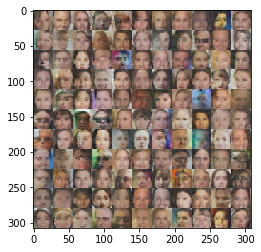

Epoch: 11/16 Discriminator Loss: 0.1447 Generator Loss: 5.9658
Epoch: 11/16 Discriminator Loss: 0.2543 Generator Loss: 2.1810
Epoch: 11/16 Discriminator Loss: 0.2112 Generator Loss: 4.6188
Epoch: 11/16 Discriminator Loss: 0.1879 Generator Loss: 2.3429
Epoch: 11/16 Discriminator Loss: 0.7529 Generator Loss: 0.9418
Epoch: 11/16 Discriminator Loss: 0.0732 Generator Loss: 4.9073
Epoch: 11/16 Discriminator Loss: 1.5309 Generator Loss: 0.4262
Epoch: 11/16 Discriminator Loss: 0.3604 Generator Loss: 2.0955
Epoch: 11/16 Discriminator Loss: 0.2947 Generator Loss: 1.8160
Epoch: 11/16 Discriminator Loss: 0.1928 Generator Loss: 2.3215


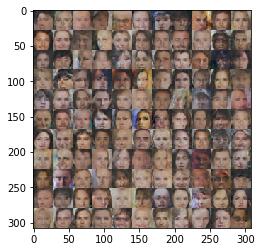

Epoch: 11/16 Discriminator Loss: 1.4787 Generator Loss: 0.5140
Epoch: 11/16 Discriminator Loss: 0.0485 Generator Loss: 5.6499
Epoch: 11/16 Discriminator Loss: 1.8418 Generator Loss: 0.2479
Epoch: 11/16 Discriminator Loss: 0.0810 Generator Loss: 5.1753
Epoch: 11/16 Discriminator Loss: 0.1170 Generator Loss: 4.2512
Epoch: 11/16 Discriminator Loss: 2.2002 Generator Loss: 4.2404
Epoch: 11/16 Discriminator Loss: 0.9115 Generator Loss: 0.7016
Epoch: 11/16 Discriminator Loss: 0.4578 Generator Loss: 1.3321
Epoch: 11/16 Discriminator Loss: 0.2523 Generator Loss: 2.1352
Epoch: 11/16 Discriminator Loss: 0.5561 Generator Loss: 1.2284


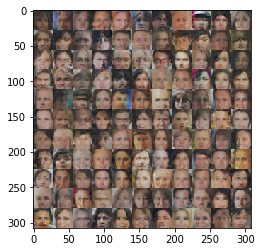

Epoch: 11/16 Discriminator Loss: 0.4554 Generator Loss: 1.3572
Epoch: 11/16 Discriminator Loss: 0.3540 Generator Loss: 4.2919
Epoch: 11/16 Discriminator Loss: 0.1371 Generator Loss: 4.4616
Epoch: 11/16 Discriminator Loss: 0.2446 Generator Loss: 2.0126
Epoch: 11/16 Discriminator Loss: 0.1274 Generator Loss: 2.9695
Epoch: 11/16 Discriminator Loss: 0.1218 Generator Loss: 5.3379
Epoch: 11/16 Discriminator Loss: 0.1141 Generator Loss: 3.5678
Epoch: 11/16 Discriminator Loss: 0.0194 Generator Loss: 6.0011
Epoch: 11/16 Discriminator Loss: 0.1988 Generator Loss: 2.1342
Epoch: 11/16 Discriminator Loss: 0.1392 Generator Loss: 2.5901


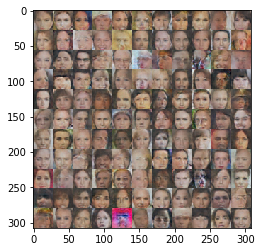

Epoch: 11/16 Discriminator Loss: 0.1485 Generator Loss: 4.4079
Epoch: 11/16 Discriminator Loss: 0.0889 Generator Loss: 3.6143
Epoch: 11/16 Discriminator Loss: 0.4847 Generator Loss: 9.4901
Epoch: 11/16 Discriminator Loss: 1.3142 Generator Loss: 2.8665
Epoch: 11/16 Discriminator Loss: 0.8045 Generator Loss: 1.1112
Epoch: 11/16 Discriminator Loss: 1.3314 Generator Loss: 0.4208
Epoch: 11/16 Discriminator Loss: 1.2122 Generator Loss: 0.5071
Epoch: 11/16 Discriminator Loss: 0.4319 Generator Loss: 1.7213
Epoch: 11/16 Discriminator Loss: 0.1541 Generator Loss: 3.0142
Epoch: 11/16 Discriminator Loss: 0.3662 Generator Loss: 1.7405


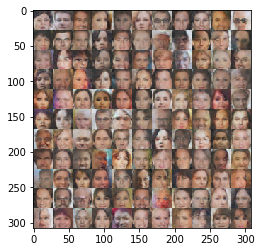

Epoch: 11/16 Discriminator Loss: 0.3692 Generator Loss: 1.4885
Epoch: 11/16 Discriminator Loss: 0.1731 Generator Loss: 2.3600
Epoch: 11/16 Discriminator Loss: 0.2090 Generator Loss: 2.4291
Epoch: 11/16 Discriminator Loss: 0.6268 Generator Loss: 2.4761
Epoch: 11/16 Discriminator Loss: 0.1209 Generator Loss: 7.3147
Epoch: 11/16 Discriminator Loss: 0.9631 Generator Loss: 0.6391
Epoch: 11/16 Discriminator Loss: 0.8034 Generator Loss: 1.0106
Epoch: 11/16 Discriminator Loss: 0.5535 Generator Loss: 1.1680
Epoch: 11/16 Discriminator Loss: 0.0818 Generator Loss: 3.5896
Epoch: 11/16 Discriminator Loss: 0.6213 Generator Loss: 1.7074


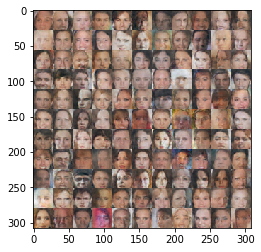

Epoch: 11/16 Discriminator Loss: 0.1766 Generator Loss: 2.4022
Epoch: 11/16 Discriminator Loss: 0.4343 Generator Loss: 1.6230
Epoch: 11/16 Discriminator Loss: 0.3790 Generator Loss: 1.6637
Epoch: 11/16 Discriminator Loss: 0.9084 Generator Loss: 0.7835
Epoch: 11/16 Discriminator Loss: 0.1127 Generator Loss: 4.7256
Epoch: 11/16 Discriminator Loss: 0.2560 Generator Loss: 2.5064
Epoch: 11/16 Discriminator Loss: 0.6449 Generator Loss: 0.9808
Epoch: 11/16 Discriminator Loss: 0.5168 Generator Loss: 6.6332
Epoch: 11/16 Discriminator Loss: 0.1013 Generator Loss: 3.8232
Epoch: 11/16 Discriminator Loss: 0.1759 Generator Loss: 2.6730


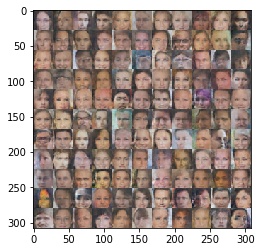

Epoch: 11/16 Discriminator Loss: 0.0524 Generator Loss: 5.8410
Epoch: 11/16 Discriminator Loss: 0.6953 Generator Loss: 2.0616
Epoch: 11/16 Discriminator Loss: 0.6649 Generator Loss: 1.0225
Epoch: 11/16 Discriminator Loss: 2.0258 Generator Loss: 0.2127
Epoch: 11/16 Discriminator Loss: 0.0990 Generator Loss: 3.6407
Epoch: 11/16 Discriminator Loss: 0.0718 Generator Loss: 3.7852
Epoch: 11/16 Discriminator Loss: 0.1120 Generator Loss: 3.1936
Epoch: 11/16 Discriminator Loss: 0.1252 Generator Loss: 3.6762
Epoch: 11/16 Discriminator Loss: 0.2795 Generator Loss: 2.1893
Epoch: 11/16 Discriminator Loss: 0.0859 Generator Loss: 4.2626


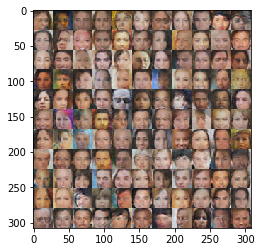

Epoch: 11/16 Discriminator Loss: 0.0895 Generator Loss: 3.2406
Epoch: 11/16 Discriminator Loss: 0.0654 Generator Loss: 3.4756
Epoch: 11/16 Discriminator Loss: 0.8256 Generator Loss: 0.9098
Epoch: 11/16 Discriminator Loss: 0.7616 Generator Loss: 0.8481
Epoch: 11/16 Discriminator Loss: 0.1031 Generator Loss: 4.0021
Epoch: 11/16 Discriminator Loss: 0.7575 Generator Loss: 1.4852
Epoch: 11/16 Discriminator Loss: 0.5330 Generator Loss: 1.3470
Epoch: 11/16 Discriminator Loss: 0.1545 Generator Loss: 2.5701
Epoch: 11/16 Discriminator Loss: 0.1904 Generator Loss: 3.5300
Epoch: 11/16 Discriminator Loss: 0.1120 Generator Loss: 3.3497


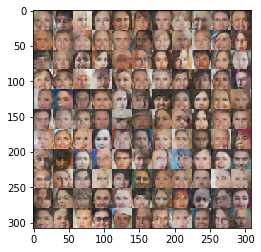

Epoch: 12/16 Discriminator Loss: 1.1581 Generator Loss: 0.5220
Epoch: 12/16 Discriminator Loss: 1.2831 Generator Loss: 0.4688
Epoch: 12/16 Discriminator Loss: 0.2361 Generator Loss: 3.0595
Epoch: 12/16 Discriminator Loss: 0.1150 Generator Loss: 5.8884
Epoch: 12/16 Discriminator Loss: 0.0999 Generator Loss: 4.1421
Epoch: 12/16 Discriminator Loss: 0.1531 Generator Loss: 2.9071
Epoch: 12/16 Discriminator Loss: 0.0862 Generator Loss: 3.7417
Epoch: 12/16 Discriminator Loss: 0.1330 Generator Loss: 2.9412
Epoch: 12/16 Discriminator Loss: 0.4132 Generator Loss: 2.5838
Epoch: 12/16 Discriminator Loss: 0.1720 Generator Loss: 3.0748


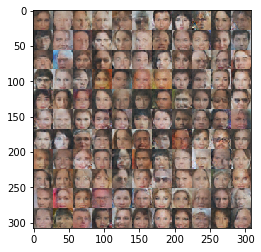

Epoch: 12/16 Discriminator Loss: 0.5302 Generator Loss: 2.2120
Epoch: 12/16 Discriminator Loss: 0.6734 Generator Loss: 3.8615
Epoch: 12/16 Discriminator Loss: 0.6997 Generator Loss: 2.8076
Epoch: 12/16 Discriminator Loss: 3.5740 Generator Loss: 5.0110
Epoch: 12/16 Discriminator Loss: 0.9330 Generator Loss: 0.7943
Epoch: 12/16 Discriminator Loss: 0.3847 Generator Loss: 3.2834
Epoch: 12/16 Discriminator Loss: 1.0919 Generator Loss: 0.5967
Epoch: 12/16 Discriminator Loss: 0.7331 Generator Loss: 0.9707
Epoch: 12/16 Discriminator Loss: 0.5779 Generator Loss: 2.8105
Epoch: 12/16 Discriminator Loss: 0.6874 Generator Loss: 0.9622


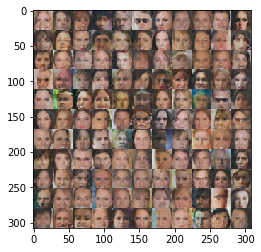

Epoch: 12/16 Discriminator Loss: 0.5279 Generator Loss: 1.9781
Epoch: 12/16 Discriminator Loss: 0.3049 Generator Loss: 2.0005
Epoch: 12/16 Discriminator Loss: 0.8778 Generator Loss: 0.7586
Epoch: 12/16 Discriminator Loss: 0.0834 Generator Loss: 6.0345
Epoch: 12/16 Discriminator Loss: 0.2744 Generator Loss: 2.5005
Epoch: 12/16 Discriminator Loss: 0.5559 Generator Loss: 1.1606
Epoch: 12/16 Discriminator Loss: 0.4928 Generator Loss: 5.7133
Epoch: 12/16 Discriminator Loss: 0.8011 Generator Loss: 0.8973
Epoch: 12/16 Discriminator Loss: 0.2780 Generator Loss: 2.2140
Epoch: 12/16 Discriminator Loss: 0.1565 Generator Loss: 4.5421


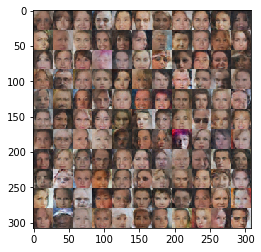

Epoch: 12/16 Discriminator Loss: 0.2261 Generator Loss: 3.1252
Epoch: 12/16 Discriminator Loss: 0.1939 Generator Loss: 3.1886
Epoch: 12/16 Discriminator Loss: 0.1913 Generator Loss: 2.3724
Epoch: 12/16 Discriminator Loss: 0.1757 Generator Loss: 2.3178
Epoch: 12/16 Discriminator Loss: 0.1548 Generator Loss: 3.9853
Epoch: 12/16 Discriminator Loss: 0.3096 Generator Loss: 2.4210
Epoch: 12/16 Discriminator Loss: 0.6500 Generator Loss: 1.8523
Epoch: 12/16 Discriminator Loss: 2.0320 Generator Loss: 4.1202
Epoch: 12/16 Discriminator Loss: 0.5371 Generator Loss: 1.5097
Epoch: 12/16 Discriminator Loss: 0.4592 Generator Loss: 1.7400


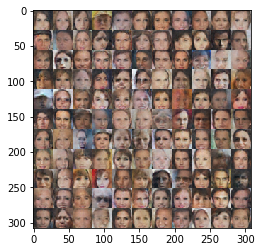

Epoch: 12/16 Discriminator Loss: 0.2038 Generator Loss: 3.6885
Epoch: 12/16 Discriminator Loss: 0.1085 Generator Loss: 3.2293
Epoch: 12/16 Discriminator Loss: 0.9064 Generator Loss: 0.6805
Epoch: 12/16 Discriminator Loss: 0.5596 Generator Loss: 2.0010
Epoch: 12/16 Discriminator Loss: 1.3462 Generator Loss: 5.0154
Epoch: 12/16 Discriminator Loss: 0.2751 Generator Loss: 2.1858
Epoch: 12/16 Discriminator Loss: 0.6017 Generator Loss: 2.4769
Epoch: 12/16 Discriminator Loss: 0.2129 Generator Loss: 2.4040
Epoch: 12/16 Discriminator Loss: 0.1093 Generator Loss: 3.6494
Epoch: 12/16 Discriminator Loss: 0.4133 Generator Loss: 5.8336


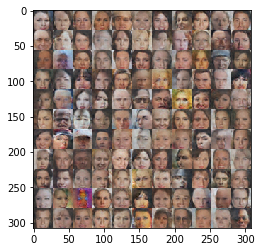

Epoch: 12/16 Discriminator Loss: 0.0698 Generator Loss: 4.8626
Epoch: 12/16 Discriminator Loss: 1.0954 Generator Loss: 0.7883
Epoch: 12/16 Discriminator Loss: 1.1566 Generator Loss: 2.2117
Epoch: 12/16 Discriminator Loss: 0.2928 Generator Loss: 1.8526
Epoch: 12/16 Discriminator Loss: 0.3708 Generator Loss: 1.5911
Epoch: 12/16 Discriminator Loss: 0.2955 Generator Loss: 1.7489
Epoch: 12/16 Discriminator Loss: 1.2038 Generator Loss: 0.4898
Epoch: 12/16 Discriminator Loss: 0.4170 Generator Loss: 3.0366
Epoch: 12/16 Discriminator Loss: 0.1661 Generator Loss: 4.3317
Epoch: 12/16 Discriminator Loss: 0.0694 Generator Loss: 7.0963


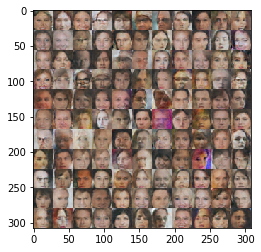

Epoch: 12/16 Discriminator Loss: 0.1653 Generator Loss: 2.4945
Epoch: 12/16 Discriminator Loss: 0.2326 Generator Loss: 3.6906
Epoch: 12/16 Discriminator Loss: 0.4286 Generator Loss: 1.7592
Epoch: 12/16 Discriminator Loss: 1.1501 Generator Loss: 0.5275
Epoch: 12/16 Discriminator Loss: 0.5663 Generator Loss: 1.2400
Epoch: 12/16 Discriminator Loss: 0.2009 Generator Loss: 2.1592
Epoch: 12/16 Discriminator Loss: 0.2712 Generator Loss: 2.1407
Epoch: 12/16 Discriminator Loss: 0.5869 Generator Loss: 2.9467
Epoch: 12/16 Discriminator Loss: 0.2498 Generator Loss: 2.1688
Epoch: 12/16 Discriminator Loss: 0.4125 Generator Loss: 1.8066


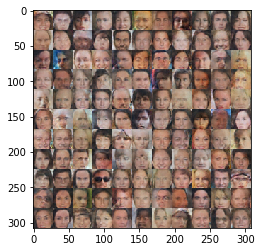

Epoch: 12/16 Discriminator Loss: 0.3317 Generator Loss: 1.9628
Epoch: 12/16 Discriminator Loss: 1.6236 Generator Loss: 0.3555
Epoch: 12/16 Discriminator Loss: 0.1825 Generator Loss: 2.7558
Epoch: 12/16 Discriminator Loss: 0.7054 Generator Loss: 0.9253
Epoch: 12/16 Discriminator Loss: 0.0916 Generator Loss: 4.0787
Epoch: 12/16 Discriminator Loss: 0.1023 Generator Loss: 4.8498
Epoch: 12/16 Discriminator Loss: 0.6136 Generator Loss: 1.4799
Epoch: 12/16 Discriminator Loss: 0.5977 Generator Loss: 3.1549
Epoch: 12/16 Discriminator Loss: 0.0742 Generator Loss: 3.8951
Epoch: 12/16 Discriminator Loss: 0.2571 Generator Loss: 2.0493


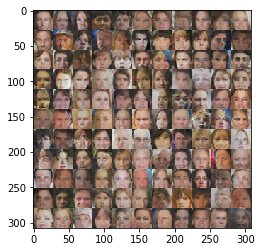

Epoch: 12/16 Discriminator Loss: 0.8310 Generator Loss: 1.5498
Epoch: 12/16 Discriminator Loss: 0.0835 Generator Loss: 3.6552
Epoch: 12/16 Discriminator Loss: 0.0627 Generator Loss: 4.5490
Epoch: 12/16 Discriminator Loss: 0.1348 Generator Loss: 2.6082
Epoch: 12/16 Discriminator Loss: 0.1076 Generator Loss: 4.3518
Epoch: 12/16 Discriminator Loss: 0.0678 Generator Loss: 3.6568
Epoch: 12/16 Discriminator Loss: 0.5997 Generator Loss: 3.3638
Epoch: 12/16 Discriminator Loss: 0.1584 Generator Loss: 2.4304
Epoch: 12/16 Discriminator Loss: 1.1722 Generator Loss: 0.8707
Epoch: 12/16 Discriminator Loss: 0.2844 Generator Loss: 2.1106


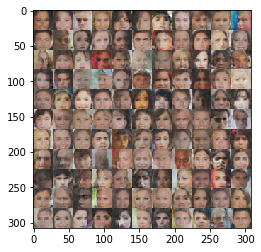

Epoch: 12/16 Discriminator Loss: 1.4074 Generator Loss: 0.4319
Epoch: 12/16 Discriminator Loss: 0.6800 Generator Loss: 1.2095
Epoch: 12/16 Discriminator Loss: 0.3320 Generator Loss: 1.7653
Epoch: 12/16 Discriminator Loss: 0.0699 Generator Loss: 7.8772
Epoch: 12/16 Discriminator Loss: 0.9895 Generator Loss: 0.8764
Epoch: 12/16 Discriminator Loss: 0.2425 Generator Loss: 2.2651
Epoch: 12/16 Discriminator Loss: 0.4014 Generator Loss: 1.4791
Epoch: 12/16 Discriminator Loss: 0.3627 Generator Loss: 3.8702
Epoch: 12/16 Discriminator Loss: 0.0867 Generator Loss: 5.2526
Epoch: 12/16 Discriminator Loss: 0.0718 Generator Loss: 5.4557


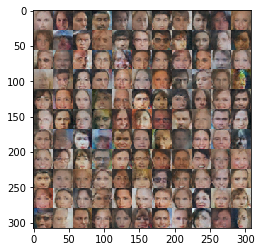

Epoch: 12/16 Discriminator Loss: 0.6991 Generator Loss: 1.0439
Epoch: 12/16 Discriminator Loss: 0.7865 Generator Loss: 0.9735
Epoch: 12/16 Discriminator Loss: 0.5253 Generator Loss: 1.2378
Epoch: 12/16 Discriminator Loss: 1.0550 Generator Loss: 0.6613
Epoch: 12/16 Discriminator Loss: 0.4263 Generator Loss: 1.5263
Epoch: 12/16 Discriminator Loss: 0.0666 Generator Loss: 7.0959
Epoch: 12/16 Discriminator Loss: 0.0723 Generator Loss: 3.7731
Epoch: 12/16 Discriminator Loss: 1.7586 Generator Loss: 3.8857
Epoch: 12/16 Discriminator Loss: 0.8516 Generator Loss: 0.9133
Epoch: 12/16 Discriminator Loss: 0.1550 Generator Loss: 3.7985


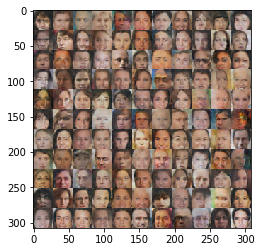

Epoch: 12/16 Discriminator Loss: 1.5581 Generator Loss: 1.5963
Epoch: 12/16 Discriminator Loss: 0.7242 Generator Loss: 0.9728
Epoch: 12/16 Discriminator Loss: 0.5841 Generator Loss: 1.7455
Epoch: 12/16 Discriminator Loss: 0.5689 Generator Loss: 1.2341
Epoch: 12/16 Discriminator Loss: 0.5563 Generator Loss: 1.4626
Epoch: 12/16 Discriminator Loss: 0.6686 Generator Loss: 1.4395
Epoch: 12/16 Discriminator Loss: 0.7621 Generator Loss: 1.4106
Epoch: 12/16 Discriminator Loss: 0.6129 Generator Loss: 1.0201
Epoch: 12/16 Discriminator Loss: 0.1771 Generator Loss: 3.0721
Epoch: 12/16 Discriminator Loss: 1.1657 Generator Loss: 0.5521


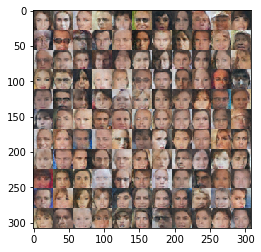

Epoch: 12/16 Discriminator Loss: 1.3785 Generator Loss: 0.4357
Epoch: 12/16 Discriminator Loss: 0.1321 Generator Loss: 3.4051
Epoch: 12/16 Discriminator Loss: 0.4696 Generator Loss: 1.3909
Epoch: 12/16 Discriminator Loss: 0.4365 Generator Loss: 1.8527
Epoch: 12/16 Discriminator Loss: 0.7240 Generator Loss: 1.6189
Epoch: 12/16 Discriminator Loss: 0.3528 Generator Loss: 2.1370
Epoch: 12/16 Discriminator Loss: 0.3238 Generator Loss: 1.7852
Epoch: 12/16 Discriminator Loss: 0.7308 Generator Loss: 0.8977
Epoch: 12/16 Discriminator Loss: 0.4979 Generator Loss: 2.4963
Epoch: 12/16 Discriminator Loss: 0.2636 Generator Loss: 4.8545


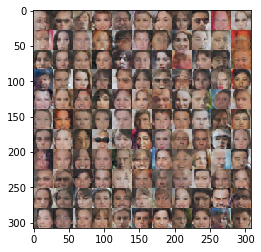

Epoch: 12/16 Discriminator Loss: 0.3492 Generator Loss: 1.4955
Epoch: 12/16 Discriminator Loss: 0.6395 Generator Loss: 3.9173
Epoch: 12/16 Discriminator Loss: 1.2991 Generator Loss: 2.0949
Epoch: 12/16 Discriminator Loss: 0.1010 Generator Loss: 3.5149
Epoch: 12/16 Discriminator Loss: 1.1323 Generator Loss: 1.6550
Epoch: 12/16 Discriminator Loss: 0.1287 Generator Loss: 5.4195
Epoch: 12/16 Discriminator Loss: 0.0835 Generator Loss: 4.1182
Epoch: 12/16 Discriminator Loss: 1.5669 Generator Loss: 3.2615
Epoch: 12/16 Discriminator Loss: 0.4940 Generator Loss: 1.4134
Epoch: 12/16 Discriminator Loss: 0.5943 Generator Loss: 1.1894


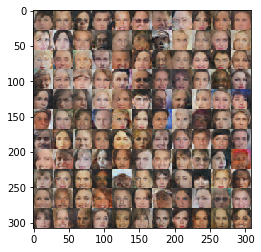

Epoch: 12/16 Discriminator Loss: 0.3050 Generator Loss: 2.0894
Epoch: 12/16 Discriminator Loss: 0.1541 Generator Loss: 3.4033
Epoch: 12/16 Discriminator Loss: 0.6794 Generator Loss: 2.0910
Epoch: 12/16 Discriminator Loss: 0.6746 Generator Loss: 0.9421
Epoch: 12/16 Discriminator Loss: 0.4705 Generator Loss: 1.6798
Epoch: 12/16 Discriminator Loss: 0.6295 Generator Loss: 1.0712
Epoch: 12/16 Discriminator Loss: 0.5154 Generator Loss: 5.4556
Epoch: 12/16 Discriminator Loss: 0.1137 Generator Loss: 4.8385
Epoch: 12/16 Discriminator Loss: 0.2222 Generator Loss: 4.3521
Epoch: 12/16 Discriminator Loss: 0.4542 Generator Loss: 1.3826


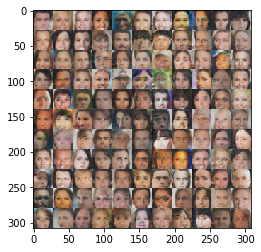

Epoch: 12/16 Discriminator Loss: 0.5265 Generator Loss: 1.5557
Epoch: 12/16 Discriminator Loss: 0.8971 Generator Loss: 0.7249
Epoch: 12/16 Discriminator Loss: 0.1274 Generator Loss: 4.6991
Epoch: 12/16 Discriminator Loss: 0.2103 Generator Loss: 2.5797
Epoch: 12/16 Discriminator Loss: 0.0810 Generator Loss: 5.2400
Epoch: 12/16 Discriminator Loss: 0.2118 Generator Loss: 2.4258
Epoch: 12/16 Discriminator Loss: 0.3135 Generator Loss: 2.4177
Epoch: 12/16 Discriminator Loss: 0.4084 Generator Loss: 1.3581
Epoch: 13/16 Discriminator Loss: 0.1375 Generator Loss: 3.0333
Epoch: 13/16 Discriminator Loss: 0.1953 Generator Loss: 3.3015


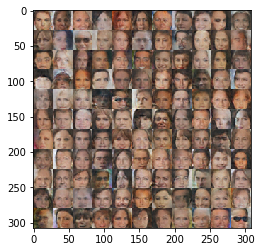

Epoch: 13/16 Discriminator Loss: 0.3873 Generator Loss: 1.7693
Epoch: 13/16 Discriminator Loss: 0.0910 Generator Loss: 6.4553
Epoch: 13/16 Discriminator Loss: 0.4382 Generator Loss: 1.3937
Epoch: 13/16 Discriminator Loss: 0.8347 Generator Loss: 0.7705
Epoch: 13/16 Discriminator Loss: 0.2272 Generator Loss: 8.0125
Epoch: 13/16 Discriminator Loss: 0.1253 Generator Loss: 3.4641
Epoch: 13/16 Discriminator Loss: 0.1270 Generator Loss: 2.9220
Epoch: 13/16 Discriminator Loss: 1.7499 Generator Loss: 0.2761
Epoch: 13/16 Discriminator Loss: 0.2839 Generator Loss: 3.0775
Epoch: 13/16 Discriminator Loss: 0.3952 Generator Loss: 2.2450


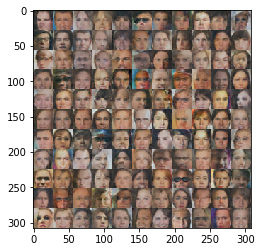

Epoch: 13/16 Discriminator Loss: 0.3752 Generator Loss: 1.6795
Epoch: 13/16 Discriminator Loss: 0.1300 Generator Loss: 3.3594
Epoch: 13/16 Discriminator Loss: 0.0614 Generator Loss: 4.7998
Epoch: 13/16 Discriminator Loss: 1.3893 Generator Loss: 0.3936
Epoch: 13/16 Discriminator Loss: 0.2896 Generator Loss: 1.8896
Epoch: 13/16 Discriminator Loss: 0.3808 Generator Loss: 1.6251
Epoch: 13/16 Discriminator Loss: 0.8745 Generator Loss: 0.7297
Epoch: 13/16 Discriminator Loss: 1.3982 Generator Loss: 0.4077
Epoch: 13/16 Discriminator Loss: 1.0410 Generator Loss: 3.2633
Epoch: 13/16 Discriminator Loss: 0.3678 Generator Loss: 7.3515


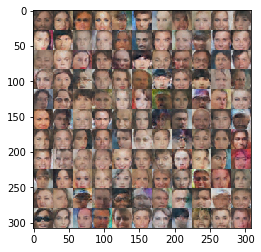

Epoch: 13/16 Discriminator Loss: 0.6121 Generator Loss: 3.1395
Epoch: 13/16 Discriminator Loss: 0.1218 Generator Loss: 5.0749
Epoch: 13/16 Discriminator Loss: 0.3884 Generator Loss: 1.6102
Epoch: 13/16 Discriminator Loss: 0.2184 Generator Loss: 2.3344
Epoch: 13/16 Discriminator Loss: 0.0910 Generator Loss: 4.0538
Epoch: 13/16 Discriminator Loss: 0.4204 Generator Loss: 2.3522
Epoch: 13/16 Discriminator Loss: 0.9428 Generator Loss: 1.3045
Epoch: 13/16 Discriminator Loss: 0.7541 Generator Loss: 0.9389
Epoch: 13/16 Discriminator Loss: 0.5809 Generator Loss: 1.1446
Epoch: 13/16 Discriminator Loss: 3.1617 Generator Loss: 4.9120


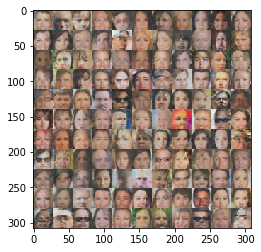

Epoch: 13/16 Discriminator Loss: 0.6173 Generator Loss: 1.2037
Epoch: 13/16 Discriminator Loss: 0.4294 Generator Loss: 1.5672
Epoch: 13/16 Discriminator Loss: 0.3921 Generator Loss: 1.5404
Epoch: 13/16 Discriminator Loss: 0.2280 Generator Loss: 2.1587
Epoch: 13/16 Discriminator Loss: 0.0924 Generator Loss: 3.6800
Epoch: 13/16 Discriminator Loss: 1.4238 Generator Loss: 0.4080
Epoch: 13/16 Discriminator Loss: 0.1501 Generator Loss: 4.4506
Epoch: 13/16 Discriminator Loss: 0.2857 Generator Loss: 1.9333
Epoch: 13/16 Discriminator Loss: 0.2817 Generator Loss: 1.7837
Epoch: 13/16 Discriminator Loss: 0.7719 Generator Loss: 1.2905


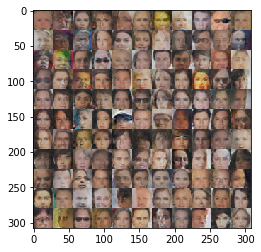

Epoch: 13/16 Discriminator Loss: 0.1248 Generator Loss: 3.1720
Epoch: 13/16 Discriminator Loss: 0.3641 Generator Loss: 1.7234
Epoch: 13/16 Discriminator Loss: 0.5228 Generator Loss: 2.3485
Epoch: 13/16 Discriminator Loss: 0.5175 Generator Loss: 1.5309
Epoch: 13/16 Discriminator Loss: 0.6512 Generator Loss: 1.0472
Epoch: 13/16 Discriminator Loss: 0.1175 Generator Loss: 3.4637
Epoch: 13/16 Discriminator Loss: 0.9056 Generator Loss: 0.7384
Epoch: 13/16 Discriminator Loss: 2.5381 Generator Loss: 0.1153
Epoch: 13/16 Discriminator Loss: 0.6352 Generator Loss: 1.1326
Epoch: 13/16 Discriminator Loss: 0.7389 Generator Loss: 0.9471


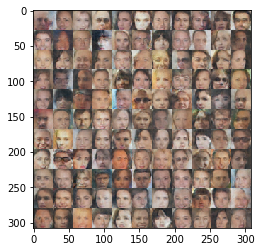

Epoch: 13/16 Discriminator Loss: 2.1709 Generator Loss: 0.1994
Epoch: 13/16 Discriminator Loss: 1.1571 Generator Loss: 0.5109
Epoch: 13/16 Discriminator Loss: 0.7868 Generator Loss: 0.9099
Epoch: 13/16 Discriminator Loss: 0.8380 Generator Loss: 0.8586
Epoch: 13/16 Discriminator Loss: 0.9370 Generator Loss: 0.7098
Epoch: 13/16 Discriminator Loss: 0.6607 Generator Loss: 1.0456
Epoch: 13/16 Discriminator Loss: 0.0757 Generator Loss: 4.9478
Epoch: 13/16 Discriminator Loss: 0.4293 Generator Loss: 1.3979
Epoch: 13/16 Discriminator Loss: 0.6980 Generator Loss: 1.0768
Epoch: 13/16 Discriminator Loss: 0.4909 Generator Loss: 2.8774


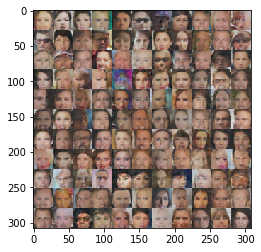

Epoch: 13/16 Discriminator Loss: 0.3312 Generator Loss: 1.7888
Epoch: 13/16 Discriminator Loss: 0.1743 Generator Loss: 2.5829
Epoch: 13/16 Discriminator Loss: 0.4060 Generator Loss: 3.2932
Epoch: 13/16 Discriminator Loss: 0.7807 Generator Loss: 0.9129
Epoch: 13/16 Discriminator Loss: 1.0163 Generator Loss: 0.5949
Epoch: 13/16 Discriminator Loss: 0.2570 Generator Loss: 3.7962
Epoch: 13/16 Discriminator Loss: 0.6274 Generator Loss: 1.3921
Epoch: 13/16 Discriminator Loss: 0.0415 Generator Loss: 5.7123
Epoch: 13/16 Discriminator Loss: 0.3166 Generator Loss: 2.9913
Epoch: 13/16 Discriminator Loss: 0.0823 Generator Loss: 5.1795


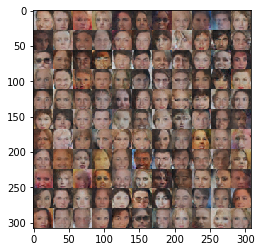

Epoch: 13/16 Discriminator Loss: 0.5832 Generator Loss: 1.1182
Epoch: 13/16 Discriminator Loss: 0.4422 Generator Loss: 1.8635
Epoch: 13/16 Discriminator Loss: 0.1593 Generator Loss: 3.4913
Epoch: 13/16 Discriminator Loss: 0.2094 Generator Loss: 2.4502
Epoch: 13/16 Discriminator Loss: 0.4778 Generator Loss: 1.9012
Epoch: 13/16 Discriminator Loss: 0.2001 Generator Loss: 2.1615
Epoch: 13/16 Discriminator Loss: 0.2472 Generator Loss: 2.0022
Epoch: 13/16 Discriminator Loss: 0.3149 Generator Loss: 1.6523
Epoch: 13/16 Discriminator Loss: 0.4167 Generator Loss: 1.6986
Epoch: 13/16 Discriminator Loss: 0.1266 Generator Loss: 3.3915


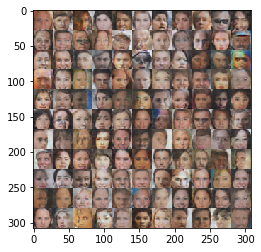

Epoch: 13/16 Discriminator Loss: 0.1127 Generator Loss: 3.1889
Epoch: 13/16 Discriminator Loss: 0.1966 Generator Loss: 3.2930
Epoch: 13/16 Discriminator Loss: 0.2435 Generator Loss: 7.0579
Epoch: 13/16 Discriminator Loss: 0.2028 Generator Loss: 5.2453
Epoch: 13/16 Discriminator Loss: 0.4348 Generator Loss: 1.3910
Epoch: 13/16 Discriminator Loss: 0.4150 Generator Loss: 1.7579
Epoch: 13/16 Discriminator Loss: 0.0807 Generator Loss: 3.3860
Epoch: 13/16 Discriminator Loss: 0.0792 Generator Loss: 6.1752
Epoch: 13/16 Discriminator Loss: 0.3076 Generator Loss: 2.6714
Epoch: 13/16 Discriminator Loss: 1.3547 Generator Loss: 0.4369


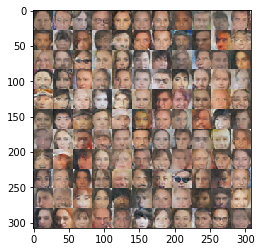

Epoch: 13/16 Discriminator Loss: 0.2399 Generator Loss: 2.5453
Epoch: 13/16 Discriminator Loss: 0.6028 Generator Loss: 1.1309
Epoch: 13/16 Discriminator Loss: 0.1826 Generator Loss: 3.2189
Epoch: 13/16 Discriminator Loss: 0.4920 Generator Loss: 1.4425
Epoch: 13/16 Discriminator Loss: 0.5971 Generator Loss: 1.1119
Epoch: 13/16 Discriminator Loss: 1.1465 Generator Loss: 4.9954
Epoch: 13/16 Discriminator Loss: 1.3305 Generator Loss: 0.5386
Epoch: 13/16 Discriminator Loss: 0.2304 Generator Loss: 2.5196
Epoch: 13/16 Discriminator Loss: 0.1419 Generator Loss: 2.9618
Epoch: 13/16 Discriminator Loss: 1.7830 Generator Loss: 0.3199


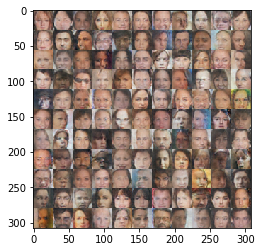

Epoch: 13/16 Discriminator Loss: 0.1988 Generator Loss: 2.6115
Epoch: 13/16 Discriminator Loss: 2.1910 Generator Loss: 0.1696
Epoch: 13/16 Discriminator Loss: 0.2955 Generator Loss: 1.9153
Epoch: 13/16 Discriminator Loss: 0.3579 Generator Loss: 2.9149
Epoch: 13/16 Discriminator Loss: 0.6376 Generator Loss: 3.1580
Epoch: 13/16 Discriminator Loss: 0.8186 Generator Loss: 0.8261
Epoch: 13/16 Discriminator Loss: 0.2091 Generator Loss: 2.9160
Epoch: 13/16 Discriminator Loss: 0.4166 Generator Loss: 1.9264
Epoch: 13/16 Discriminator Loss: 0.1719 Generator Loss: 2.6082
Epoch: 13/16 Discriminator Loss: 0.4224 Generator Loss: 2.2816


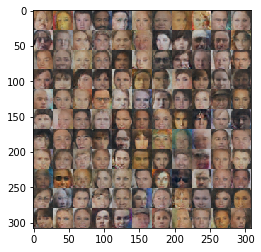

Epoch: 13/16 Discriminator Loss: 0.9518 Generator Loss: 0.9074
Epoch: 13/16 Discriminator Loss: 0.0374 Generator Loss: 6.3638
Epoch: 13/16 Discriminator Loss: 0.1236 Generator Loss: 2.8675
Epoch: 13/16 Discriminator Loss: 1.6840 Generator Loss: 0.3012
Epoch: 13/16 Discriminator Loss: 0.5338 Generator Loss: 1.5117
Epoch: 13/16 Discriminator Loss: 0.2643 Generator Loss: 2.8734
Epoch: 13/16 Discriminator Loss: 0.2778 Generator Loss: 3.1967
Epoch: 13/16 Discriminator Loss: 0.4827 Generator Loss: 1.3079
Epoch: 13/16 Discriminator Loss: 0.2510 Generator Loss: 2.1571
Epoch: 13/16 Discriminator Loss: 0.5114 Generator Loss: 1.2957


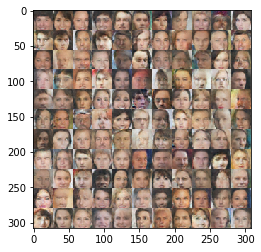

Epoch: 13/16 Discriminator Loss: 0.0569 Generator Loss: 3.8253
Epoch: 13/16 Discriminator Loss: 0.3393 Generator Loss: 2.6546
Epoch: 13/16 Discriminator Loss: 0.3793 Generator Loss: 2.3767
Epoch: 13/16 Discriminator Loss: 0.6314 Generator Loss: 3.9396
Epoch: 13/16 Discriminator Loss: 0.5370 Generator Loss: 1.3379
Epoch: 13/16 Discriminator Loss: 0.3717 Generator Loss: 1.5484
Epoch: 13/16 Discriminator Loss: 0.2656 Generator Loss: 2.0780
Epoch: 13/16 Discriminator Loss: 1.9152 Generator Loss: 0.3035
Epoch: 13/16 Discriminator Loss: 0.0746 Generator Loss: 4.8821
Epoch: 13/16 Discriminator Loss: 0.0905 Generator Loss: 4.7850


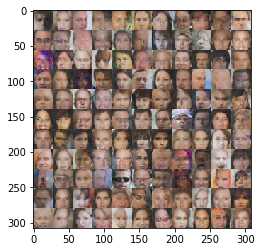

Epoch: 13/16 Discriminator Loss: 0.0326 Generator Loss: 6.2976
Epoch: 13/16 Discriminator Loss: 3.3234 Generator Loss: 0.0696
Epoch: 13/16 Discriminator Loss: 1.2354 Generator Loss: 2.3528
Epoch: 13/16 Discriminator Loss: 1.0244 Generator Loss: 0.8237
Epoch: 13/16 Discriminator Loss: 1.1745 Generator Loss: 0.5491
Epoch: 13/16 Discriminator Loss: 0.5220 Generator Loss: 1.3619
Epoch: 13/16 Discriminator Loss: 0.6137 Generator Loss: 1.1474
Epoch: 13/16 Discriminator Loss: 0.9620 Generator Loss: 0.7328
Epoch: 13/16 Discriminator Loss: 1.1338 Generator Loss: 0.5642
Epoch: 13/16 Discriminator Loss: 0.1446 Generator Loss: 3.5522


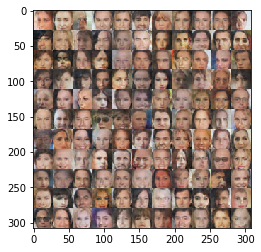

Epoch: 13/16 Discriminator Loss: 1.3288 Generator Loss: 0.4228
Epoch: 13/16 Discriminator Loss: 0.1410 Generator Loss: 3.0881
Epoch: 13/16 Discriminator Loss: 0.2912 Generator Loss: 2.6981
Epoch: 13/16 Discriminator Loss: 0.1545 Generator Loss: 4.8852
Epoch: 13/16 Discriminator Loss: 0.0521 Generator Loss: 5.0045
Epoch: 13/16 Discriminator Loss: 0.0666 Generator Loss: 3.9429
Epoch: 13/16 Discriminator Loss: 0.1911 Generator Loss: 3.1416
Epoch: 13/16 Discriminator Loss: 0.5013 Generator Loss: 1.4825
Epoch: 13/16 Discriminator Loss: 0.1397 Generator Loss: 3.4705
Epoch: 13/16 Discriminator Loss: 0.3428 Generator Loss: 1.5495


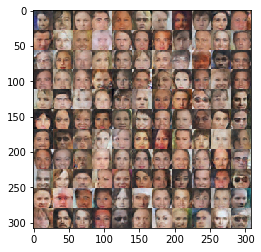

Epoch: 13/16 Discriminator Loss: 1.4889 Generator Loss: 0.3402
Epoch: 13/16 Discriminator Loss: 0.0732 Generator Loss: 5.6629
Epoch: 13/16 Discriminator Loss: 0.4613 Generator Loss: 3.1513
Epoch: 13/16 Discriminator Loss: 0.1092 Generator Loss: 3.6882
Epoch: 13/16 Discriminator Loss: 0.5324 Generator Loss: 1.1883
Epoch: 13/16 Discriminator Loss: 0.0575 Generator Loss: 4.5102
Epoch: 14/16 Discriminator Loss: 0.3340 Generator Loss: 1.8288
Epoch: 14/16 Discriminator Loss: 0.4023 Generator Loss: 1.4952
Epoch: 14/16 Discriminator Loss: 1.2618 Generator Loss: 3.0965
Epoch: 14/16 Discriminator Loss: 0.5219 Generator Loss: 1.7346


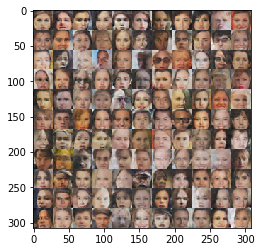

Epoch: 14/16 Discriminator Loss: 0.6625 Generator Loss: 1.0124
Epoch: 14/16 Discriminator Loss: 1.6743 Generator Loss: 0.3532
Epoch: 14/16 Discriminator Loss: 0.6881 Generator Loss: 0.9158
Epoch: 14/16 Discriminator Loss: 0.7019 Generator Loss: 1.6715
Epoch: 14/16 Discriminator Loss: 0.5137 Generator Loss: 1.4743
Epoch: 14/16 Discriminator Loss: 0.4832 Generator Loss: 1.3851
Epoch: 14/16 Discriminator Loss: 0.1039 Generator Loss: 3.4132
Epoch: 14/16 Discriminator Loss: 0.6725 Generator Loss: 1.0503
Epoch: 14/16 Discriminator Loss: 0.7120 Generator Loss: 0.9026
Epoch: 14/16 Discriminator Loss: 0.0851 Generator Loss: 8.8361


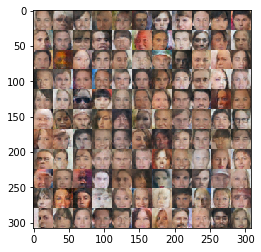

Epoch: 14/16 Discriminator Loss: 0.0603 Generator Loss: 4.8107
Epoch: 14/16 Discriminator Loss: 1.2579 Generator Loss: 0.4648
Epoch: 14/16 Discriminator Loss: 1.8038 Generator Loss: 1.4630
Epoch: 14/16 Discriminator Loss: 0.8276 Generator Loss: 1.2357
Epoch: 14/16 Discriminator Loss: 0.2950 Generator Loss: 2.0212
Epoch: 14/16 Discriminator Loss: 0.4278 Generator Loss: 2.4639
Epoch: 14/16 Discriminator Loss: 0.2014 Generator Loss: 2.6417
Epoch: 14/16 Discriminator Loss: 0.8025 Generator Loss: 1.6019
Epoch: 14/16 Discriminator Loss: 0.5304 Generator Loss: 1.1919
Epoch: 14/16 Discriminator Loss: 0.7220 Generator Loss: 0.8769


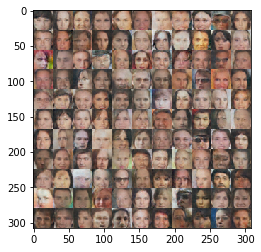

Epoch: 14/16 Discriminator Loss: 0.0946 Generator Loss: 3.4393
Epoch: 14/16 Discriminator Loss: 0.2375 Generator Loss: 2.9185
Epoch: 14/16 Discriminator Loss: 0.0908 Generator Loss: 4.9896
Epoch: 14/16 Discriminator Loss: 1.0212 Generator Loss: 0.6797
Epoch: 14/16 Discriminator Loss: 0.8019 Generator Loss: 0.8412
Epoch: 14/16 Discriminator Loss: 0.9085 Generator Loss: 0.7589
Epoch: 14/16 Discriminator Loss: 0.5959 Generator Loss: 1.2487
Epoch: 14/16 Discriminator Loss: 0.6146 Generator Loss: 1.2933
Epoch: 14/16 Discriminator Loss: 0.5778 Generator Loss: 1.2740
Epoch: 14/16 Discriminator Loss: 0.1683 Generator Loss: 2.9292


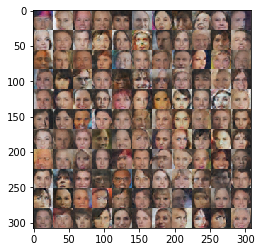

Epoch: 14/16 Discriminator Loss: 0.0651 Generator Loss: 6.5714
Epoch: 14/16 Discriminator Loss: 0.4017 Generator Loss: 1.9103
Epoch: 14/16 Discriminator Loss: 0.2742 Generator Loss: 1.9604
Epoch: 14/16 Discriminator Loss: 0.4228 Generator Loss: 1.3672
Epoch: 14/16 Discriminator Loss: 0.0565 Generator Loss: 5.1891
Epoch: 14/16 Discriminator Loss: 0.7832 Generator Loss: 1.0195
Epoch: 14/16 Discriminator Loss: 0.8154 Generator Loss: 1.5832
Epoch: 14/16 Discriminator Loss: 0.8331 Generator Loss: 2.5094
Epoch: 14/16 Discriminator Loss: 2.2644 Generator Loss: 4.0366
Epoch: 14/16 Discriminator Loss: 1.1294 Generator Loss: 0.6108


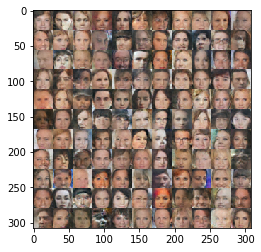

Epoch: 14/16 Discriminator Loss: 0.5176 Generator Loss: 1.6382
Epoch: 14/16 Discriminator Loss: 0.3205 Generator Loss: 1.9353
Epoch: 14/16 Discriminator Loss: 0.1072 Generator Loss: 3.8664
Epoch: 14/16 Discriminator Loss: 0.5587 Generator Loss: 2.5757
Epoch: 14/16 Discriminator Loss: 0.9363 Generator Loss: 0.7562
Epoch: 14/16 Discriminator Loss: 0.3711 Generator Loss: 1.5799
Epoch: 14/16 Discriminator Loss: 0.1872 Generator Loss: 2.5526
Epoch: 14/16 Discriminator Loss: 1.5635 Generator Loss: 2.2965
Epoch: 14/16 Discriminator Loss: 2.0053 Generator Loss: 0.2219
Epoch: 14/16 Discriminator Loss: 0.1860 Generator Loss: 4.0714


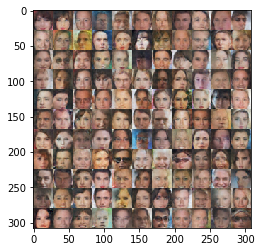

Epoch: 14/16 Discriminator Loss: 0.6089 Generator Loss: 1.1691
Epoch: 14/16 Discriminator Loss: 0.1272 Generator Loss: 3.8073
Epoch: 14/16 Discriminator Loss: 0.2503 Generator Loss: 2.0546
Epoch: 14/16 Discriminator Loss: 0.2441 Generator Loss: 2.0542
Epoch: 14/16 Discriminator Loss: 0.4300 Generator Loss: 1.5572
Epoch: 14/16 Discriminator Loss: 0.3500 Generator Loss: 1.8506
Epoch: 14/16 Discriminator Loss: 0.9085 Generator Loss: 0.7310
Epoch: 14/16 Discriminator Loss: 0.3471 Generator Loss: 1.7382
Epoch: 14/16 Discriminator Loss: 0.5794 Generator Loss: 1.1099
Epoch: 14/16 Discriminator Loss: 0.3336 Generator Loss: 1.6149


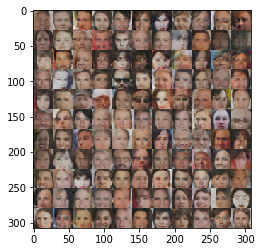

Epoch: 14/16 Discriminator Loss: 0.5153 Generator Loss: 1.2979
Epoch: 14/16 Discriminator Loss: 1.5583 Generator Loss: 0.3227
Epoch: 14/16 Discriminator Loss: 0.6259 Generator Loss: 2.1556
Epoch: 14/16 Discriminator Loss: 0.1951 Generator Loss: 2.5895
Epoch: 14/16 Discriminator Loss: 1.3873 Generator Loss: 4.1296
Epoch: 14/16 Discriminator Loss: 0.7491 Generator Loss: 1.8688
Epoch: 14/16 Discriminator Loss: 0.3061 Generator Loss: 2.1338
Epoch: 14/16 Discriminator Loss: 0.9800 Generator Loss: 0.6672
Epoch: 14/16 Discriminator Loss: 0.2595 Generator Loss: 5.2142
Epoch: 14/16 Discriminator Loss: 0.4108 Generator Loss: 1.7423


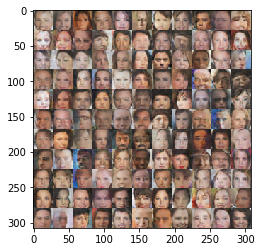

Epoch: 14/16 Discriminator Loss: 0.5091 Generator Loss: 2.2792
Epoch: 14/16 Discriminator Loss: 0.2853 Generator Loss: 1.9115
Epoch: 14/16 Discriminator Loss: 0.0734 Generator Loss: 5.3245
Epoch: 14/16 Discriminator Loss: 0.4378 Generator Loss: 1.4915
Epoch: 14/16 Discriminator Loss: 2.1971 Generator Loss: 0.2556
Epoch: 14/16 Discriminator Loss: 0.6110 Generator Loss: 1.7734
Epoch: 14/16 Discriminator Loss: 0.3981 Generator Loss: 2.8279
Epoch: 14/16 Discriminator Loss: 0.6569 Generator Loss: 1.1900
Epoch: 14/16 Discriminator Loss: 0.1744 Generator Loss: 3.2106
Epoch: 14/16 Discriminator Loss: 0.2367 Generator Loss: 2.3156


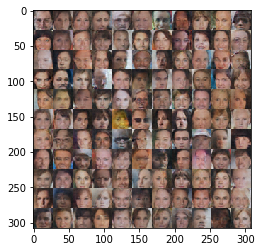

Epoch: 14/16 Discriminator Loss: 1.1306 Generator Loss: 0.5850
Epoch: 14/16 Discriminator Loss: 0.6497 Generator Loss: 1.0407
Epoch: 14/16 Discriminator Loss: 0.3475 Generator Loss: 2.1328
Epoch: 14/16 Discriminator Loss: 0.4157 Generator Loss: 1.4689
Epoch: 14/16 Discriminator Loss: 0.3887 Generator Loss: 1.7993
Epoch: 14/16 Discriminator Loss: 0.0434 Generator Loss: 7.5643
Epoch: 14/16 Discriminator Loss: 0.1201 Generator Loss: 3.1152
Epoch: 14/16 Discriminator Loss: 0.2208 Generator Loss: 4.4222
Epoch: 14/16 Discriminator Loss: 0.2324 Generator Loss: 2.0338
Epoch: 14/16 Discriminator Loss: 0.3088 Generator Loss: 1.7173


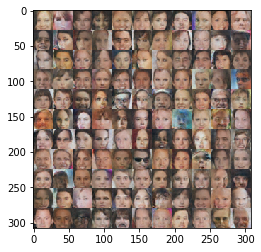

Epoch: 14/16 Discriminator Loss: 0.2764 Generator Loss: 1.9135
Epoch: 14/16 Discriminator Loss: 0.3738 Generator Loss: 6.5300
Epoch: 14/16 Discriminator Loss: 1.3618 Generator Loss: 0.4402
Epoch: 14/16 Discriminator Loss: 0.3057 Generator Loss: 2.9398
Epoch: 14/16 Discriminator Loss: 0.0895 Generator Loss: 3.4656
Epoch: 14/16 Discriminator Loss: 0.4180 Generator Loss: 1.5474
Epoch: 14/16 Discriminator Loss: 1.4585 Generator Loss: 0.3623
Epoch: 14/16 Discriminator Loss: 0.1326 Generator Loss: 3.4090
Epoch: 14/16 Discriminator Loss: 1.3607 Generator Loss: 4.2821
Epoch: 14/16 Discriminator Loss: 0.5888 Generator Loss: 1.1423


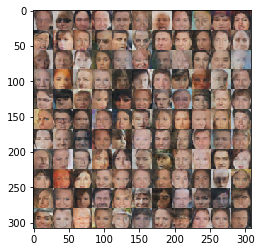

Epoch: 14/16 Discriminator Loss: 0.2629 Generator Loss: 2.5854
Epoch: 14/16 Discriminator Loss: 0.0520 Generator Loss: 8.1762
Epoch: 14/16 Discriminator Loss: 0.1336 Generator Loss: 3.8499
Epoch: 14/16 Discriminator Loss: 0.1649 Generator Loss: 2.7478
Epoch: 14/16 Discriminator Loss: 0.7725 Generator Loss: 0.8614
Epoch: 14/16 Discriminator Loss: 1.1575 Generator Loss: 2.8825
Epoch: 14/16 Discriminator Loss: 0.2805 Generator Loss: 2.0672
Epoch: 14/16 Discriminator Loss: 0.2632 Generator Loss: 3.0603
Epoch: 14/16 Discriminator Loss: 0.5365 Generator Loss: 2.8129
Epoch: 14/16 Discriminator Loss: 0.7321 Generator Loss: 2.5460


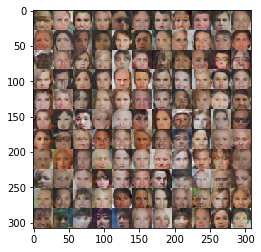

Epoch: 14/16 Discriminator Loss: 0.6997 Generator Loss: 1.0720
Epoch: 14/16 Discriminator Loss: 0.4442 Generator Loss: 1.3887
Epoch: 14/16 Discriminator Loss: 0.6563 Generator Loss: 1.0644
Epoch: 14/16 Discriminator Loss: 0.6585 Generator Loss: 0.9407
Epoch: 14/16 Discriminator Loss: 0.0767 Generator Loss: 4.6115
Epoch: 14/16 Discriminator Loss: 0.7562 Generator Loss: 2.0336
Epoch: 14/16 Discriminator Loss: 0.3653 Generator Loss: 2.2232
Epoch: 14/16 Discriminator Loss: 0.3872 Generator Loss: 1.7087
Epoch: 14/16 Discriminator Loss: 0.1973 Generator Loss: 2.8246
Epoch: 14/16 Discriminator Loss: 0.4354 Generator Loss: 2.5599


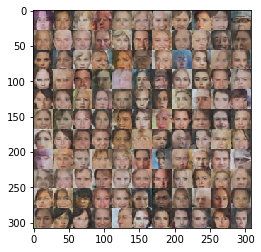

Epoch: 14/16 Discriminator Loss: 0.3099 Generator Loss: 2.3501
Epoch: 14/16 Discriminator Loss: 0.4627 Generator Loss: 1.3284
Epoch: 14/16 Discriminator Loss: 0.9573 Generator Loss: 0.6825
Epoch: 14/16 Discriminator Loss: 0.9314 Generator Loss: 0.9322
Epoch: 14/16 Discriminator Loss: 0.5066 Generator Loss: 1.7179
Epoch: 14/16 Discriminator Loss: 0.2238 Generator Loss: 3.8215
Epoch: 14/16 Discriminator Loss: 0.2523 Generator Loss: 2.0462
Epoch: 14/16 Discriminator Loss: 0.3746 Generator Loss: 2.0723
Epoch: 14/16 Discriminator Loss: 0.1679 Generator Loss: 2.4588
Epoch: 14/16 Discriminator Loss: 0.4276 Generator Loss: 1.4256


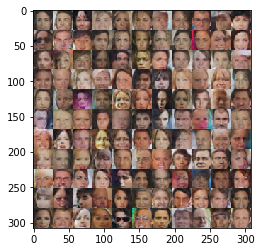

Epoch: 14/16 Discriminator Loss: 0.0559 Generator Loss: 4.6209
Epoch: 14/16 Discriminator Loss: 0.9821 Generator Loss: 0.7160
Epoch: 14/16 Discriminator Loss: 1.6787 Generator Loss: 0.3100
Epoch: 14/16 Discriminator Loss: 0.5850 Generator Loss: 1.2105
Epoch: 14/16 Discriminator Loss: 0.3680 Generator Loss: 1.6800
Epoch: 14/16 Discriminator Loss: 0.1190 Generator Loss: 3.2455
Epoch: 14/16 Discriminator Loss: 0.3073 Generator Loss: 1.7638
Epoch: 14/16 Discriminator Loss: 0.7341 Generator Loss: 0.9592
Epoch: 14/16 Discriminator Loss: 0.0544 Generator Loss: 6.1414
Epoch: 14/16 Discriminator Loss: 0.7583 Generator Loss: 2.9199


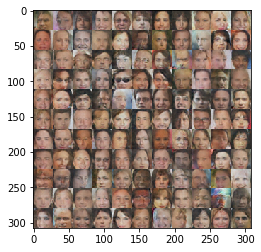

Epoch: 14/16 Discriminator Loss: 0.6159 Generator Loss: 1.1537
Epoch: 14/16 Discriminator Loss: 0.3004 Generator Loss: 2.2760
Epoch: 14/16 Discriminator Loss: 0.4309 Generator Loss: 4.0265
Epoch: 14/16 Discriminator Loss: 0.5769 Generator Loss: 1.5037
Epoch: 14/16 Discriminator Loss: 0.2731 Generator Loss: 2.7070
Epoch: 14/16 Discriminator Loss: 0.5172 Generator Loss: 1.3069
Epoch: 14/16 Discriminator Loss: 0.0841 Generator Loss: 3.5240
Epoch: 14/16 Discriminator Loss: 0.3019 Generator Loss: 2.9442
Epoch: 14/16 Discriminator Loss: 0.4674 Generator Loss: 1.4522
Epoch: 14/16 Discriminator Loss: 0.8552 Generator Loss: 0.7986


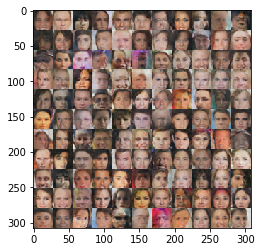

Epoch: 14/16 Discriminator Loss: 0.1096 Generator Loss: 2.8996
Epoch: 14/16 Discriminator Loss: 1.8903 Generator Loss: 0.2606
Epoch: 14/16 Discriminator Loss: 1.6093 Generator Loss: 0.4258
Epoch: 14/16 Discriminator Loss: 0.3745 Generator Loss: 1.7992
Epoch: 15/16 Discriminator Loss: 0.4246 Generator Loss: 1.4027
Epoch: 15/16 Discriminator Loss: 0.6110 Generator Loss: 1.0624
Epoch: 15/16 Discriminator Loss: 0.6385 Generator Loss: 1.1256
Epoch: 15/16 Discriminator Loss: 0.7107 Generator Loss: 4.1282
Epoch: 15/16 Discriminator Loss: 0.9083 Generator Loss: 0.7631
Epoch: 15/16 Discriminator Loss: 0.6032 Generator Loss: 1.7205


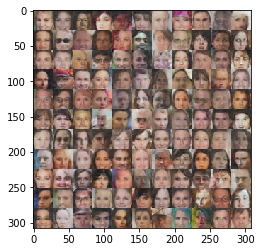

Epoch: 15/16 Discriminator Loss: 0.6666 Generator Loss: 6.0585
Epoch: 15/16 Discriminator Loss: 0.4632 Generator Loss: 1.4534
Epoch: 15/16 Discriminator Loss: 0.9007 Generator Loss: 0.7685
Epoch: 15/16 Discriminator Loss: 0.7741 Generator Loss: 0.9749
Epoch: 15/16 Discriminator Loss: 0.5687 Generator Loss: 2.4954
Epoch: 15/16 Discriminator Loss: 0.0705 Generator Loss: 4.4253
Epoch: 15/16 Discriminator Loss: 1.2838 Generator Loss: 0.4649
Epoch: 15/16 Discriminator Loss: 0.3010 Generator Loss: 2.1864
Epoch: 15/16 Discriminator Loss: 0.8003 Generator Loss: 1.0902
Epoch: 15/16 Discriminator Loss: 0.3382 Generator Loss: 1.9379


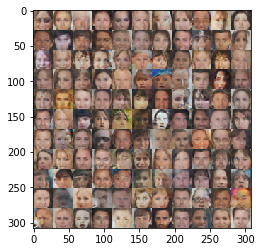

Epoch: 15/16 Discriminator Loss: 0.2372 Generator Loss: 2.9857
Epoch: 15/16 Discriminator Loss: 0.1054 Generator Loss: 3.3026
Epoch: 15/16 Discriminator Loss: 0.1795 Generator Loss: 3.0368
Epoch: 15/16 Discriminator Loss: 0.5761 Generator Loss: 1.2234
Epoch: 15/16 Discriminator Loss: 1.1597 Generator Loss: 0.5445
Epoch: 15/16 Discriminator Loss: 0.8642 Generator Loss: 0.8146
Epoch: 15/16 Discriminator Loss: 0.4853 Generator Loss: 2.7636
Epoch: 15/16 Discriminator Loss: 0.5880 Generator Loss: 1.1823
Epoch: 15/16 Discriminator Loss: 1.2111 Generator Loss: 0.5282
Epoch: 15/16 Discriminator Loss: 0.2091 Generator Loss: 3.8264


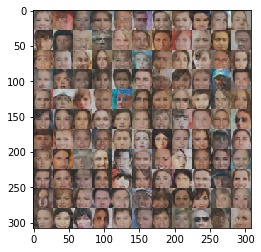

Epoch: 15/16 Discriminator Loss: 0.8405 Generator Loss: 0.7589
Epoch: 15/16 Discriminator Loss: 0.2706 Generator Loss: 2.0920
Epoch: 15/16 Discriminator Loss: 0.1369 Generator Loss: 3.0131
Epoch: 15/16 Discriminator Loss: 0.4662 Generator Loss: 1.3374
Epoch: 15/16 Discriminator Loss: 0.0940 Generator Loss: 5.9726
Epoch: 15/16 Discriminator Loss: 0.4365 Generator Loss: 1.5780
Epoch: 15/16 Discriminator Loss: 0.0275 Generator Loss: 7.8221
Epoch: 15/16 Discriminator Loss: 1.6376 Generator Loss: 2.8478
Epoch: 15/16 Discriminator Loss: 0.0686 Generator Loss: 5.3109
Epoch: 15/16 Discriminator Loss: 0.6734 Generator Loss: 0.9729


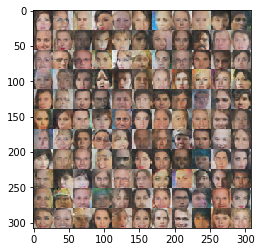

Epoch: 15/16 Discriminator Loss: 0.9075 Generator Loss: 0.7685
Epoch: 15/16 Discriminator Loss: 0.4571 Generator Loss: 1.2919
Epoch: 15/16 Discriminator Loss: 0.1462 Generator Loss: 3.1777
Epoch: 15/16 Discriminator Loss: 1.0328 Generator Loss: 0.6318
Epoch: 15/16 Discriminator Loss: 0.3061 Generator Loss: 2.7671
Epoch: 15/16 Discriminator Loss: 0.1597 Generator Loss: 4.4280
Epoch: 15/16 Discriminator Loss: 2.0816 Generator Loss: 0.2245
Epoch: 15/16 Discriminator Loss: 0.6637 Generator Loss: 1.1234
Epoch: 15/16 Discriminator Loss: 0.1308 Generator Loss: 4.8422
Epoch: 15/16 Discriminator Loss: 1.0250 Generator Loss: 0.6495


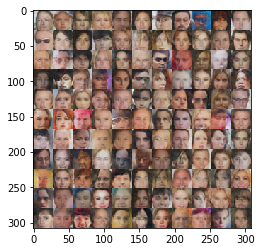

Epoch: 15/16 Discriminator Loss: 0.3304 Generator Loss: 1.6526
Epoch: 15/16 Discriminator Loss: 0.4020 Generator Loss: 4.4579
Epoch: 15/16 Discriminator Loss: 0.2462 Generator Loss: 2.3789
Epoch: 15/16 Discriminator Loss: 1.2825 Generator Loss: 0.4925
Epoch: 15/16 Discriminator Loss: 1.0384 Generator Loss: 0.6244
Epoch: 15/16 Discriminator Loss: 1.1653 Generator Loss: 0.4950
Epoch: 15/16 Discriminator Loss: 0.2919 Generator Loss: 1.9535
Epoch: 15/16 Discriminator Loss: 0.8042 Generator Loss: 0.9329
Epoch: 15/16 Discriminator Loss: 0.2020 Generator Loss: 2.2952
Epoch: 15/16 Discriminator Loss: 0.7526 Generator Loss: 0.9937


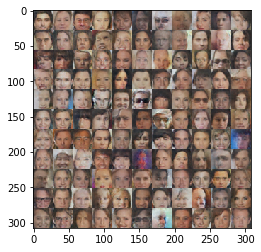

Epoch: 15/16 Discriminator Loss: 0.2025 Generator Loss: 2.6723
Epoch: 15/16 Discriminator Loss: 0.4321 Generator Loss: 2.2170
Epoch: 15/16 Discriminator Loss: 0.1929 Generator Loss: 2.7347
Epoch: 15/16 Discriminator Loss: 0.0738 Generator Loss: 5.4146
Epoch: 15/16 Discriminator Loss: 0.2583 Generator Loss: 2.2767
Epoch: 15/16 Discriminator Loss: 0.8702 Generator Loss: 0.8333
Epoch: 15/16 Discriminator Loss: 0.3991 Generator Loss: 1.6186
Epoch: 15/16 Discriminator Loss: 0.1037 Generator Loss: 3.5959
Epoch: 15/16 Discriminator Loss: 1.1273 Generator Loss: 2.5282
Epoch: 15/16 Discriminator Loss: 0.6415 Generator Loss: 1.4802


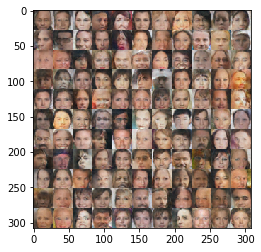

Epoch: 15/16 Discriminator Loss: 0.7838 Generator Loss: 2.1753
Epoch: 15/16 Discriminator Loss: 0.2870 Generator Loss: 2.4553
Epoch: 15/16 Discriminator Loss: 0.5936 Generator Loss: 1.1593
Epoch: 15/16 Discriminator Loss: 0.6041 Generator Loss: 2.3459
Epoch: 15/16 Discriminator Loss: 0.5652 Generator Loss: 1.3588
Epoch: 15/16 Discriminator Loss: 0.2043 Generator Loss: 5.5691
Epoch: 15/16 Discriminator Loss: 0.0689 Generator Loss: 6.1303
Epoch: 15/16 Discriminator Loss: 0.7292 Generator Loss: 1.0132
Epoch: 15/16 Discriminator Loss: 0.5895 Generator Loss: 2.1168
Epoch: 15/16 Discriminator Loss: 0.4001 Generator Loss: 1.7451


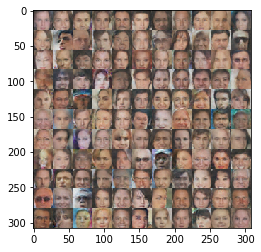

Epoch: 15/16 Discriminator Loss: 0.3400 Generator Loss: 1.6831
Epoch: 15/16 Discriminator Loss: 0.1875 Generator Loss: 2.5123
Epoch: 15/16 Discriminator Loss: 0.1659 Generator Loss: 2.7382
Epoch: 15/16 Discriminator Loss: 0.2945 Generator Loss: 1.8269
Epoch: 15/16 Discriminator Loss: 1.1687 Generator Loss: 3.4383
Epoch: 15/16 Discriminator Loss: 1.7540 Generator Loss: 0.3263
Epoch: 15/16 Discriminator Loss: 0.6609 Generator Loss: 1.4704
Epoch: 15/16 Discriminator Loss: 0.3245 Generator Loss: 2.0098
Epoch: 15/16 Discriminator Loss: 0.2201 Generator Loss: 2.4947
Epoch: 15/16 Discriminator Loss: 0.8943 Generator Loss: 0.8164


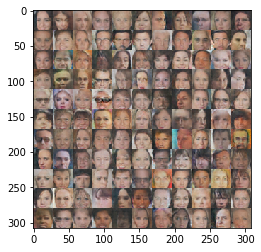

Epoch: 15/16 Discriminator Loss: 0.9193 Generator Loss: 0.8203
Epoch: 15/16 Discriminator Loss: 0.3409 Generator Loss: 1.7623
Epoch: 15/16 Discriminator Loss: 0.2607 Generator Loss: 2.6557
Epoch: 15/16 Discriminator Loss: 0.8984 Generator Loss: 0.8880
Epoch: 15/16 Discriminator Loss: 0.5084 Generator Loss: 1.3758
Epoch: 15/16 Discriminator Loss: 0.4514 Generator Loss: 1.3606
Epoch: 15/16 Discriminator Loss: 0.2113 Generator Loss: 2.2208
Epoch: 15/16 Discriminator Loss: 0.8680 Generator Loss: 0.8049
Epoch: 15/16 Discriminator Loss: 1.5149 Generator Loss: 0.4400
Epoch: 15/16 Discriminator Loss: 0.5051 Generator Loss: 2.1850


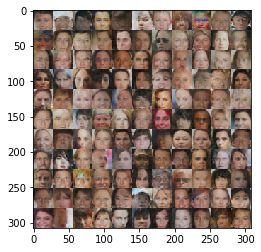

Epoch: 15/16 Discriminator Loss: 1.1561 Generator Loss: 0.5587
Epoch: 15/16 Discriminator Loss: 0.7039 Generator Loss: 1.1406
Epoch: 15/16 Discriminator Loss: 0.7177 Generator Loss: 0.9662
Epoch: 15/16 Discriminator Loss: 0.6390 Generator Loss: 1.1121
Epoch: 15/16 Discriminator Loss: 2.1382 Generator Loss: 0.1896
Epoch: 15/16 Discriminator Loss: 1.4040 Generator Loss: 0.4040
Epoch: 15/16 Discriminator Loss: 0.3499 Generator Loss: 2.0858
Epoch: 15/16 Discriminator Loss: 0.5279 Generator Loss: 1.4247
Epoch: 15/16 Discriminator Loss: 0.2954 Generator Loss: 2.1639
Epoch: 15/16 Discriminator Loss: 0.3897 Generator Loss: 2.3552


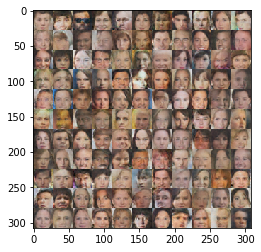

Epoch: 15/16 Discriminator Loss: 0.3003 Generator Loss: 1.9358
Epoch: 15/16 Discriminator Loss: 0.7589 Generator Loss: 0.8814
Epoch: 15/16 Discriminator Loss: 0.0689 Generator Loss: 6.3238
Epoch: 15/16 Discriminator Loss: 0.4339 Generator Loss: 3.8861
Epoch: 15/16 Discriminator Loss: 0.5888 Generator Loss: 2.4479
Epoch: 15/16 Discriminator Loss: 0.1257 Generator Loss: 3.2526
Epoch: 15/16 Discriminator Loss: 0.2495 Generator Loss: 2.0171
Epoch: 15/16 Discriminator Loss: 0.7702 Generator Loss: 1.6198
Epoch: 15/16 Discriminator Loss: 1.0377 Generator Loss: 0.6556
Epoch: 15/16 Discriminator Loss: 0.6762 Generator Loss: 1.7243


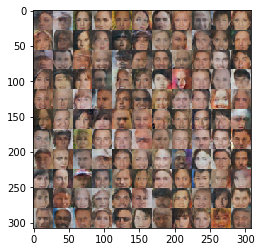

Epoch: 15/16 Discriminator Loss: 0.6849 Generator Loss: 2.0712
Epoch: 15/16 Discriminator Loss: 0.3722 Generator Loss: 1.7465
Epoch: 15/16 Discriminator Loss: 1.4119 Generator Loss: 0.4933
Epoch: 15/16 Discriminator Loss: 0.1782 Generator Loss: 2.8917
Epoch: 15/16 Discriminator Loss: 0.7503 Generator Loss: 3.4145
Epoch: 15/16 Discriminator Loss: 1.4917 Generator Loss: 3.5605
Epoch: 15/16 Discriminator Loss: 0.8387 Generator Loss: 4.2206
Epoch: 15/16 Discriminator Loss: 0.0879 Generator Loss: 5.6520
Epoch: 15/16 Discriminator Loss: 0.4248 Generator Loss: 1.4585
Epoch: 15/16 Discriminator Loss: 0.1107 Generator Loss: 4.0293


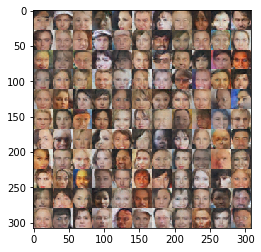

Epoch: 15/16 Discriminator Loss: 0.6511 Generator Loss: 0.9995
Epoch: 15/16 Discriminator Loss: 0.9552 Generator Loss: 0.8653
Epoch: 15/16 Discriminator Loss: 0.1628 Generator Loss: 3.1531
Epoch: 15/16 Discriminator Loss: 1.2372 Generator Loss: 0.5067
Epoch: 15/16 Discriminator Loss: 0.8919 Generator Loss: 2.2284
Epoch: 15/16 Discriminator Loss: 1.3617 Generator Loss: 0.4658
Epoch: 15/16 Discriminator Loss: 0.2272 Generator Loss: 2.1863
Epoch: 15/16 Discriminator Loss: 0.3404 Generator Loss: 1.8737
Epoch: 15/16 Discriminator Loss: 0.3548 Generator Loss: 2.4510
Epoch: 15/16 Discriminator Loss: 0.8201 Generator Loss: 1.1931


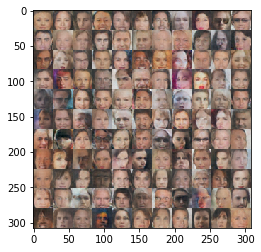

Epoch: 15/16 Discriminator Loss: 0.2375 Generator Loss: 3.8219
Epoch: 15/16 Discriminator Loss: 0.1526 Generator Loss: 2.8797
Epoch: 15/16 Discriminator Loss: 0.5609 Generator Loss: 1.2064
Epoch: 15/16 Discriminator Loss: 0.2778 Generator Loss: 1.9795
Epoch: 15/16 Discriminator Loss: 2.0840 Generator Loss: 4.4253
Epoch: 15/16 Discriminator Loss: 0.5731 Generator Loss: 1.3104
Epoch: 15/16 Discriminator Loss: 0.0885 Generator Loss: 4.0588
Epoch: 15/16 Discriminator Loss: 0.8167 Generator Loss: 0.8741
Epoch: 15/16 Discriminator Loss: 1.0194 Generator Loss: 0.7877
Epoch: 15/16 Discriminator Loss: 0.4036 Generator Loss: 4.0395


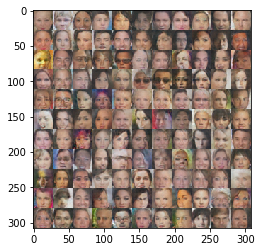

Epoch: 15/16 Discriminator Loss: 1.3596 Generator Loss: 3.1146
Epoch: 15/16 Discriminator Loss: 0.3449 Generator Loss: 2.1580
Epoch: 15/16 Discriminator Loss: 0.1641 Generator Loss: 3.1114
Epoch: 15/16 Discriminator Loss: 0.9273 Generator Loss: 0.7294
Epoch: 15/16 Discriminator Loss: 0.8131 Generator Loss: 1.2043
Epoch: 15/16 Discriminator Loss: 0.2502 Generator Loss: 2.2991
Epoch: 15/16 Discriminator Loss: 0.7167 Generator Loss: 1.0089
Epoch: 15/16 Discriminator Loss: 0.1439 Generator Loss: 5.4375
Epoch: 15/16 Discriminator Loss: 0.3596 Generator Loss: 1.8432
Epoch: 15/16 Discriminator Loss: 0.8641 Generator Loss: 1.1961


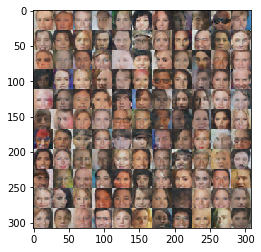

Epoch: 15/16 Discriminator Loss: 0.3755 Generator Loss: 1.6885
Epoch: 15/16 Discriminator Loss: 0.4232 Generator Loss: 1.6356
Epoch: 15/16 Discriminator Loss: 1.8100 Generator Loss: 0.3108
Epoch: 16/16 Discriminator Loss: 0.9790 Generator Loss: 0.7828
Epoch: 16/16 Discriminator Loss: 1.0835 Generator Loss: 0.6414
Epoch: 16/16 Discriminator Loss: 0.1829 Generator Loss: 3.6777
Epoch: 16/16 Discriminator Loss: 0.5107 Generator Loss: 1.7557
Epoch: 16/16 Discriminator Loss: 0.3376 Generator Loss: 3.2533
Epoch: 16/16 Discriminator Loss: 0.6386 Generator Loss: 0.9739
Epoch: 16/16 Discriminator Loss: 0.3683 Generator Loss: 1.6357


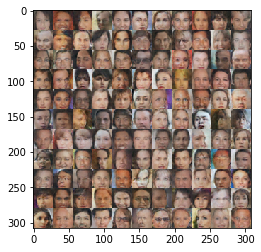

Epoch: 16/16 Discriminator Loss: 0.7096 Generator Loss: 1.0834
Epoch: 16/16 Discriminator Loss: 0.7692 Generator Loss: 0.8192
Epoch: 16/16 Discriminator Loss: 0.5489 Generator Loss: 1.2071
Epoch: 16/16 Discriminator Loss: 0.1254 Generator Loss: 4.2519
Epoch: 16/16 Discriminator Loss: 0.7305 Generator Loss: 0.9054
Epoch: 16/16 Discriminator Loss: 0.3850 Generator Loss: 1.6223
Epoch: 16/16 Discriminator Loss: 0.2765 Generator Loss: 2.0589
Epoch: 16/16 Discriminator Loss: 0.0780 Generator Loss: 6.2907
Epoch: 16/16 Discriminator Loss: 1.4082 Generator Loss: 0.3935
Epoch: 16/16 Discriminator Loss: 0.1787 Generator Loss: 2.8480


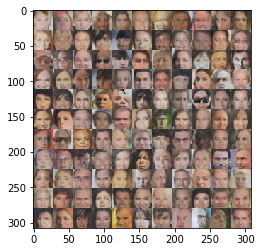

Epoch: 16/16 Discriminator Loss: 0.0685 Generator Loss: 5.5502
Epoch: 16/16 Discriminator Loss: 0.4369 Generator Loss: 1.6347
Epoch: 16/16 Discriminator Loss: 0.5499 Generator Loss: 1.4972
Epoch: 16/16 Discriminator Loss: 0.1502 Generator Loss: 3.3211
Epoch: 16/16 Discriminator Loss: 0.2956 Generator Loss: 1.8445
Epoch: 16/16 Discriminator Loss: 0.1938 Generator Loss: 2.3436
Epoch: 16/16 Discriminator Loss: 2.2419 Generator Loss: 0.1809
Epoch: 16/16 Discriminator Loss: 0.7330 Generator Loss: 1.0305
Epoch: 16/16 Discriminator Loss: 0.5041 Generator Loss: 1.8245
Epoch: 16/16 Discriminator Loss: 0.6256 Generator Loss: 2.7650


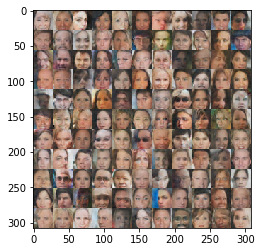

Epoch: 16/16 Discriminator Loss: 0.4797 Generator Loss: 1.6672
Epoch: 16/16 Discriminator Loss: 0.2610 Generator Loss: 3.9144
Epoch: 16/16 Discriminator Loss: 0.1479 Generator Loss: 2.8580
Epoch: 16/16 Discriminator Loss: 0.4278 Generator Loss: 1.5444
Epoch: 16/16 Discriminator Loss: 0.3562 Generator Loss: 2.0709
Epoch: 16/16 Discriminator Loss: 0.5230 Generator Loss: 1.4262
Epoch: 16/16 Discriminator Loss: 0.8020 Generator Loss: 1.7548
Epoch: 16/16 Discriminator Loss: 0.3834 Generator Loss: 1.9147
Epoch: 16/16 Discriminator Loss: 0.4162 Generator Loss: 1.4909
Epoch: 16/16 Discriminator Loss: 0.1778 Generator Loss: 5.2116


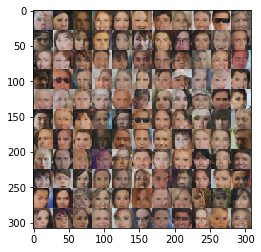

Epoch: 16/16 Discriminator Loss: 0.7958 Generator Loss: 1.1062
Epoch: 16/16 Discriminator Loss: 0.2057 Generator Loss: 3.1956
Epoch: 16/16 Discriminator Loss: 0.2127 Generator Loss: 2.3004
Epoch: 16/16 Discriminator Loss: 0.1757 Generator Loss: 3.4589
Epoch: 16/16 Discriminator Loss: 0.0547 Generator Loss: 5.4837
Epoch: 16/16 Discriminator Loss: 0.1839 Generator Loss: 2.4457
Epoch: 16/16 Discriminator Loss: 0.8439 Generator Loss: 1.6109
Epoch: 16/16 Discriminator Loss: 0.5470 Generator Loss: 1.7481
Epoch: 16/16 Discriminator Loss: 0.2343 Generator Loss: 4.2741
Epoch: 16/16 Discriminator Loss: 0.2072 Generator Loss: 2.7096


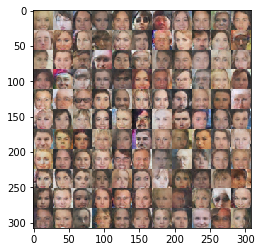

Epoch: 16/16 Discriminator Loss: 0.3593 Generator Loss: 2.8779
Epoch: 16/16 Discriminator Loss: 0.3792 Generator Loss: 1.6953
Epoch: 16/16 Discriminator Loss: 1.8818 Generator Loss: 4.5842
Epoch: 16/16 Discriminator Loss: 0.9793 Generator Loss: 3.4599
Epoch: 16/16 Discriminator Loss: 2.7169 Generator Loss: 4.1003
Epoch: 16/16 Discriminator Loss: 1.0840 Generator Loss: 0.7184
Epoch: 16/16 Discriminator Loss: 0.1485 Generator Loss: 3.8960
Epoch: 16/16 Discriminator Loss: 0.5984 Generator Loss: 1.2295
Epoch: 16/16 Discriminator Loss: 0.6476 Generator Loss: 1.1104
Epoch: 16/16 Discriminator Loss: 0.9881 Generator Loss: 0.7175


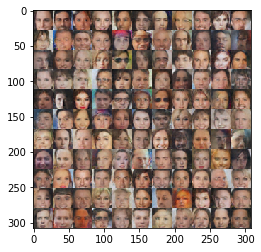

Epoch: 16/16 Discriminator Loss: 0.9627 Generator Loss: 0.6701
Epoch: 16/16 Discriminator Loss: 0.3880 Generator Loss: 1.6756
Epoch: 16/16 Discriminator Loss: 1.0975 Generator Loss: 0.5761
Epoch: 16/16 Discriminator Loss: 0.9560 Generator Loss: 0.7556
Epoch: 16/16 Discriminator Loss: 0.7038 Generator Loss: 0.9537
Epoch: 16/16 Discriminator Loss: 0.3860 Generator Loss: 2.0537
Epoch: 16/16 Discriminator Loss: 0.3412 Generator Loss: 3.5882
Epoch: 16/16 Discriminator Loss: 0.5572 Generator Loss: 1.3297
Epoch: 16/16 Discriminator Loss: 0.3689 Generator Loss: 1.7033
Epoch: 16/16 Discriminator Loss: 1.3628 Generator Loss: 0.4157


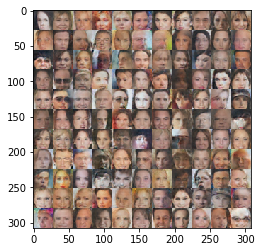

Epoch: 16/16 Discriminator Loss: 0.3278 Generator Loss: 1.9154
Epoch: 16/16 Discriminator Loss: 0.6596 Generator Loss: 1.1966
Epoch: 16/16 Discriminator Loss: 0.7825 Generator Loss: 1.0474
Epoch: 16/16 Discriminator Loss: 0.4124 Generator Loss: 1.6490
Epoch: 16/16 Discriminator Loss: 0.5335 Generator Loss: 1.3304
Epoch: 16/16 Discriminator Loss: 0.3249 Generator Loss: 1.9570
Epoch: 16/16 Discriminator Loss: 0.6342 Generator Loss: 1.0563
Epoch: 16/16 Discriminator Loss: 0.5992 Generator Loss: 1.3050
Epoch: 16/16 Discriminator Loss: 0.3057 Generator Loss: 2.1514
Epoch: 16/16 Discriminator Loss: 0.2528 Generator Loss: 2.5343


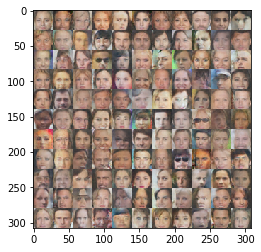

Epoch: 16/16 Discriminator Loss: 0.1714 Generator Loss: 2.8419
Epoch: 16/16 Discriminator Loss: 0.8766 Generator Loss: 0.7685
Epoch: 16/16 Discriminator Loss: 1.0216 Generator Loss: 0.7992
Epoch: 16/16 Discriminator Loss: 0.4368 Generator Loss: 1.3788
Epoch: 16/16 Discriminator Loss: 0.9484 Generator Loss: 0.7275
Epoch: 16/16 Discriminator Loss: 0.3566 Generator Loss: 1.8997
Epoch: 16/16 Discriminator Loss: 0.8739 Generator Loss: 4.1165
Epoch: 16/16 Discriminator Loss: 0.7850 Generator Loss: 3.3841
Epoch: 16/16 Discriminator Loss: 0.2860 Generator Loss: 2.3104
Epoch: 16/16 Discriminator Loss: 0.1682 Generator Loss: 3.7272


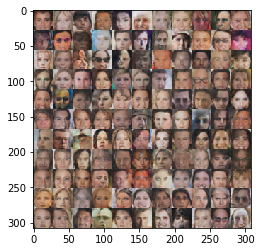

Epoch: 16/16 Discriminator Loss: 0.2570 Generator Loss: 2.2612
Epoch: 16/16 Discriminator Loss: 1.4475 Generator Loss: 0.4426
Epoch: 16/16 Discriminator Loss: 1.3342 Generator Loss: 0.4338
Epoch: 16/16 Discriminator Loss: 0.3031 Generator Loss: 1.9502
Epoch: 16/16 Discriminator Loss: 0.3348 Generator Loss: 1.7397
Epoch: 16/16 Discriminator Loss: 0.1867 Generator Loss: 2.4400
Epoch: 16/16 Discriminator Loss: 0.8471 Generator Loss: 0.8753
Epoch: 16/16 Discriminator Loss: 0.8041 Generator Loss: 0.8725
Epoch: 16/16 Discriminator Loss: 0.7621 Generator Loss: 1.4065
Epoch: 16/16 Discriminator Loss: 0.6844 Generator Loss: 0.9729


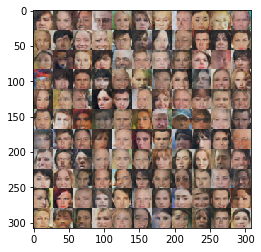

Epoch: 16/16 Discriminator Loss: 0.4597 Generator Loss: 2.5796
Epoch: 16/16 Discriminator Loss: 0.5755 Generator Loss: 1.3526
Epoch: 16/16 Discriminator Loss: 0.8005 Generator Loss: 0.8618
Epoch: 16/16 Discriminator Loss: 2.4059 Generator Loss: 4.3066
Epoch: 16/16 Discriminator Loss: 0.5442 Generator Loss: 1.3019
Epoch: 16/16 Discriminator Loss: 1.2682 Generator Loss: 3.7161
Epoch: 16/16 Discriminator Loss: 1.9664 Generator Loss: 0.2726
Epoch: 16/16 Discriminator Loss: 0.9583 Generator Loss: 0.7465
Epoch: 16/16 Discriminator Loss: 1.9222 Generator Loss: 3.2256
Epoch: 16/16 Discriminator Loss: 0.7459 Generator Loss: 0.9268


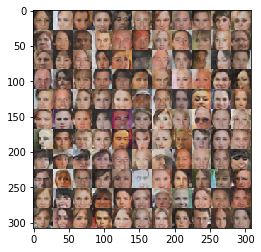

Epoch: 16/16 Discriminator Loss: 0.8626 Generator Loss: 1.0116
Epoch: 16/16 Discriminator Loss: 0.9417 Generator Loss: 0.6605
Epoch: 16/16 Discriminator Loss: 0.7930 Generator Loss: 1.0549
Epoch: 16/16 Discriminator Loss: 0.6244 Generator Loss: 1.1820
Epoch: 16/16 Discriminator Loss: 0.4888 Generator Loss: 1.3425
Epoch: 16/16 Discriminator Loss: 0.9161 Generator Loss: 0.8502
Epoch: 16/16 Discriminator Loss: 0.1958 Generator Loss: 2.7603
Epoch: 16/16 Discriminator Loss: 1.0762 Generator Loss: 0.6169
Epoch: 16/16 Discriminator Loss: 0.1904 Generator Loss: 2.8543
Epoch: 16/16 Discriminator Loss: 0.6914 Generator Loss: 0.9970


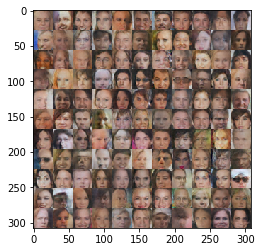

Epoch: 16/16 Discriminator Loss: 0.3816 Generator Loss: 3.3617
Epoch: 16/16 Discriminator Loss: 0.4430 Generator Loss: 1.3703
Epoch: 16/16 Discriminator Loss: 0.5511 Generator Loss: 1.1785
Epoch: 16/16 Discriminator Loss: 0.7738 Generator Loss: 0.8588
Epoch: 16/16 Discriminator Loss: 0.6313 Generator Loss: 1.3321
Epoch: 16/16 Discriminator Loss: 1.5330 Generator Loss: 0.3374
Epoch: 16/16 Discriminator Loss: 1.1542 Generator Loss: 2.8047
Epoch: 16/16 Discriminator Loss: 0.6473 Generator Loss: 1.1254
Epoch: 16/16 Discriminator Loss: 1.6306 Generator Loss: 0.3105
Epoch: 16/16 Discriminator Loss: 0.5174 Generator Loss: 1.4262


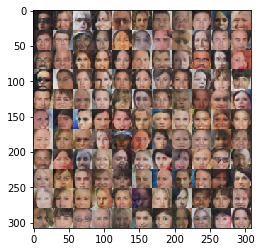

Epoch: 16/16 Discriminator Loss: 0.4123 Generator Loss: 1.9088
Epoch: 16/16 Discriminator Loss: 0.1898 Generator Loss: 3.0627
Epoch: 16/16 Discriminator Loss: 0.5809 Generator Loss: 1.7844
Epoch: 16/16 Discriminator Loss: 1.1007 Generator Loss: 0.6439
Epoch: 16/16 Discriminator Loss: 1.1360 Generator Loss: 0.5683
Epoch: 16/16 Discriminator Loss: 0.3827 Generator Loss: 1.6554
Epoch: 16/16 Discriminator Loss: 0.7207 Generator Loss: 0.9632
Epoch: 16/16 Discriminator Loss: 0.2780 Generator Loss: 3.0848
Epoch: 16/16 Discriminator Loss: 0.5041 Generator Loss: 1.9103
Epoch: 16/16 Discriminator Loss: 0.2833 Generator Loss: 1.8820


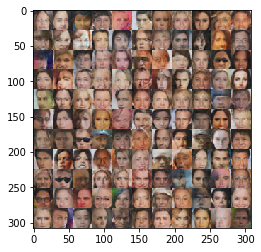

Epoch: 16/16 Discriminator Loss: 0.4605 Generator Loss: 1.5370
Epoch: 16/16 Discriminator Loss: 0.3560 Generator Loss: 2.0647
Epoch: 16/16 Discriminator Loss: 0.1456 Generator Loss: 3.0551
Epoch: 16/16 Discriminator Loss: 0.4592 Generator Loss: 3.9418
Epoch: 16/16 Discriminator Loss: 0.4289 Generator Loss: 1.4637
Epoch: 16/16 Discriminator Loss: 0.6520 Generator Loss: 2.6558
Epoch: 16/16 Discriminator Loss: 0.1317 Generator Loss: 3.6217
Epoch: 16/16 Discriminator Loss: 1.1149 Generator Loss: 0.5699
Epoch: 16/16 Discriminator Loss: 0.6964 Generator Loss: 1.0306
Epoch: 16/16 Discriminator Loss: 0.8837 Generator Loss: 0.7592


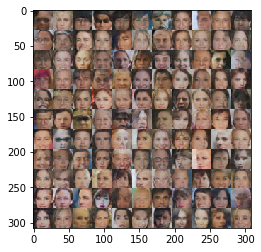

Epoch: 16/16 Discriminator Loss: 0.3814 Generator Loss: 1.6128
Epoch: 16/16 Discriminator Loss: 1.0501 Generator Loss: 0.5971
Epoch: 16/16 Discriminator Loss: 0.4958 Generator Loss: 1.6976
Epoch: 16/16 Discriminator Loss: 1.0450 Generator Loss: 0.6501
Epoch: 16/16 Discriminator Loss: 0.3944 Generator Loss: 1.7228
Epoch: 16/16 Discriminator Loss: 0.4509 Generator Loss: 1.3654
Epoch: 16/16 Discriminator Loss: 0.4239 Generator Loss: 1.8905
Epoch: 16/16 Discriminator Loss: 0.4658 Generator Loss: 2.0339
Epoch: 16/16 Discriminator Loss: 0.1390 Generator Loss: 4.3370
Epoch: 16/16 Discriminator Loss: 0.4685 Generator Loss: 1.8873


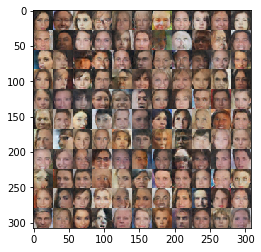

Epoch: 16/16 Discriminator Loss: 0.4558 Generator Loss: 1.8757


In [15]:
batch_size = 128
z_dim = 100
learning_rate = 0.0002
beta1 = 0.5


"""
DON'T MODIFY ANYTHING IN THIS CELL THAT IS BELOW THIS LINE
"""
epochs = 16

celeba_dataset = helper.Dataset('celeba', glob(os.path.join(data_dir, 'img_align_celeba/*.jpg')))
with tf.Graph().as_default():
    train(epochs, batch_size, z_dim, learning_rate, beta1, celeba_dataset.get_batches,
          celeba_dataset.shape, celeba_dataset.image_mode)

### 提交项目
提交本项目前，确保运行所有 cells 后保存该文件。

保存该文件为 "dlnd_face_generation.ipynb"， 并另存为 HTML 格式 "File" -> "Download as"。提交项目时请附带 "helper.py" 和 "problem_unittests.py" 文件。